In [2]:
#================================================= IMPORTS =============================================
import numpy as np 
import pandas as pd 
import os
import numpy as np
import math
import sys
import time

import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.autograd as autograd

import torchvision.transforms as transforms
from torchvision.utils import save_image
from torch.utils.data import DataLoader
from torch.utils.data import Dataset
from torchvision.utils import make_grid
from tqdm import tqdm

import matplotlib.pyplot as plt

from torchmetrics.image.inception import InceptionScore
from torchmetrics.image.fid import FrechetInceptionDistance
from PIL import Image



/opt/conda/lib/python3.10/site-packages/scipy/__init__.py:146: UserWarning: A NumPy version >=1.16.5 and <1.23.0 is required for this version of SciPy (detected version 1.24.3
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"


In [ ]:
inn = 4
k = 4
s = 1
p = 0

op = 0

print('conv', (inn - k + 2*p)//s + 1)

print('T conv', (inn-1)*s-2*p+(k-1)+op+1)

In [15]:
#============================================== Conditional Deep Convolutional Wasserstein GAN ========================================
class cWGAN_Generator(nn.Module):
    def __init__(self, latent_dim, num_labels):
        super().__init__()
        self.linear_projection = nn.Linear(latent_dim+num_labels, 4*4*512)
        self.layers = nn.Sequential(
            nn.ConvTranspose2d(512, 512, kernel_size=3, stride=2, padding=1, output_padding=1), #8*8
            nn.BatchNorm2d(512),
            nn.ReLU(),
            nn.ConvTranspose2d(512, 256, kernel_size=3, stride=2, padding=1, output_padding=1), #16*16
            nn.BatchNorm2d(256),
            nn.ReLU(),
            nn.ConvTranspose2d(256, 128, kernel_size=3, stride=2, padding=1, output_padding=1), #32*32
            nn.BatchNorm2d(128),
            nn.ReLU(),
            nn.ConvTranspose2d(128, 3, kernel_size=3, stride=2, padding=1, output_padding=1), #64*64
            nn.Tanh()
            )
    def forward(self, x, labels):
        x = torch.cat((x, labels), dim=1)
        x = self.linear_projection(x)
        x = x.reshape(-1, 512, 4, 4)
        x = self.layers(x)
        return x
    
class cWGAN_Critic(nn.Module):
    def __init__(self, num_labels):
        super().__init__()
        self.num_labels = num_labels
        self.layers = nn.Sequential(
            nn.Conv2d(3+num_labels, 64, kernel_size=3, stride=2, padding=1), #32*32
            nn.LeakyReLU(0.2),
            nn.Conv2d(64, 128, kernel_size=3, stride=2, padding=1), #16*16
            nn.LeakyReLU(0.2),
            nn.Conv2d(128, 256, kernel_size=3, stride=2, padding=1), #8*8
            nn.LeakyReLU(0.2),
            nn.Conv2d(256, 512, kernel_size=3, stride=2, padding=1), #8*8
            nn.LeakyReLU(0.2),
            nn.Conv2d(512, 1024, kernel_size=3, stride=2, padding=1), #4*4
            nn.LeakyReLU(0.2),
            nn.Conv2d(1024, 1, kernel_size=2, stride=1, padding=0), #1*1,
            )
        
    def forward(self, x, labels):
        bs = labels.size(dim=0)
        y = labels.reshape(-1, self.num_labels, 1, 1)
        x = torch.cat((x, y* (torch.ones(size=(bs, 1, 64, 64)).to("cuda:0"))), dim = 1)
        x = self.layers(x)
        return x 

In [ ]:
test_csv = pd.read_csv('/kaggle/input/celeba-dataset/list_attr_celeba.csv')[0:2]
test_csv.shape[0]

In [ ]:
a = [1,2,3,4,5,6]
b = [1 if el < 4 else 0 for el in a]
torch.tensor(b)

In [4]:
# ======================================== Dataset and Dataloader ===================================
root_dir = '/kaggle/input/celeba-dataset/'
img_prefix = 'img_align_celeba/img_align_celeba/'
csv_name = 'list_attr_celeba.csv'

image_size = 64
data_transform = transforms.Compose(
    [
        transforms.Resize(image_size),
        transforms.CenterCrop(image_size),
        transforms.ToTensor(),
        transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
    ]
)

class CelebA_Dataset(Dataset):
    def __init__(self,
                 labels,
                 root_dir = root_dir,
                 csv_name = csv_name, 
                 img_prefix = img_prefix, 
                 is_train = True, 
                 transform = data_transform):
        self.root_dir = root_dir
        self.img_prefix = img_prefix
        self.labels = labels
        if is_train:
            self.csv = pd.read_csv(root_dir+csv_name)[0:182637]
        else:
            self.csv = pd.read_csv(root_dir+csv_name)[182637:]
        self.transform = transform

    def __len__(self):
        return self.csv.shape[0]

    def __getitem__(self, index):
        img_name = self.csv.iloc[index]['image_id']
        labels = [1 if self.csv.iloc[index][label] == 1 else 0 for label in self.labels]
        image = Image.open(self.root_dir + self.img_prefix + img_name).convert('RGB')
        image_tensor = self.transform(image)
        image.close()
        return image_tensor, torch.tensor(labels)

In [5]:
labels = ['Bald', 'Bangs', 'Black_Hair', 'Blond_Hair', 'Eyeglasses', 'Heavy_Makeup', 'Male', 'Pale_Skin', 'Smiling'] 

In [6]:
train_CelebA = CelebA_Dataset(labels)
test_CelebA = CelebA_Dataset(labels, is_train=False)

dataloaders = dict()
dataloaders['train'] = DataLoader(train_CelebA,
                                  batch_size=64,
                                  shuffle=True,
                                  num_workers=2,
                                  pin_memory=True,
                                  drop_last=True)
dataloaders['test'] = DataLoader(test_CelebA,
                                 batch_size=64,
                                 shuffle=True,
                                 num_workers=2,
                                 pin_memory=True)

In [7]:
#xxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxx DEVICE xxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxx
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
print(device)

cuda:0


In [8]:
# =========================================  Gradient penalty =====================================
def compute_gradient_penalty(Critic, real_samples, fake_samples, labels, device):
    # Random weight term for interpolation between real and fake samples
    epsilon = torch.tensor(np.random.random((real_samples.size(0), 1, 1, 1)), dtype=torch.float32).to(device)
    # Get random interpolation between real and fake samples
    x_hat = (epsilon * real_samples + ((1 - epsilon) * fake_samples)).requires_grad_(True)
    score_xhat = Critic(x_hat, labels)
    fake = torch.ones(size=(real_samples.shape[0],1, 1, 1), dtype=torch.float32).to(device)
    fake.requires_grad = False
    # Get gradient w.r.t. interpolates
    gradients = autograd.grad(
        outputs=score_xhat,
        inputs=x_hat,
        grad_outputs=fake,
        create_graph=True,
        retain_graph=True,
        only_inputs=True,
    )
    gradients = gradients[0].view(gradients[0].size(0), -1)
    gradient_penalty = ((gradients.norm(2, dim=1) - 1) ** 2).mean()
    return gradient_penalty

In [16]:
def show_tensor_images(image_tensor, num_images=16, size=(3, 64, 64), nrow=3, outdir=None, epoch=1):
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=nrow)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    plt.show()
    if not outdir is None:
        plt.savefig(f'{outdir}results_for_epoch_{epoch}')
    plt.close()

In [ ]:
imgs_dist1 = torch.randint(0, 200, (32, 3, 64, 64), dtype=torch.uint8).to(device)
show_tensor_images(imgs_dist1, num_images=16, size=(3, 64, 64), nrow=3, outdir=None, epoch=1)

In [10]:
def plot_epoch_stats(metrics, epoch_inf, m_name, out_dir = None):
    mets = list(metrics.keys())
    
    fig, axs = plt.subplots(4)
    fig.suptitle(f'Metrics for epoch {epoch_inf[0]}/{epoch_inf[1]+1} ||{m_name}||')
    for idx, m in enumerate(mets):
        axs[idx].plot(range(1, epoch_inf[0]+1), metrics[m], label=f'{m}')
        axs[idx].set(xlabel='epochs', ylabel=f'{m}')
        #axs[idx].set_title(f'{m}')
        axs[idx].legend(loc="center right")
    fig.set_figheight(10)
    fig.set_figwidth(10)
    plt.subplots_adjust(hspace=0.4)
    plt.show()
    if not out_dir is None:
        plt.savefig(f'{out_dir}stats_for_epoch_{epoch_inf[0]}')
        
    plt.close('all')

In [11]:
def train_GAN(generator, 
              critic,
              latent_dims,
              gp_coeff,
              optim_G, 
              optim_C, 
              dataloader,
              device,
              n_epochs=100, 
              n_critic=5, 
              prev_metrics=None, 
              save_every=None, 
              fig_dir=None, 
              w_dir=None):
    #===============
    #Previous metrics
    metrics = ['FID', 'IS', 'W_Score_G', 'W_Dist_C']
    start_epoch = 1
    if prev_metrics is None:
        saved_metrics = {metric: list() for metric in metrics}
    else:
        saved_metrics = prev_metrics
        start_epoch = len(saved_metrics['FID'])+1
        
    IS = InceptionScore(normalize=True)
    FID = FrechetInceptionDistance(feature=64, normalize=True)
    
    print("="*100)
    print(f"Starting GAN training with params:")
    print(f'Generator net: {generator.name}')
    print(f"Generator otimizer: {optim_G}")
    print(f'Critic net: {critic.name}')
    print(f"Critic otimizer: {optim_C}")
    print(f"Criterion: Critic Score & Wasserstein distance + Gradient penalty")
    
    epoch_cnt = 0
    # +++++++++++++++++++++++++++ Epoch
    for epoch in range(start_epoch, start_epoch+n_epochs):
        start_time = time.time()
        
        mean_W_Score_G = 0
        mean_W_Dist_C = 0
        mean_FID = 0
        mean_IS = 0
        
        cur_tqdm = tqdm(dataloader['train'])
        batch_cnt = 0
        gen_cnt = 0
        # +++++++++++++++ Batches
        for imgs, labels in cur_tqdm:
            bs = imgs.shape[0]
            batch_cnt += 1
            
            imgs = imgs.to(device)
            labels = labels.to(device)
            
            # xxxxxxxxx Train Critic
            optim_C.zero_grad()
            
            z = torch.tensor(np.random.normal(0, 1, (imgs.shape[0], latent_dims)), dtype=torch.float32).to(device)
            gen_imgs = generator(z, labels)
            
            real_score = critic(imgs, labels)
            gen_score = critic(gen_imgs, labels)
            
            #========= Wasserstein distance + GP
            gradient_penalty = compute_gradient_penalty(critic, imgs, gen_imgs, labels, device)
            Wasserstein_distance = -torch.mean(real_score) + torch.mean(gen_score) + gp_coeff * gradient_penalty
            mean_W_Dist_C += Wasserstein_distance.item()
            Wasserstein_distance.backward()
            optim_C.step()
            
            #xxxxxxxxx Train Generator every n_critic steps
            optim_G.zero_grad()
            
            if batch_cnt % n_critic == 0:
                # === Generate imgs
                gen_imgs = generator(z, labels)
                # === Score
                gen_score = critic(gen_imgs, labels)
                # === Add to mean
                W_Score_G = -torch.mean(gen_score)
                mean_W_Score_G += W_Score_G.item()
                W_Score_G.backward()
                optim_G.step()
                gen_cnt += 1
            #xxxxxxxxxx
        
        end_time = time.time()
        epoch_time = end_time - start_time
        mean_W_Score_G = mean_W_Score_G / gen_cnt
        saved_metrics['W_Score_G'].append(mean_W_Score_G)
        mean_W_Dist_C =  mean_W_Dist_C / batch_cnt
        saved_metrics['W_Dist_C'].append(mean_W_Dist_C)
        
        imgs, labels = next(iter(dataloader['test']))
        imgs = imgs[:16].to(device)
        labels = labels[:16].to(device)
        z = torch.tensor(np.random.normal(0, 1, (16, latent_dims)), dtype=torch.float32).to(device)
        with torch.no_grad():
            gen_imgs = generator(z, labels)
        # === FID
        FID.update(imgs.detach().cpu(), real=True)
        FID.update(gen_imgs.detach().cpu(), real=False)
        fid = FID.compute()
        mean_FID = torch.mean(fid)
        # === IS
        IS.update(gen_imgs.detach().cpu())
        iss = IS.compute()
        #print(iss)
        mean_IS = iss[0].item()
        
        saved_metrics['FID'].append(mean_FID)
        saved_metrics['IS'].append(mean_IS)
        show_tensor_images(gen_imgs, num_images=16, size=(3, 64, 64), nrow=4, outdir=fig_dir, epoch=epoch)
        
        print("-" * 10)
        print(f"Mean Generator Score: {mean_W_Score_G}")
        print(f"Mean Critic distance: {mean_W_Dist_C}")
        print(f"Mean FID (64): {mean_FID}")
        print(f"Mean IS: {mean_IS}")
        print(f"Epoch Time: {math.floor(epoch_time // 60)}:{math.floor(epoch_time % 60):02d}")
        
        if epoch > 1:
            plot_epoch_stats(saved_metrics, [epoch, start_epoch+n_epochs-1], f'{generator.name}+{critic.name}', fig_dir)
        
        if not (save_every and w_dir) is None:
            if (epoch_cnt % save_every == 0):
                torch.save(generator.state_dict(), f"{w_dir}generator.pth")
                torch.save(critic.state_dict(), f"{w_dir}critic.pth")
                
        
    print("*** Training Completed ***")
    return saved_metrics
        
        
    

In [12]:
if not os.path.isdir("/kaggle/working/logs/"):
    os.mkdir("/kaggle/working/logs/")
    
if not os.path.isdir("/kaggle/working/logs/figures/"):
    os.mkdir("/kaggle/working/logs/figures/")
    
if not os.path.isdir("/kaggle/working/logs/weights/"):
    os.mkdir("/kaggle/working/logs/weights/")
             
fig_dir = '/kaggle/working/logs/figures/'
w_dir = '/kaggle/working/logs/weights/'

In [17]:
"""class cWGAN_Generetor(nn.Module):
    def __init__(self, latent_dim, num_lables):
        
class cWGAN_Critic(nn.Module):
    def __init__(self, num_labels):
"""
Generator = cWGAN_Generator(100, len(labels)).to(device)
Generator.name = 'cDCWGAN_Generator'
Critic = cWGAN_Critic(len(labels)).to(device)
Critic.name = 'cDCWGAN_Critic'

optimizer_G = torch.optim.Adam(Generator.parameters(), lr=2e-4, betas=(0.5, 0.999))
optimizer_C = torch.optim.Adam(Critic.parameters(), lr=2e-4, betas=(0.5, 0.999))



In [1]:
!pip install torch-fidelity

Starting GAN training with params:
Generator net: cDCWGAN_Generator
Generator otimizer: Adam (
Parameter Group 0
    amsgrad: False
    betas: (0.5, 0.999)
    capturable: False
    differentiable: False
    eps: 1e-08
    foreach: None
    fused: None
    lr: 0.0002
    maximize: False
    weight_decay: 0
)
Critic net: cDCWGAN_Critic
Critic otimizer: Adam (
Parameter Group 0
    amsgrad: False
    betas: (0.5, 0.999)
    capturable: False
    differentiable: False
    eps: 1e-08
    foreach: None
    fused: None
    lr: 0.0002
    maximize: False
    weight_decay: 0
)
Criterion: Critic Score & Wasserstein distance + Gradient penalty


100%|██████████| 2853/2853 [09:15<00:00,  5.14it/s]


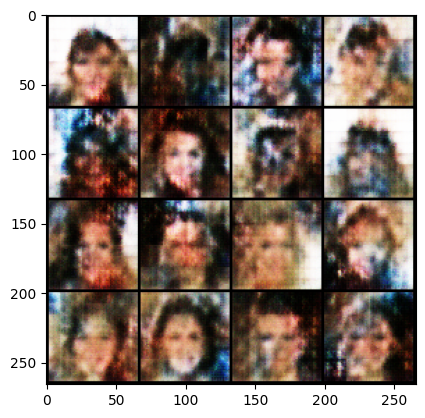

----------
Mean Generator Score: 1307.4864485040046
Mean Critic distance: -293.4990527746377
Mean FID (64): 11.1443452835083
Mean IS: 1.4659790992736816
Epoch Time: 9:15


100%|██████████| 2853/2853 [07:49<00:00,  6.07it/s]


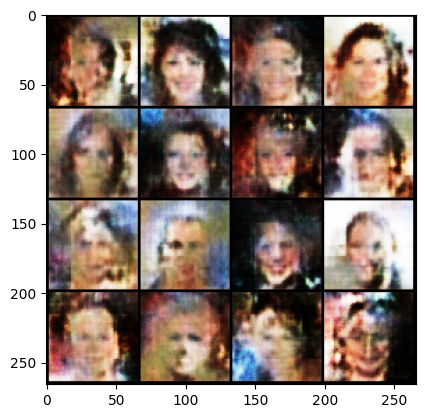

----------
Mean Generator Score: 41.61843339978603
Mean Critic distance: -38.404376166684976
Mean FID (64): 8.160676002502441
Mean IS: 1.6217982769012451
Epoch Time: 7:49


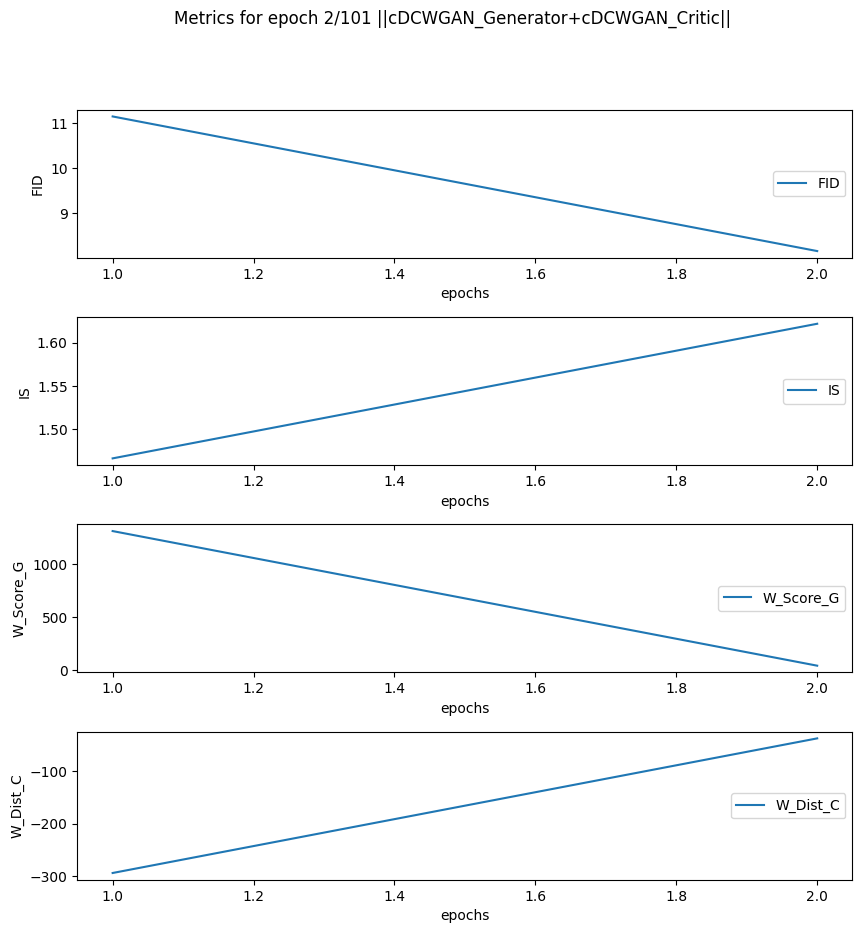

100%|██████████| 2853/2853 [07:49<00:00,  6.07it/s]


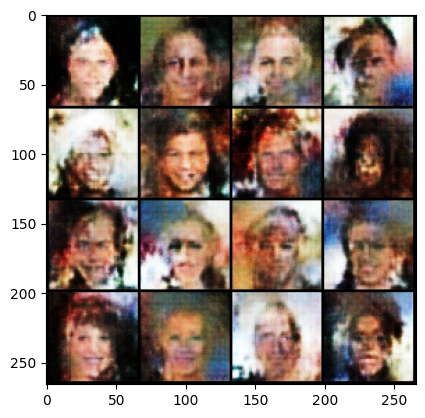

----------
Mean Generator Score: 3.8795579140646415
Mean Critic distance: -28.570673194802353
Mean FID (64): 6.633484840393066
Mean IS: 1.7523510456085205
Epoch Time: 7:49


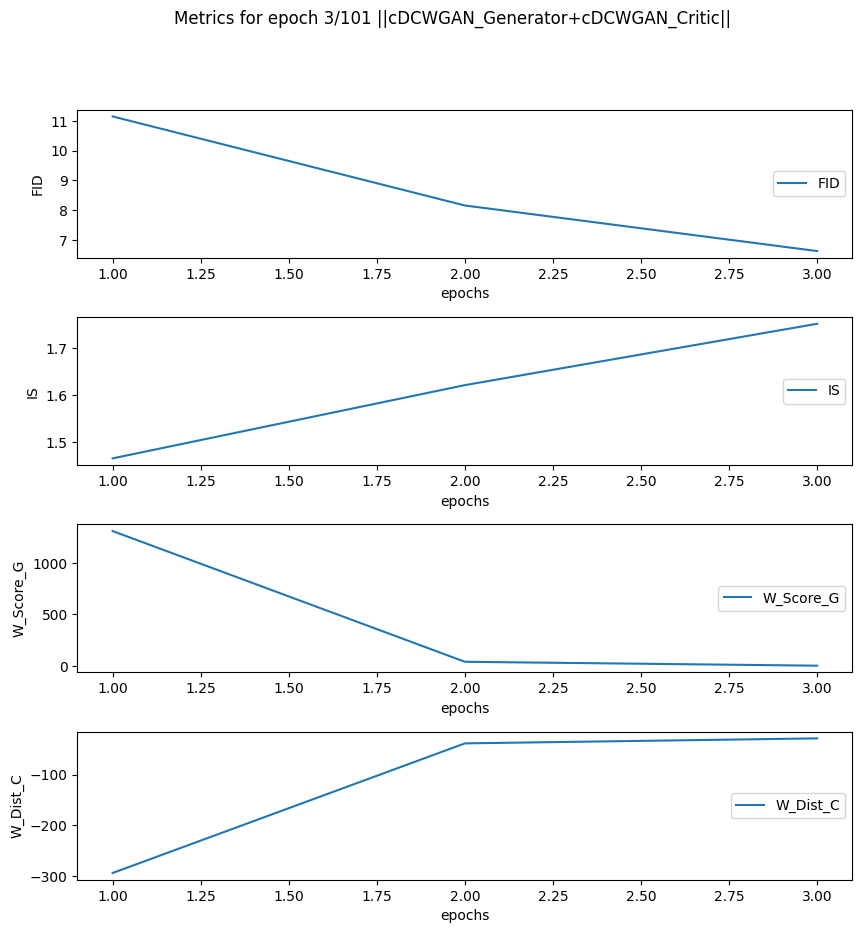

100%|██████████| 2853/2853 [07:50<00:00,  6.07it/s]


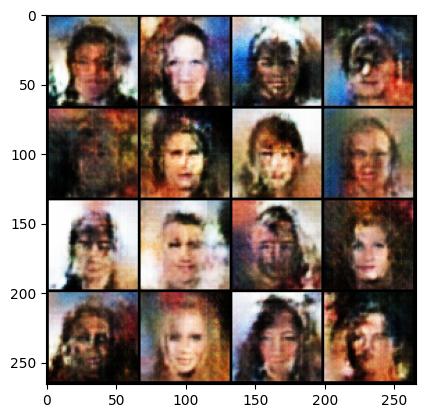

----------
Mean Generator Score: -87.19457398799427
Mean Critic distance: -24.204907942102366
Mean FID (64): 5.97519588470459
Mean IS: 1.8247177600860596
Epoch Time: 7:50


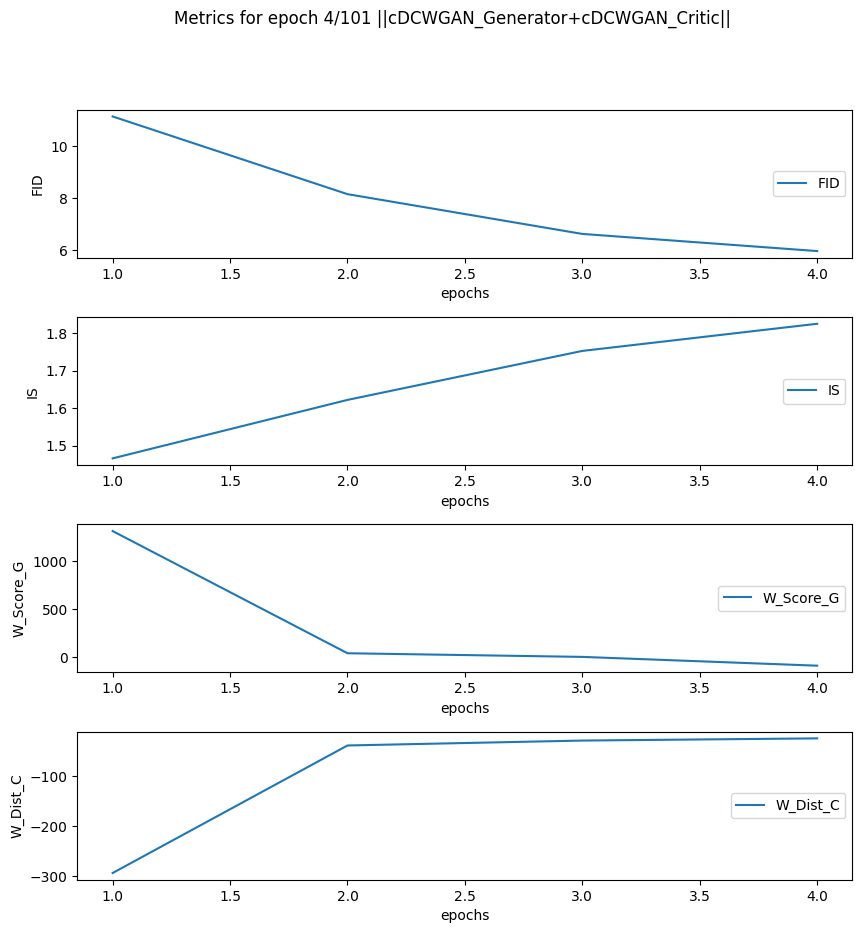

100%|██████████| 2853/2853 [07:50<00:00,  6.07it/s]


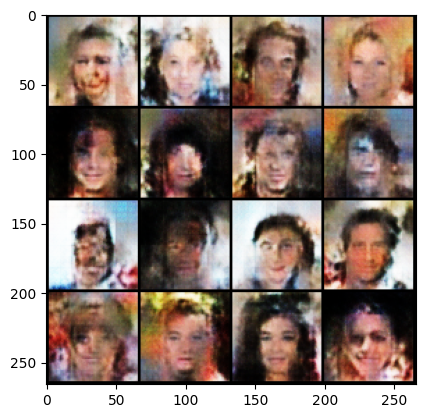

----------
Mean Generator Score: -164.75387086993769
Mean Critic distance: -17.4031410424533
Mean FID (64): 5.516943454742432
Mean IS: 1.911047339439392
Epoch Time: 7:50


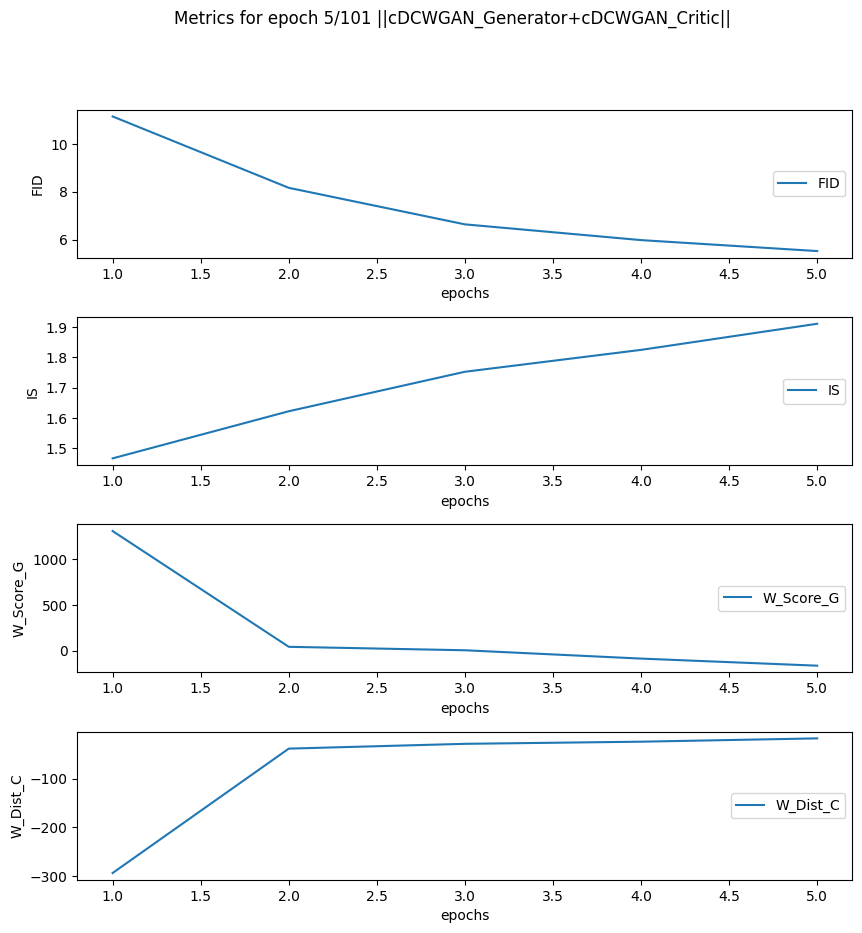

100%|██████████| 2853/2853 [07:50<00:00,  6.07it/s]


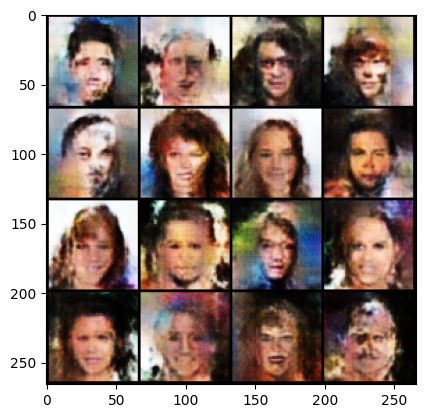

----------
Mean Generator Score: -184.10488846260205
Mean Critic distance: -14.512003809704598
Mean FID (64): 4.986499309539795
Mean IS: 1.9627180099487305
Epoch Time: 7:50


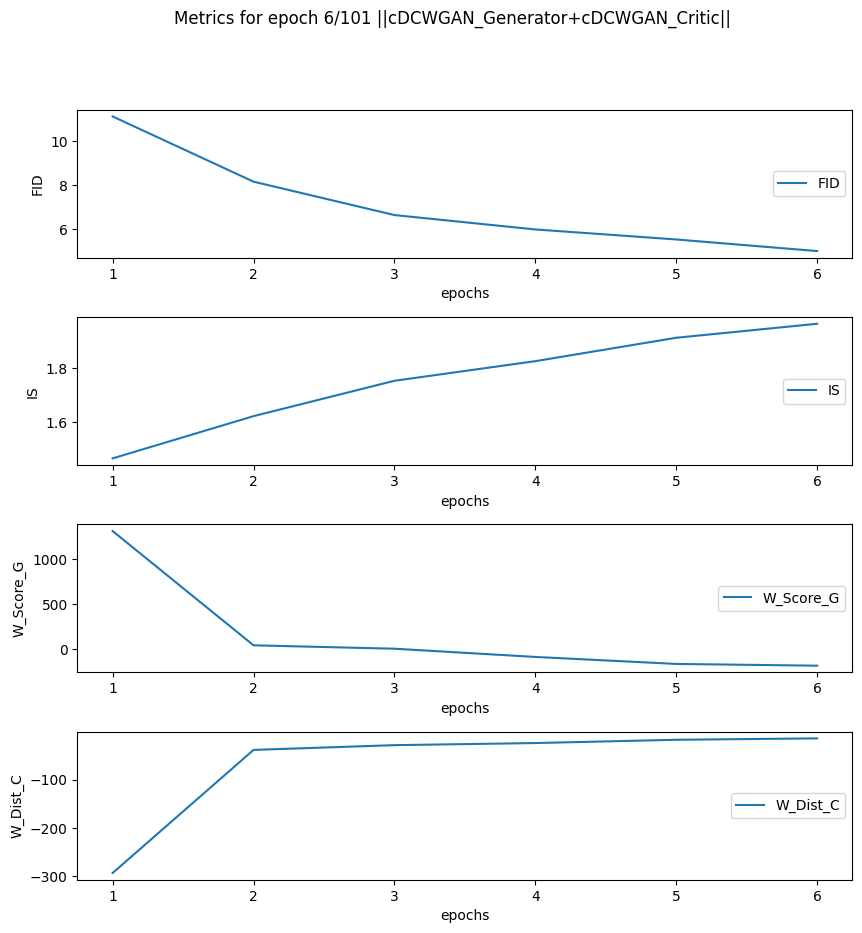

100%|██████████| 2853/2853 [07:50<00:00,  6.07it/s]


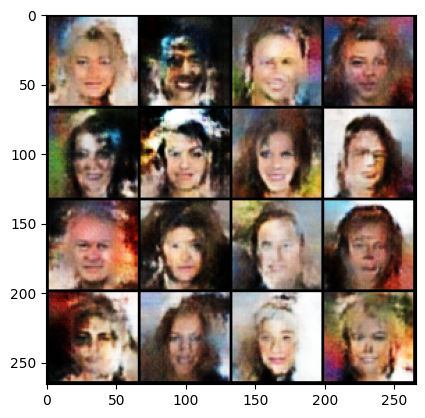

----------
Mean Generator Score: -194.40923661913789
Mean Critic distance: -13.13952456613695
Mean FID (64): 4.449122428894043
Mean IS: 2.0822720527648926
Epoch Time: 7:50


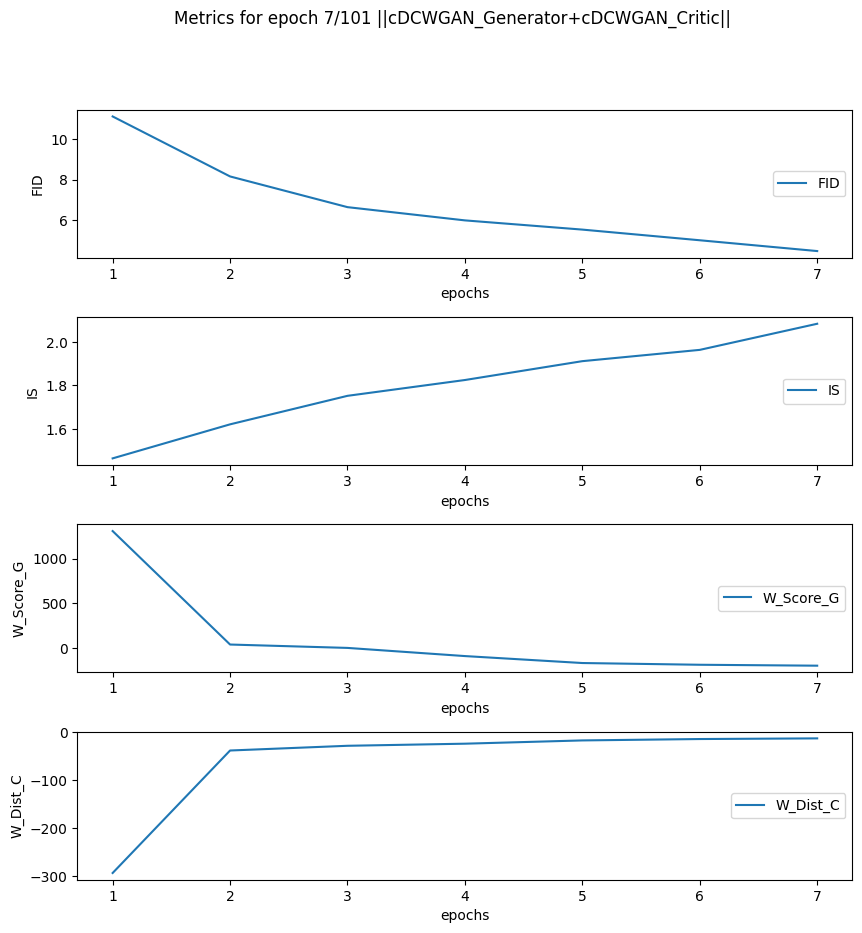

100%|██████████| 2853/2853 [07:50<00:00,  6.07it/s]


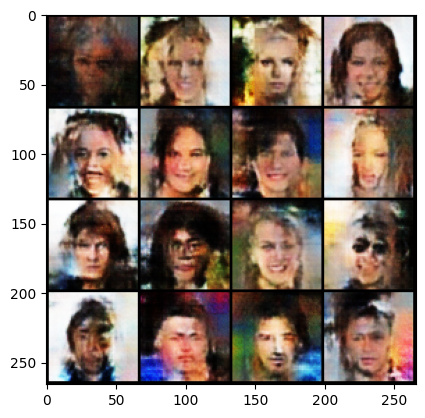

----------
Mean Generator Score: -208.0418428573692
Mean Critic distance: -12.190457497652565
Mean FID (64): 3.998231887817383
Mean IS: 2.2028281688690186
Epoch Time: 7:50


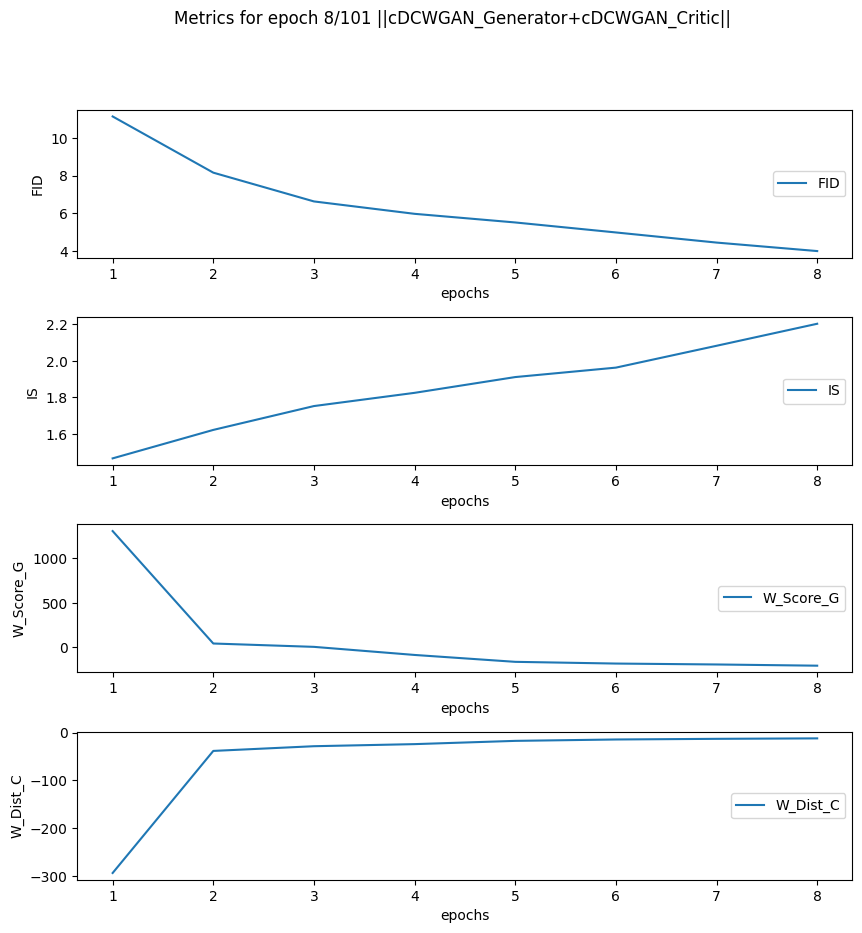

100%|██████████| 2853/2853 [07:50<00:00,  6.07it/s]


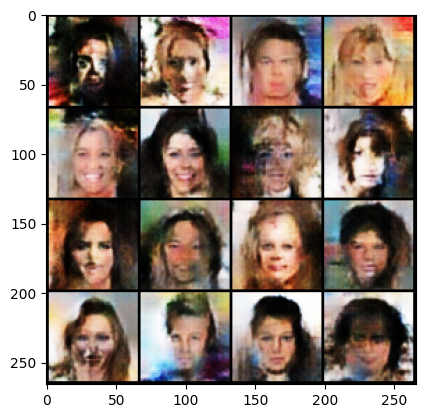

----------
Mean Generator Score: -163.72413624085877
Mean Critic distance: -11.49794251643855
Mean FID (64): 3.7902843952178955
Mean IS: 2.2594730854034424
Epoch Time: 7:50


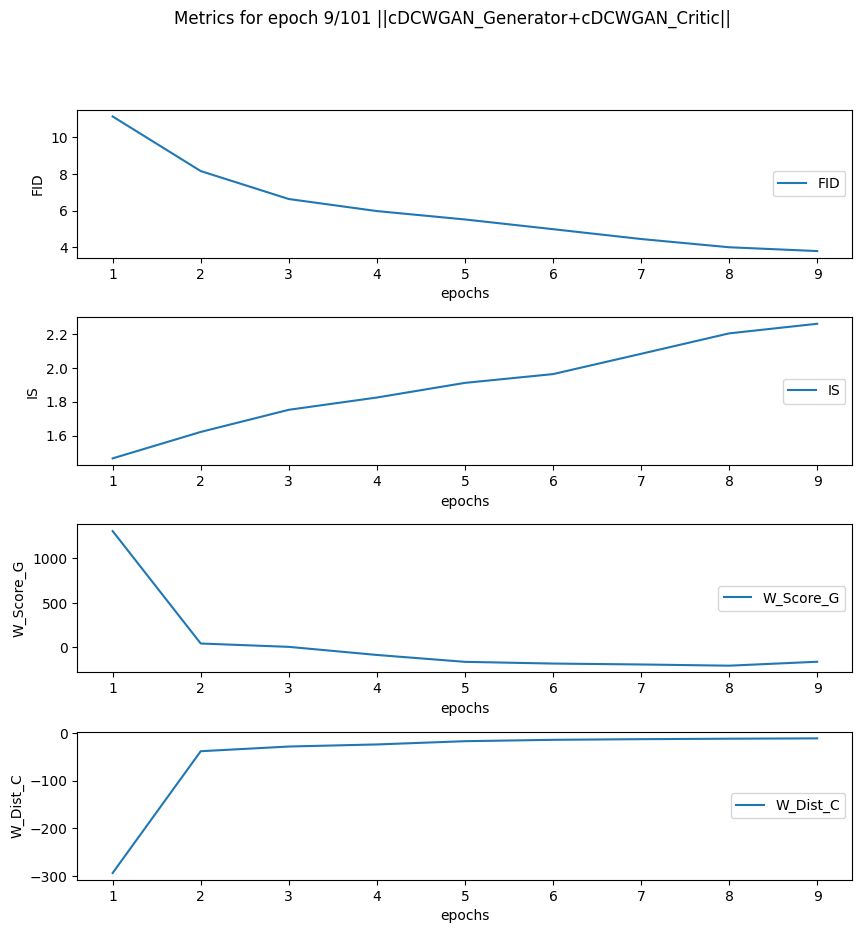

100%|██████████| 2853/2853 [07:50<00:00,  6.07it/s]


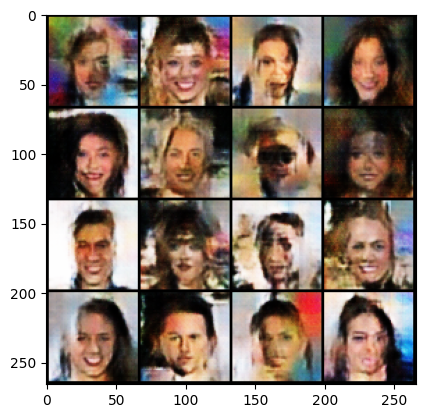

----------
Mean Generator Score: -122.49922105011187
Mean Critic distance: -10.524686808674703
Mean FID (64): 3.6997437477111816
Mean IS: 2.3480076789855957
Epoch Time: 7:50


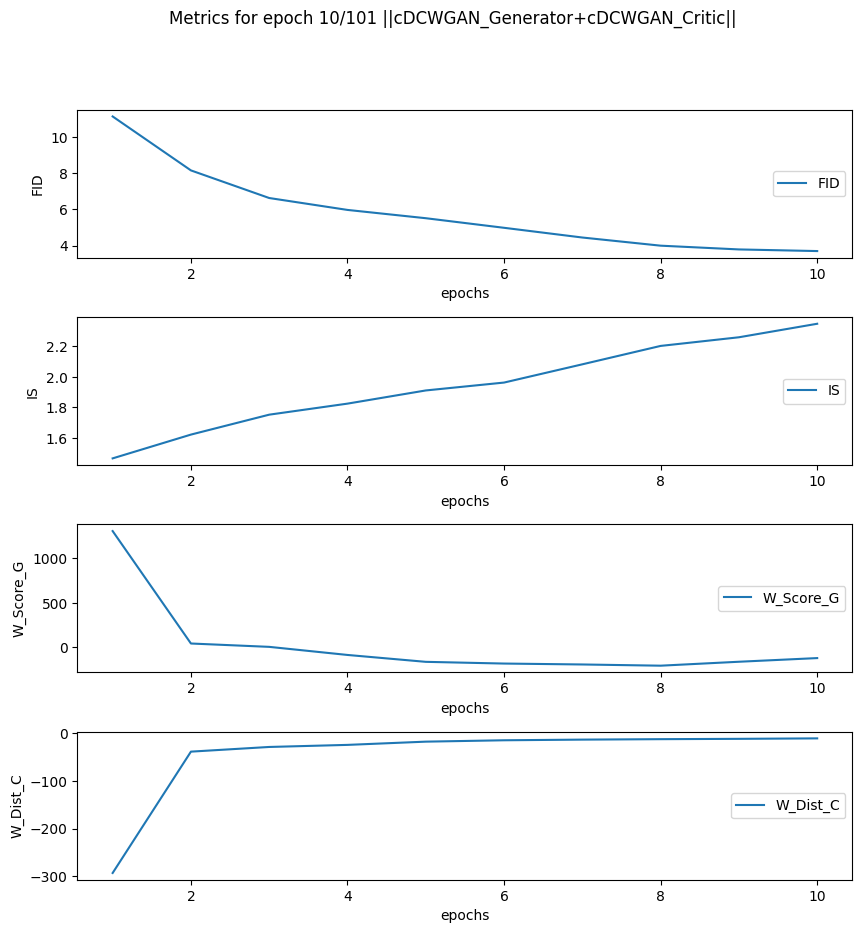

100%|██████████| 2853/2853 [07:50<00:00,  6.07it/s]


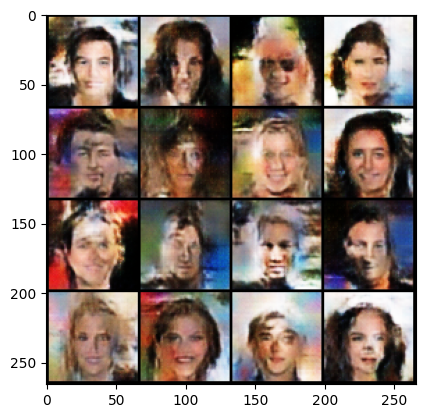

----------
Mean Generator Score: -69.92164631977415
Mean Critic distance: -9.845240699588897
Mean FID (64): 3.51474928855896
Mean IS: 2.3643507957458496
Epoch Time: 7:50


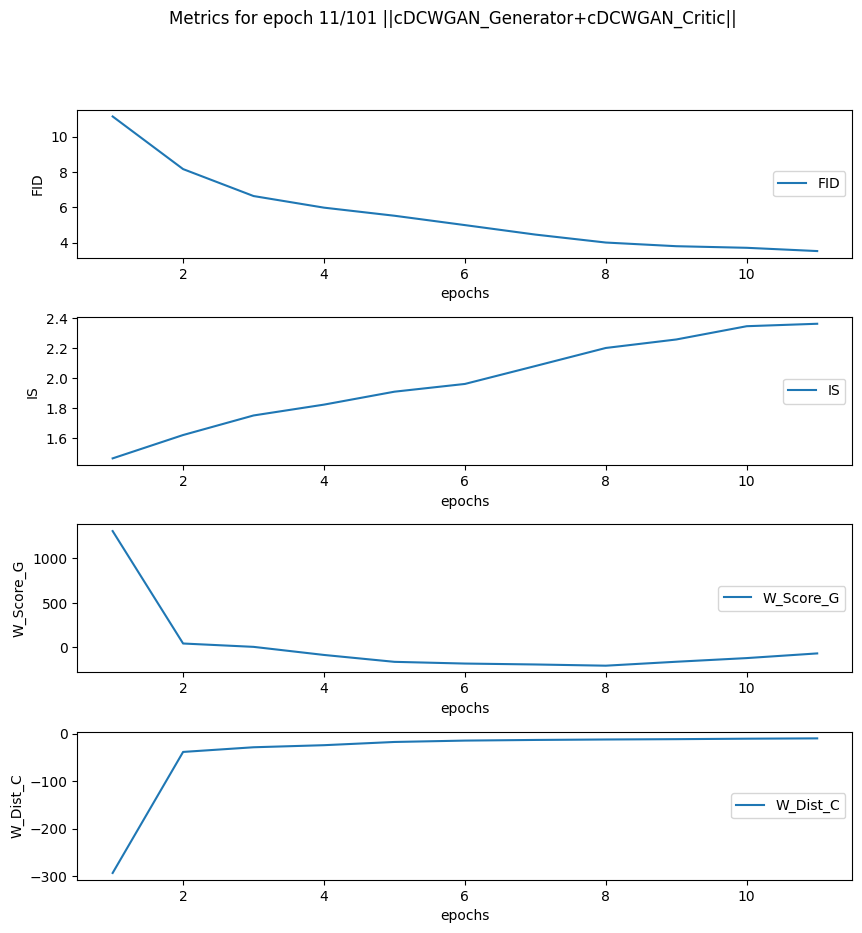

100%|██████████| 2853/2853 [07:50<00:00,  6.07it/s]


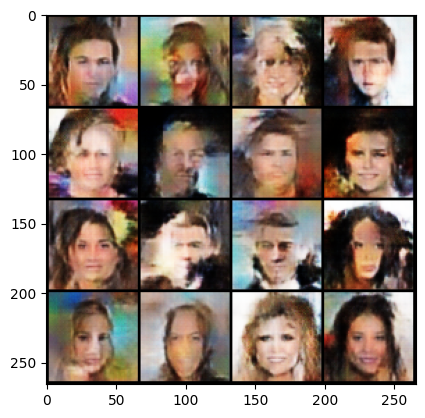

----------
Mean Generator Score: -98.9118952533655
Mean Critic distance: -9.737617642930463
Mean FID (64): 3.337651491165161
Mean IS: 2.3712615966796875
Epoch Time: 7:50


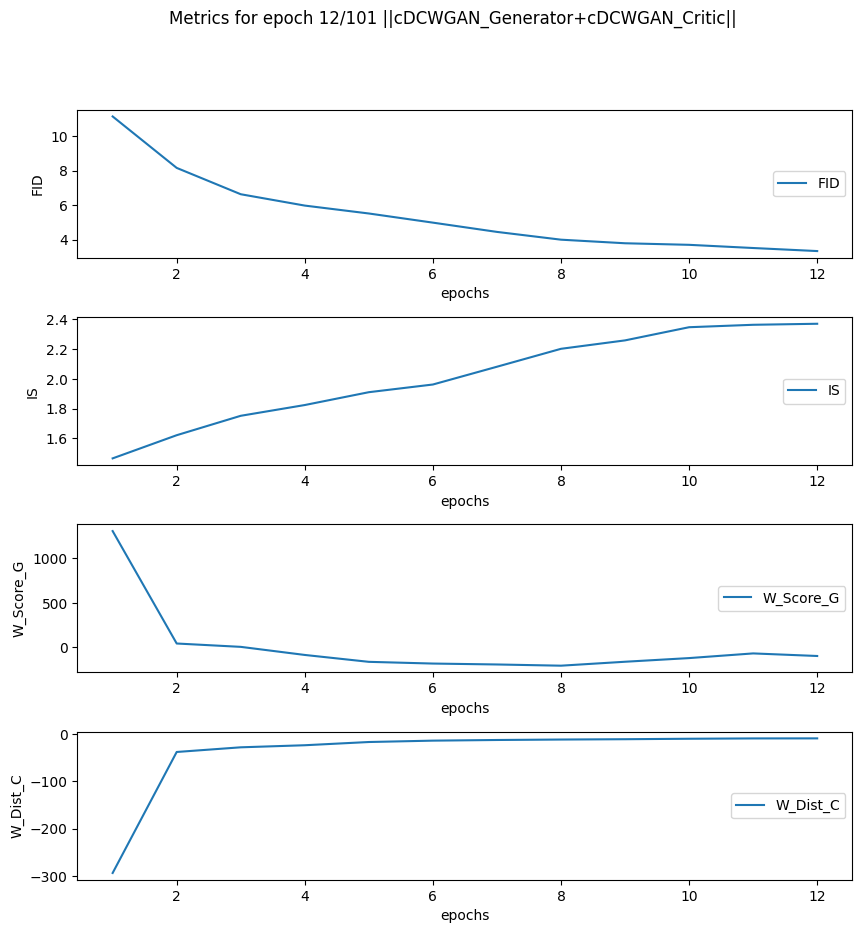

100%|██████████| 2853/2853 [07:49<00:00,  6.07it/s]


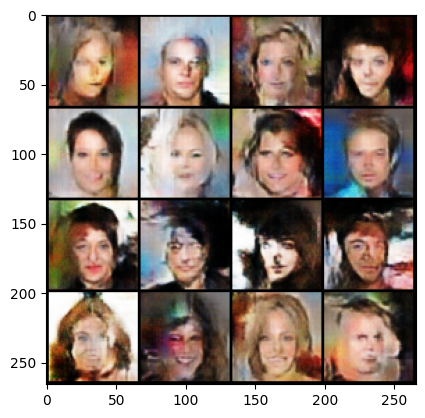

----------
Mean Generator Score: -77.390843026889
Mean Critic distance: -10.120501343258798
Mean FID (64): 3.003385066986084
Mean IS: 2.4149835109710693
Epoch Time: 7:49


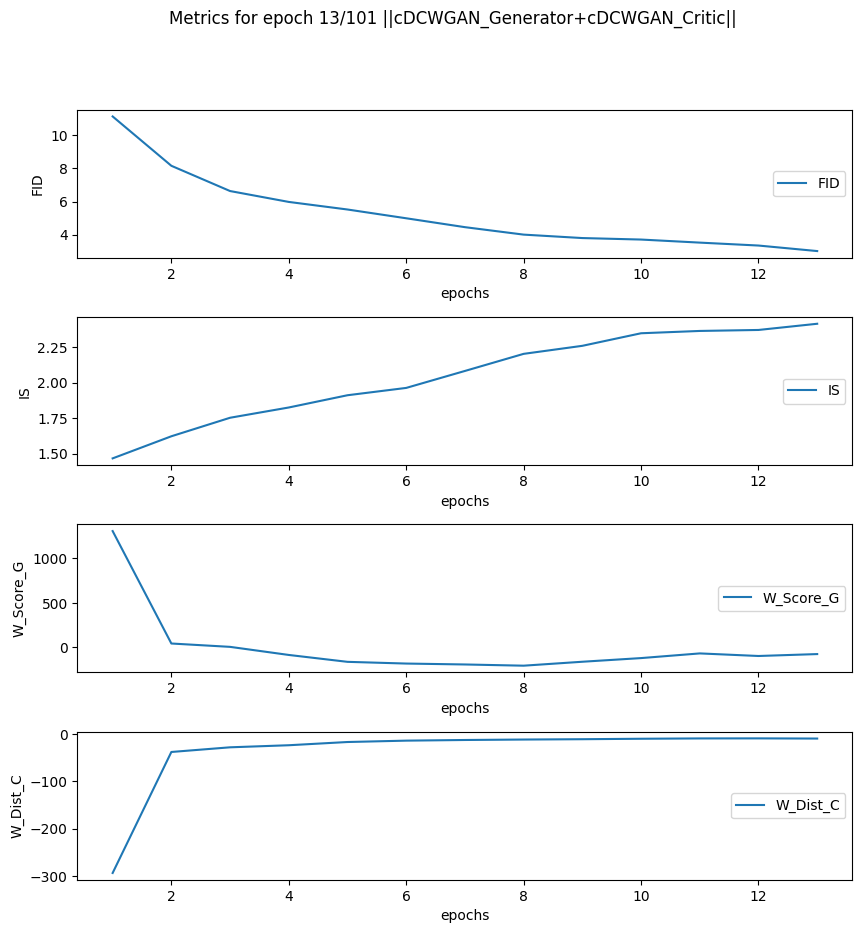

100%|██████████| 2853/2853 [07:50<00:00,  6.07it/s]


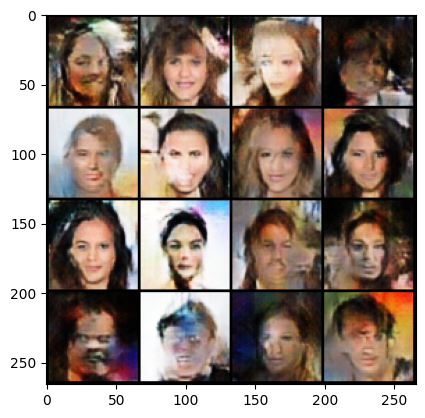

----------
Mean Generator Score: -72.32165135354326
Mean Critic distance: -10.63253897062904
Mean FID (64): 2.92630934715271
Mean IS: 2.4727025032043457
Epoch Time: 7:50


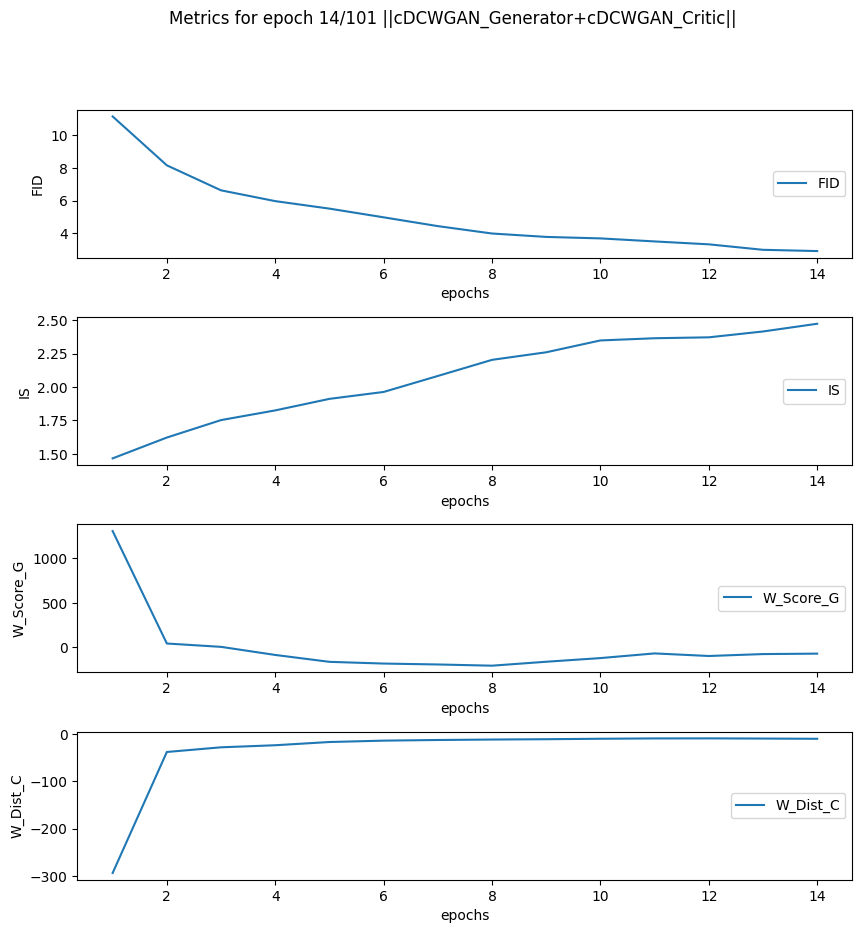

100%|██████████| 2853/2853 [07:50<00:00,  6.07it/s]


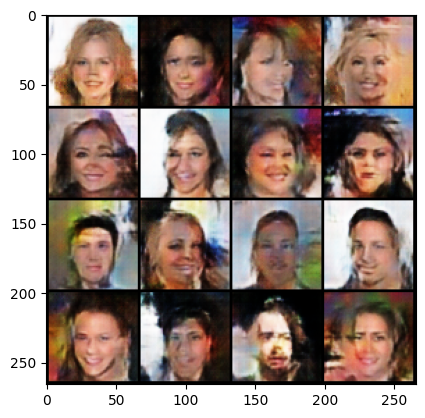

----------
Mean Generator Score: -81.5043065627416
Mean Critic distance: -11.414285791826966
Mean FID (64): 2.767249345779419
Mean IS: 2.55851411819458
Epoch Time: 7:50


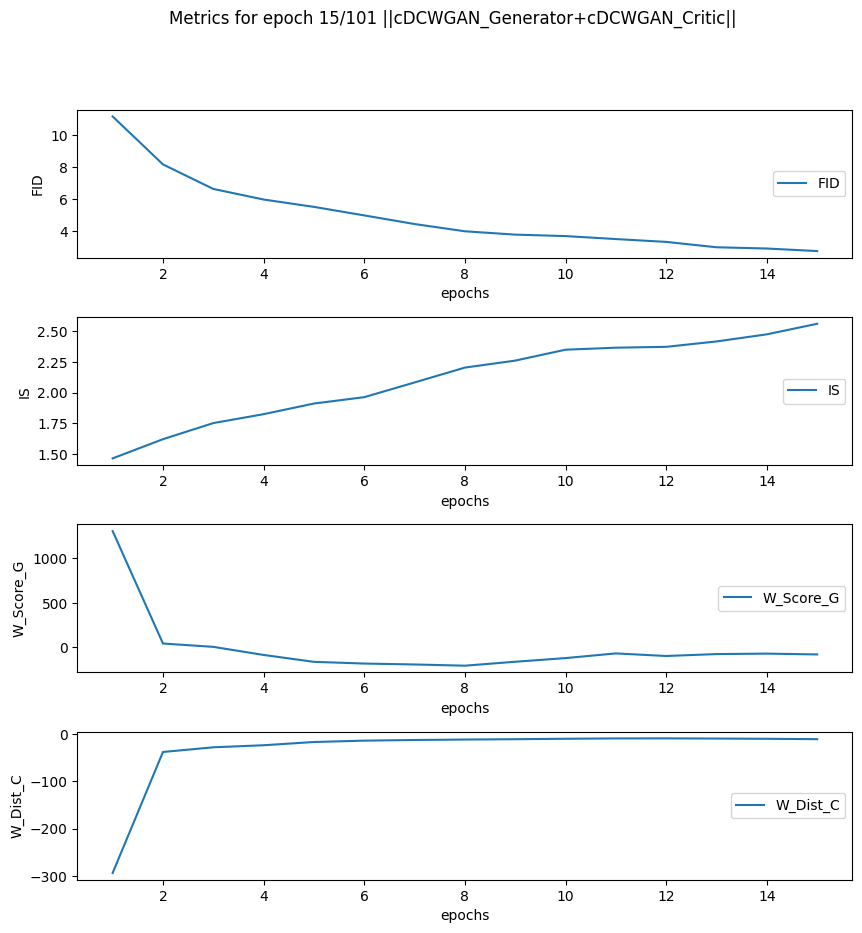

100%|██████████| 2853/2853 [07:50<00:00,  6.07it/s]


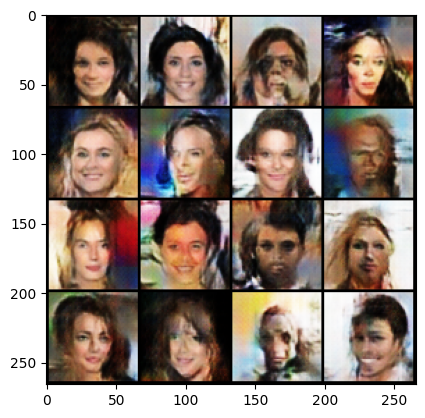

----------
Mean Generator Score: -82.48431130145725
Mean Critic distance: -11.099077337882079
Mean FID (64): 2.654406785964966
Mean IS: 2.5225255489349365
Epoch Time: 7:50


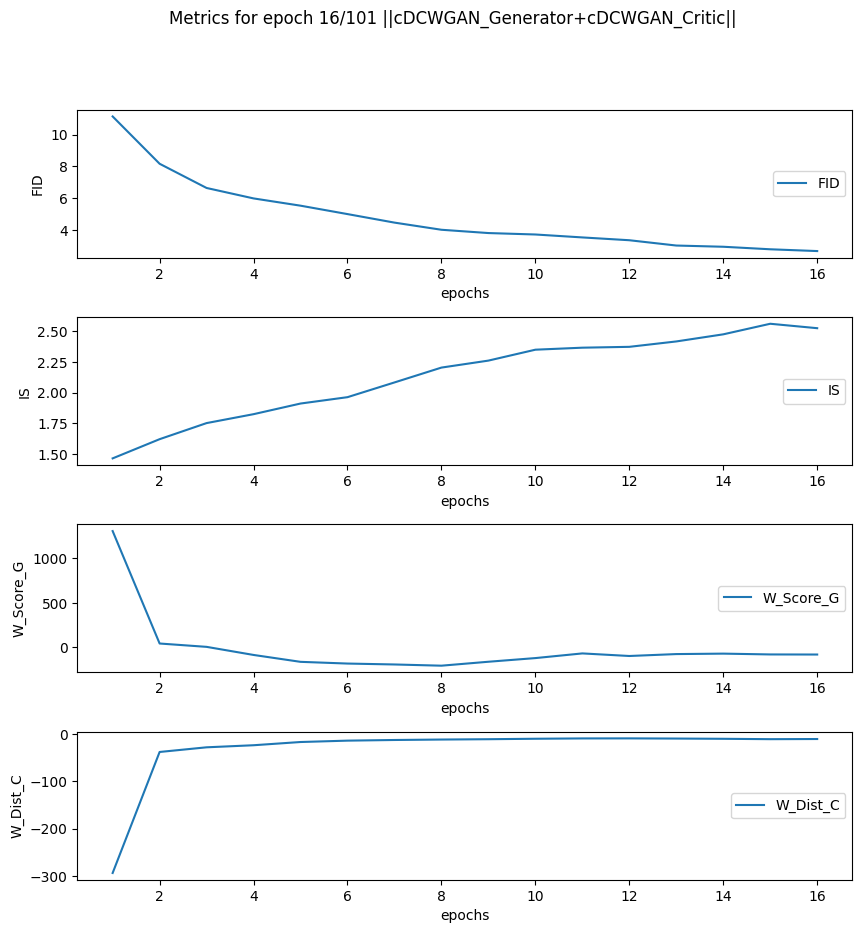

100%|██████████| 2853/2853 [07:50<00:00,  6.07it/s]


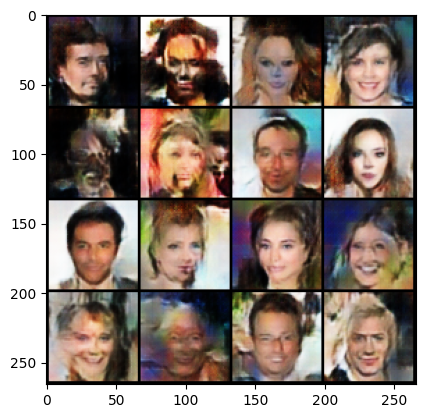

----------
Mean Generator Score: -81.92311056726857
Mean Critic distance: -10.820613233323604
Mean FID (64): 2.493939161300659
Mean IS: 2.5535874366760254
Epoch Time: 7:50


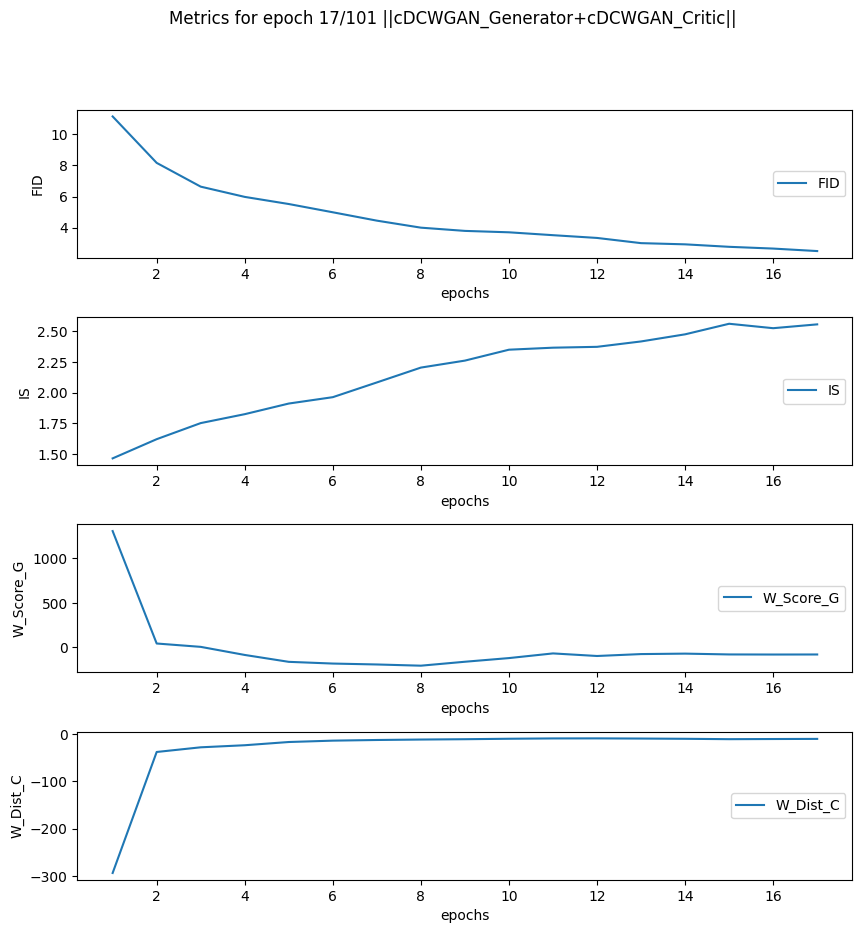

100%|██████████| 2853/2853 [07:50<00:00,  6.07it/s]


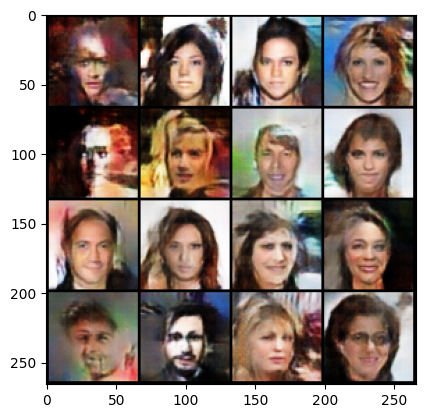

----------
Mean Generator Score: -94.72620901883694
Mean Critic distance: -10.831379859020448
Mean FID (64): 2.352346658706665
Mean IS: 2.595139741897583
Epoch Time: 7:50


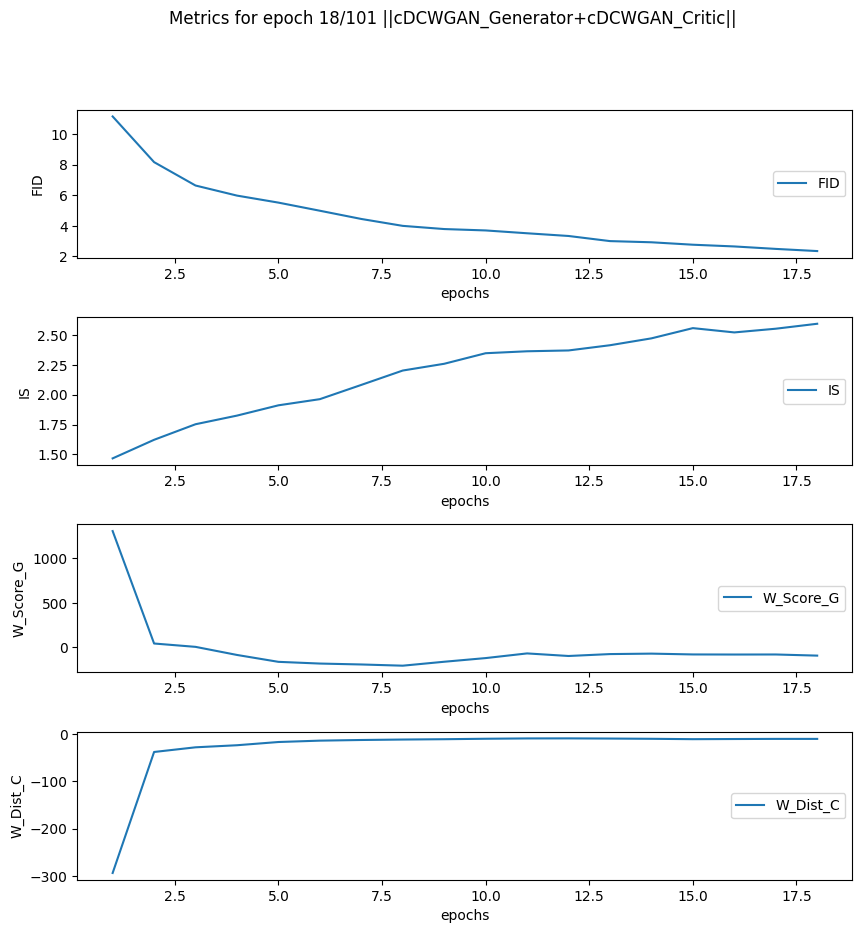

100%|██████████| 2853/2853 [07:50<00:00,  6.07it/s]


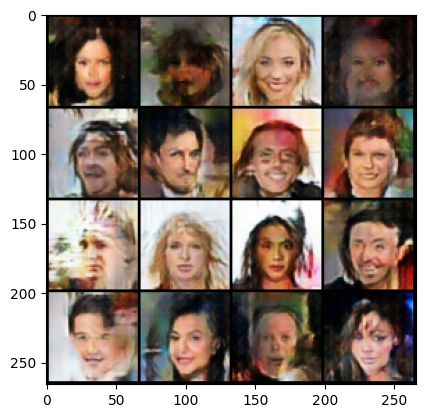

----------
Mean Generator Score: -90.40613239627136
Mean Critic distance: -10.791293606856728
Mean FID (64): 2.2668421268463135
Mean IS: 2.5983614921569824
Epoch Time: 7:50


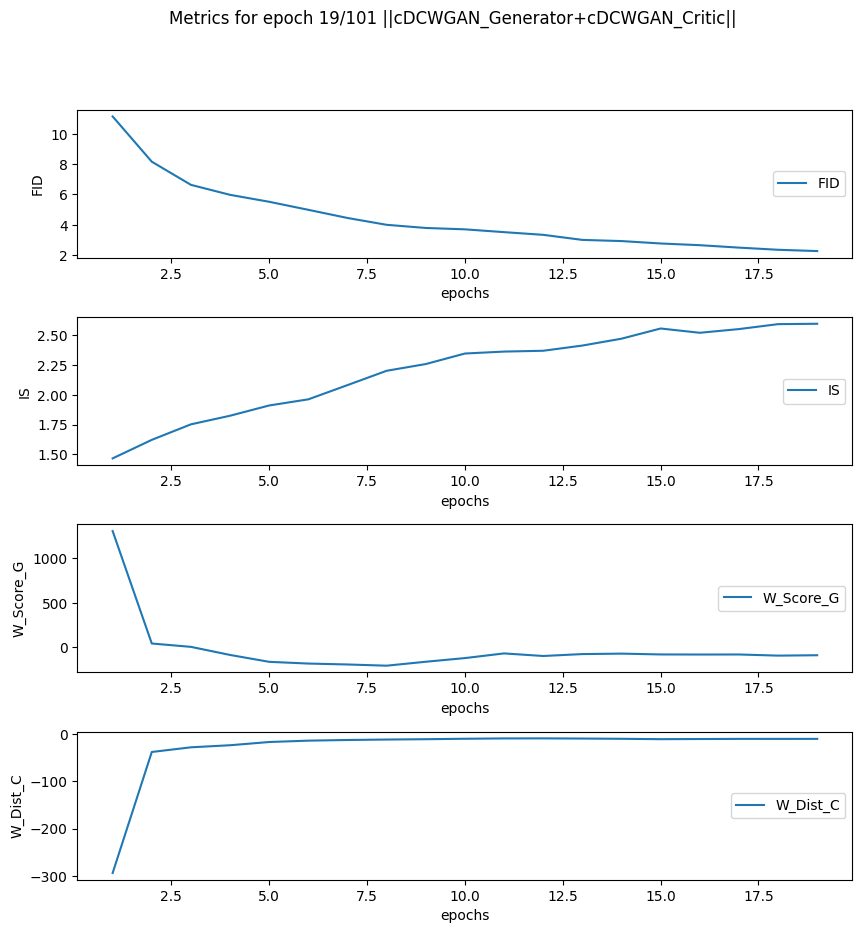

100%|██████████| 2853/2853 [07:50<00:00,  6.07it/s]


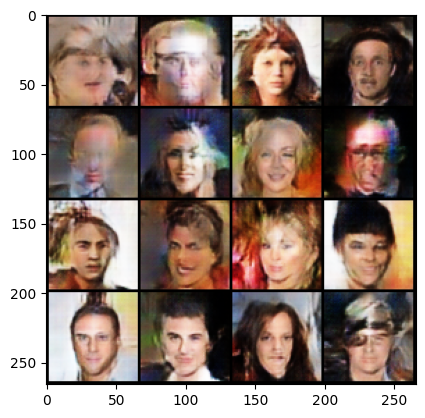

----------
Mean Generator Score: -88.4369292075174
Mean Critic distance: -10.42933386315641
Mean FID (64): 2.1648244857788086
Mean IS: 2.5841927528381348
Epoch Time: 7:50


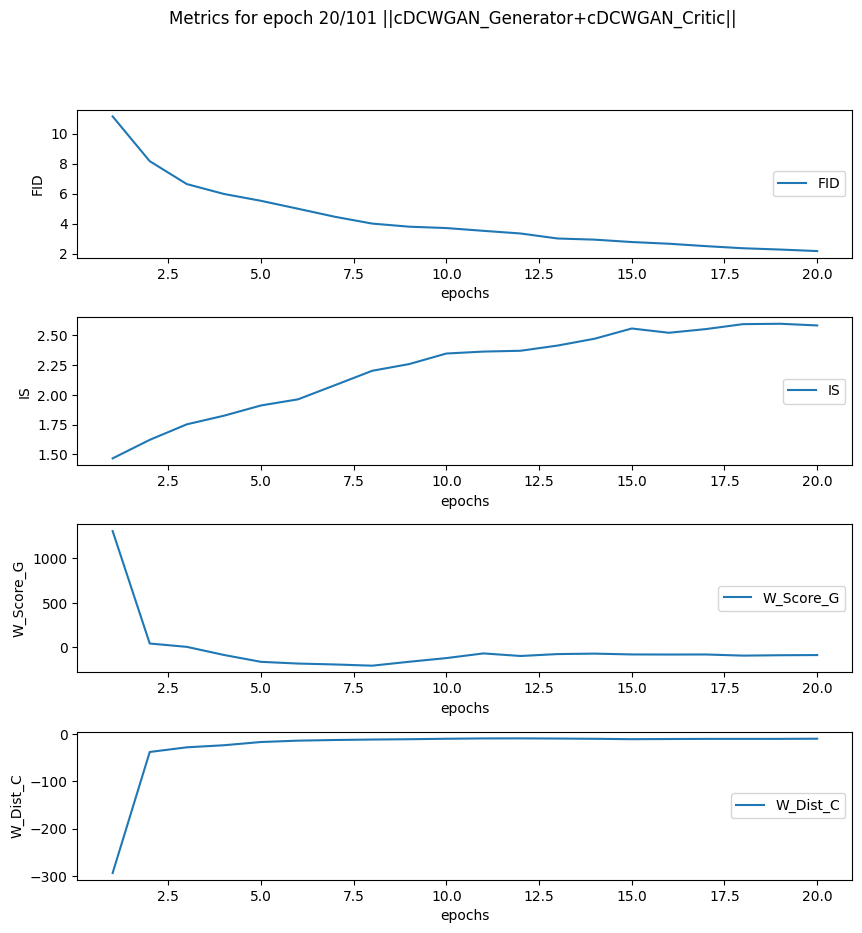

100%|██████████| 2853/2853 [07:50<00:00,  6.07it/s]


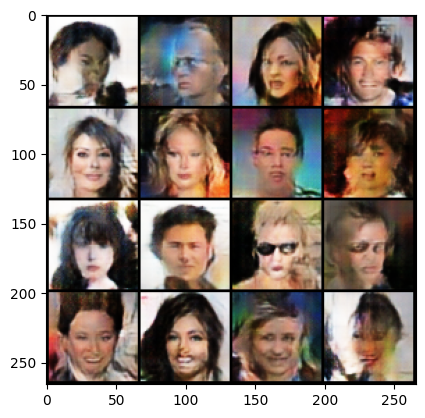

----------
Mean Generator Score: -93.912524632822
Mean Critic distance: -9.988951863216343
Mean FID (64): 2.0290188789367676
Mean IS: 2.562269687652588
Epoch Time: 7:50


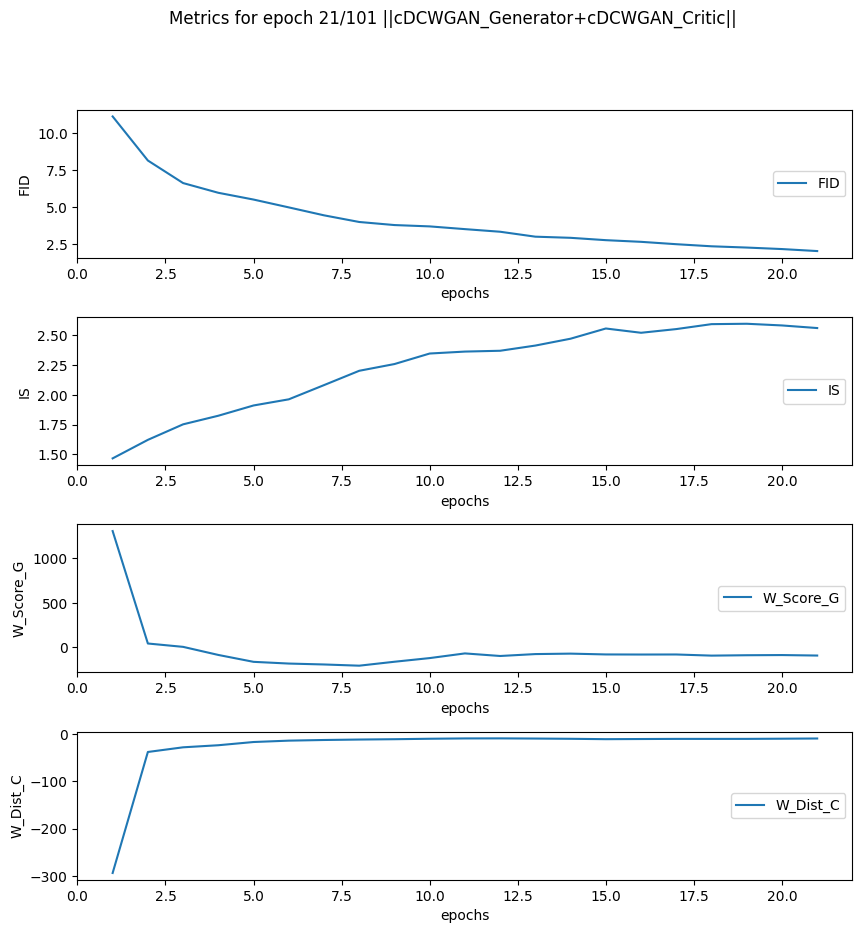

100%|██████████| 2853/2853 [07:50<00:00,  6.07it/s]


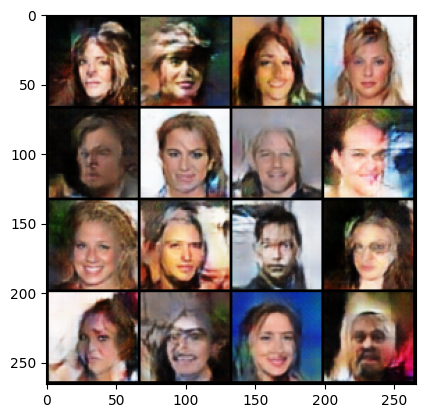

----------
Mean Generator Score: -86.66592429478963
Mean Critic distance: -9.912086749051772
Mean FID (64): 1.9097005128860474
Mean IS: 2.595637083053589
Epoch Time: 7:50


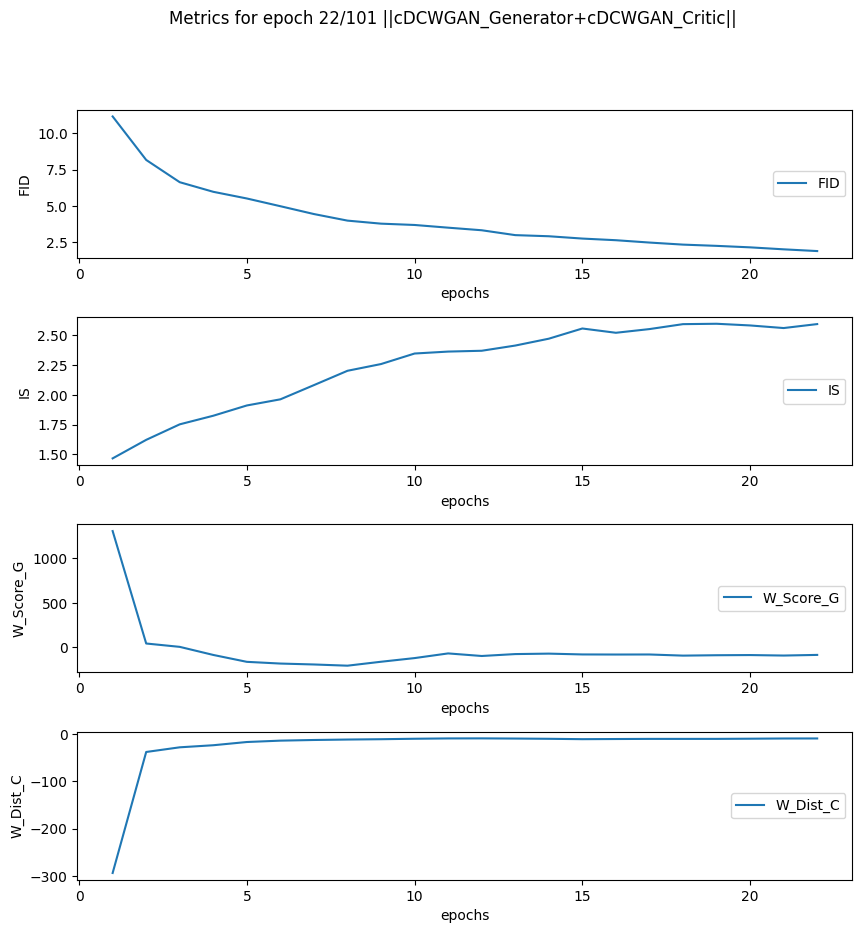

100%|██████████| 2853/2853 [07:50<00:00,  6.07it/s]


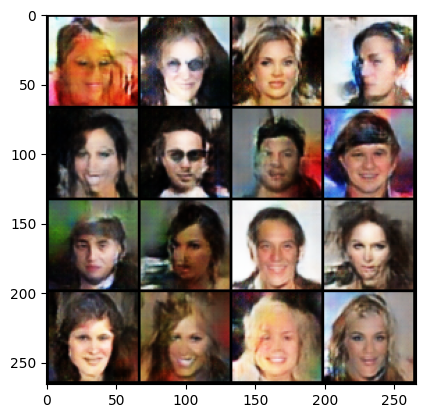

----------
Mean Generator Score: -87.26462379077024
Mean Critic distance: -9.749650075733975
Mean FID (64): 1.7832618951797485
Mean IS: 2.5815868377685547
Epoch Time: 7:50


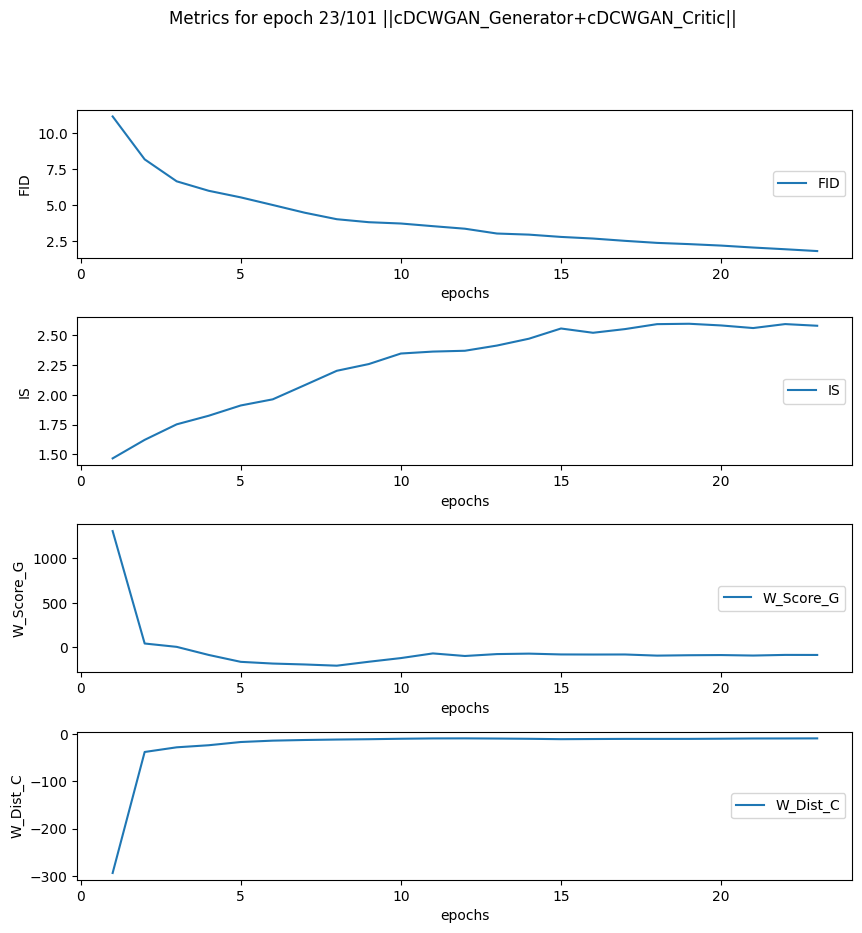

100%|██████████| 2853/2853 [07:50<00:00,  6.07it/s]


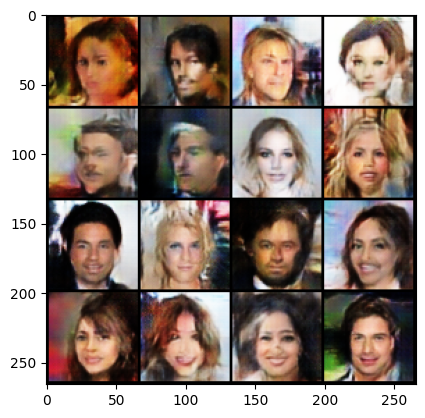

----------
Mean Generator Score: -81.98717540000614
Mean Critic distance: -9.520037072105154
Mean FID (64): 1.7713327407836914
Mean IS: 2.6073367595672607
Epoch Time: 7:50


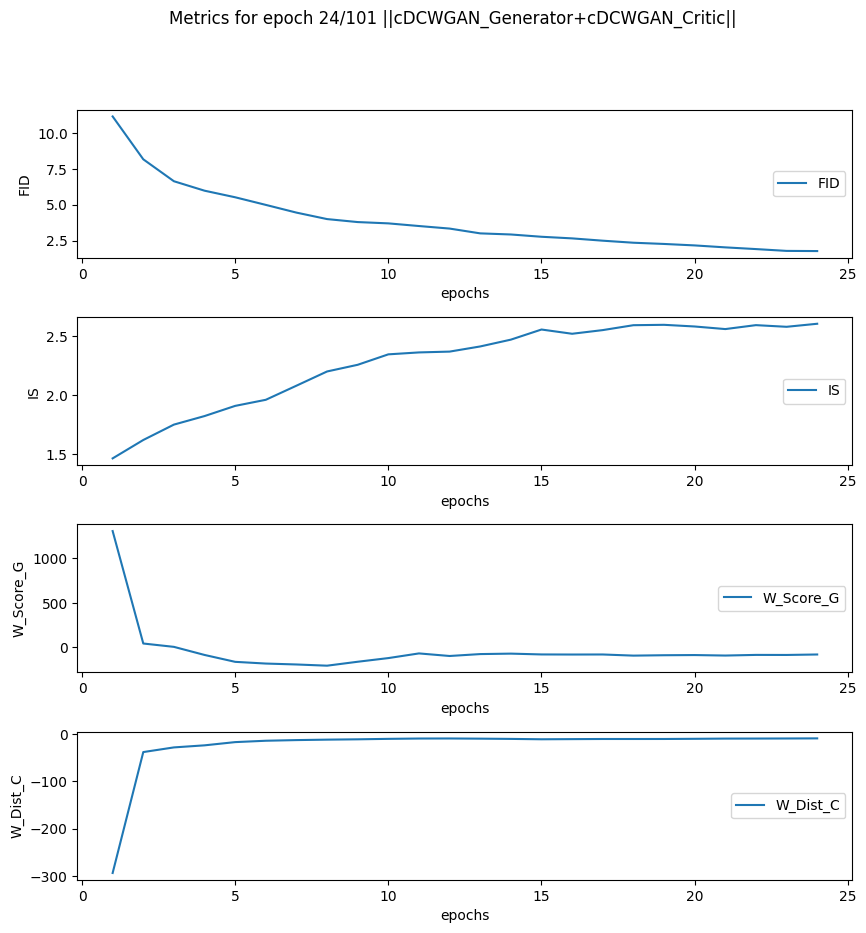

100%|██████████| 2853/2853 [07:50<00:00,  6.07it/s]


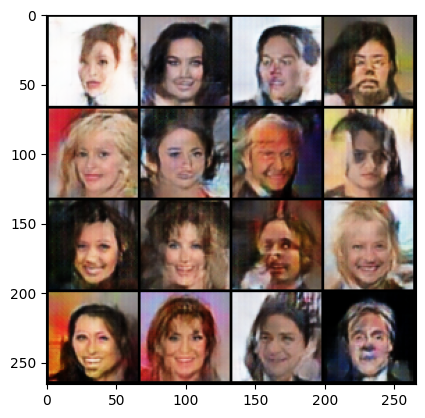

----------
Mean Generator Score: -79.93989638508413
Mean Critic distance: -9.39395385936733
Mean FID (64): 1.7642096281051636
Mean IS: 2.5896568298339844
Epoch Time: 7:50


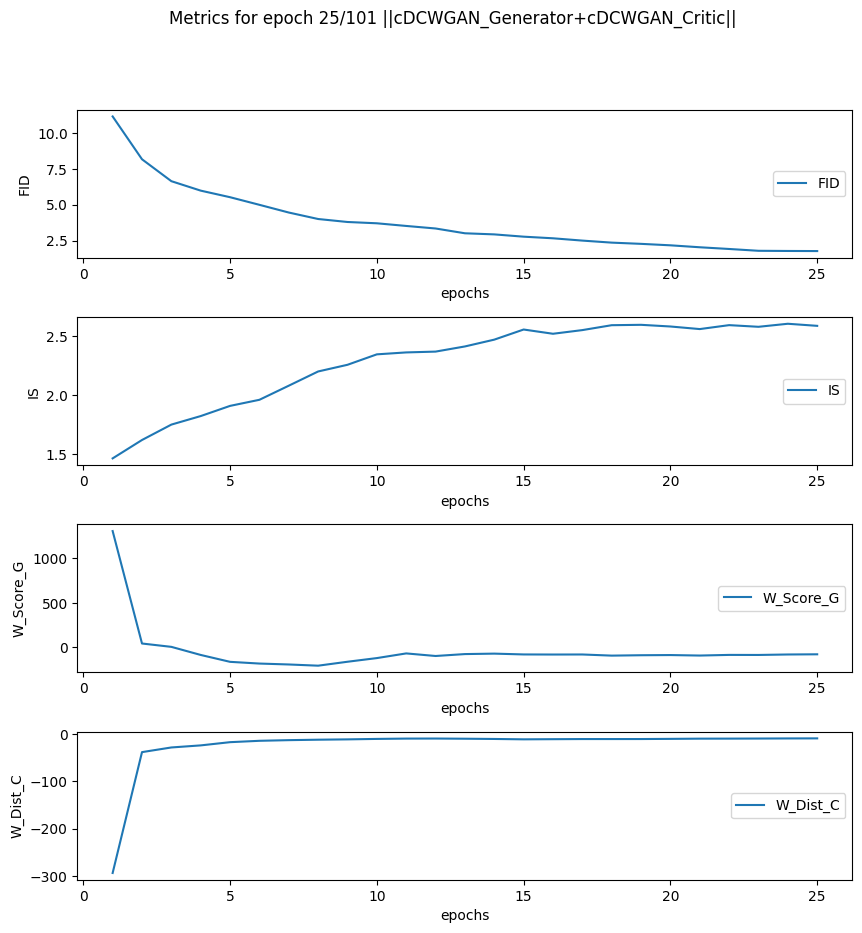

100%|██████████| 2853/2853 [07:50<00:00,  6.07it/s]


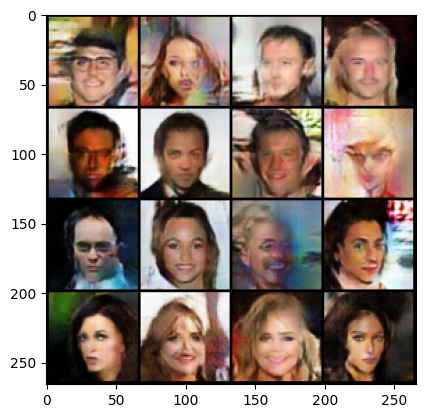

----------
Mean Generator Score: -71.11710462904813
Mean Critic distance: -9.158241381279176
Mean FID (64): 1.727457046508789
Mean IS: 2.574796199798584
Epoch Time: 7:50


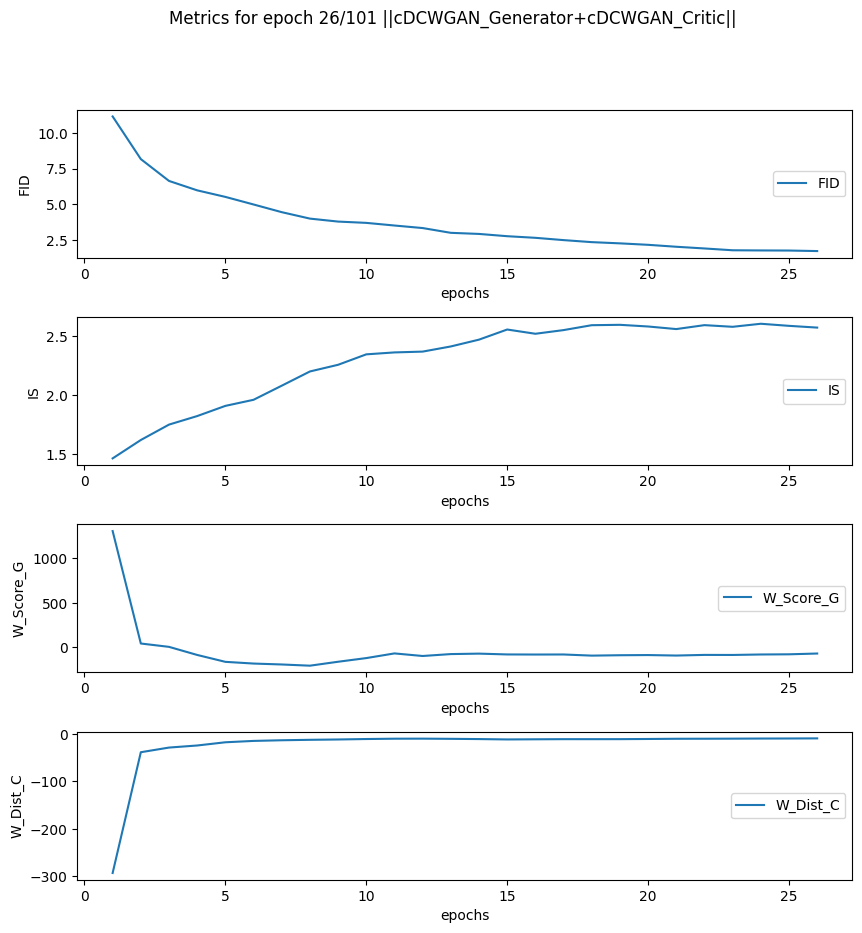

100%|██████████| 2853/2853 [07:50<00:00,  6.07it/s]


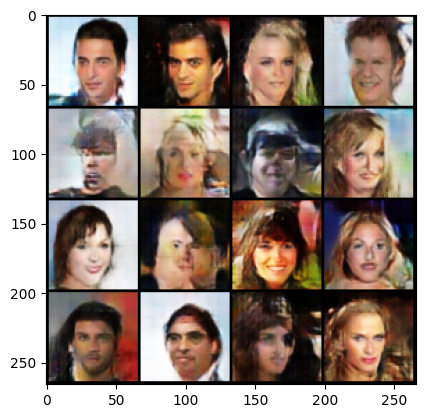

----------
Mean Generator Score: -79.13040626969254
Mean Critic distance: -9.272167957251089
Mean FID (64): 1.6489970684051514
Mean IS: 2.638643741607666
Epoch Time: 7:50


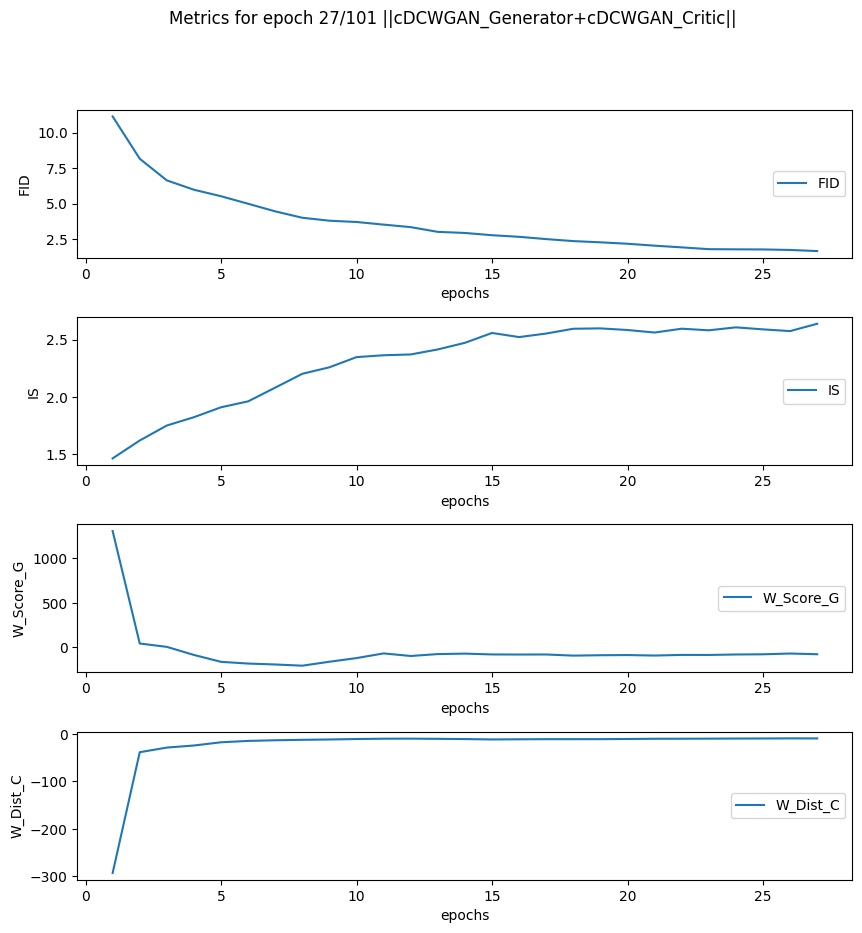

100%|██████████| 2853/2853 [07:50<00:00,  6.07it/s]


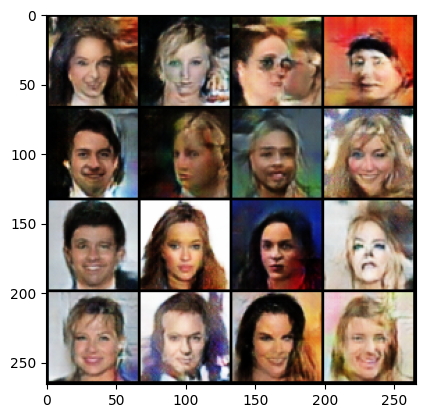

----------
Mean Generator Score: -66.85948165111374
Mean Critic distance: -9.081083079784994
Mean FID (64): 1.619067668914795
Mean IS: 2.6276867389678955
Epoch Time: 7:50


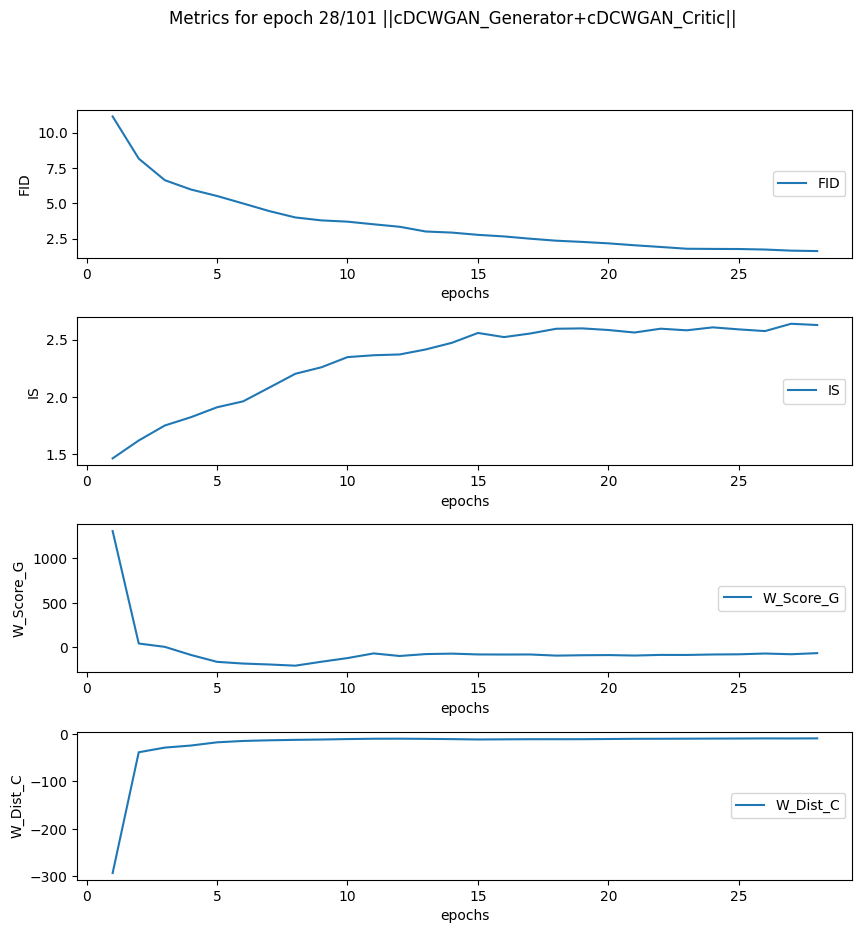

100%|██████████| 2853/2853 [07:50<00:00,  6.07it/s]


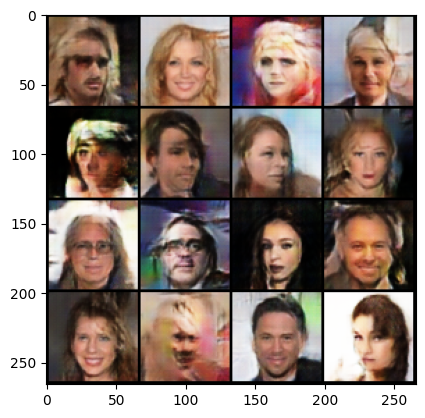

----------
Mean Generator Score: -67.08354745203988
Mean Critic distance: -9.060761991066972
Mean FID (64): 1.5067671537399292
Mean IS: 2.6120734214782715
Epoch Time: 7:50


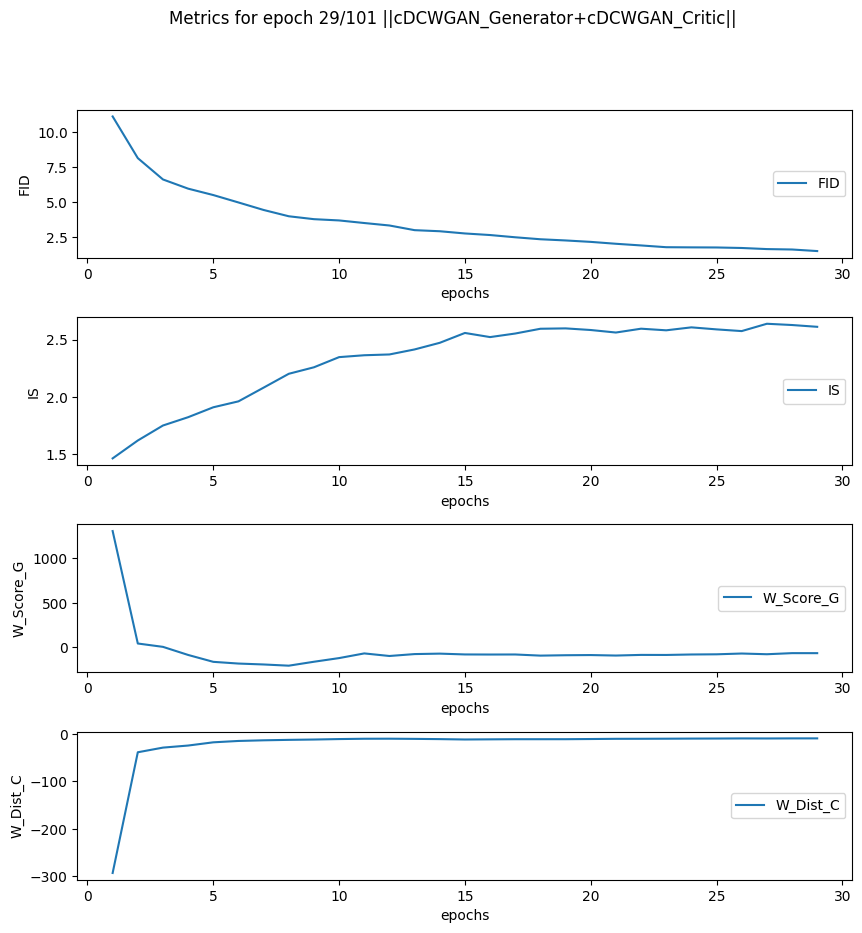

100%|██████████| 2853/2853 [07:50<00:00,  6.07it/s]


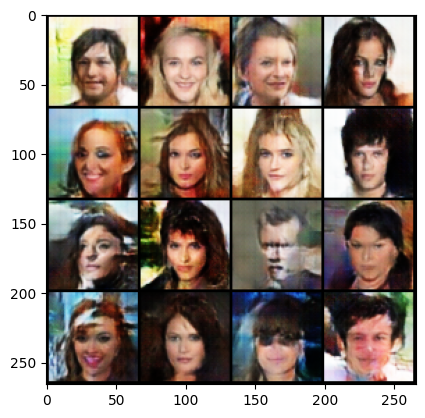

----------
Mean Generator Score: -62.38553860166616
Mean Critic distance: -8.906059466200547
Mean FID (64): 1.4902740716934204
Mean IS: 2.6471199989318848
Epoch Time: 7:50


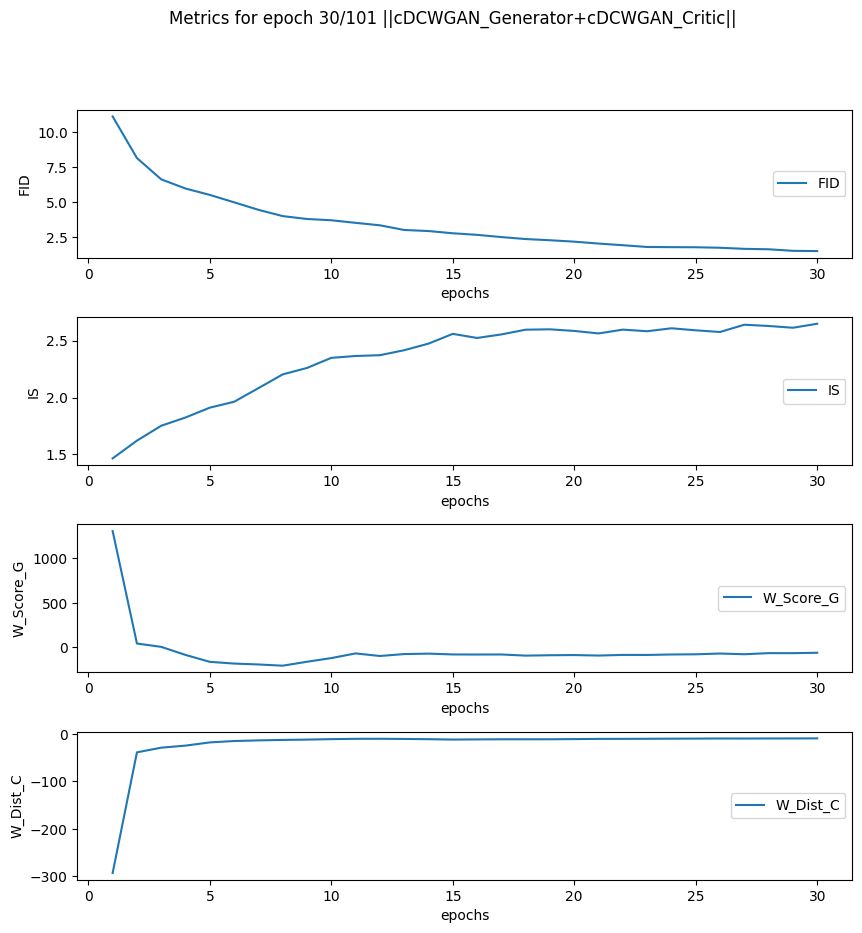

100%|██████████| 2853/2853 [07:50<00:00,  6.07it/s]


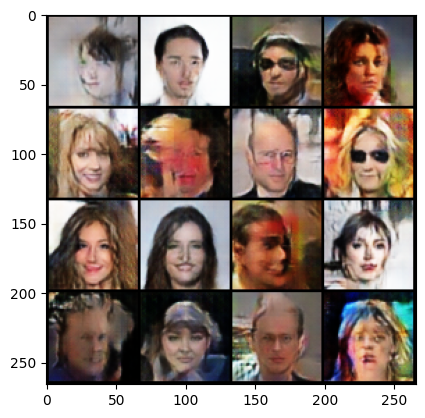

----------
Mean Generator Score: -58.610481649950934
Mean Critic distance: -8.758231031656516
Mean FID (64): 1.4566978216171265
Mean IS: 2.64583158493042
Epoch Time: 7:50


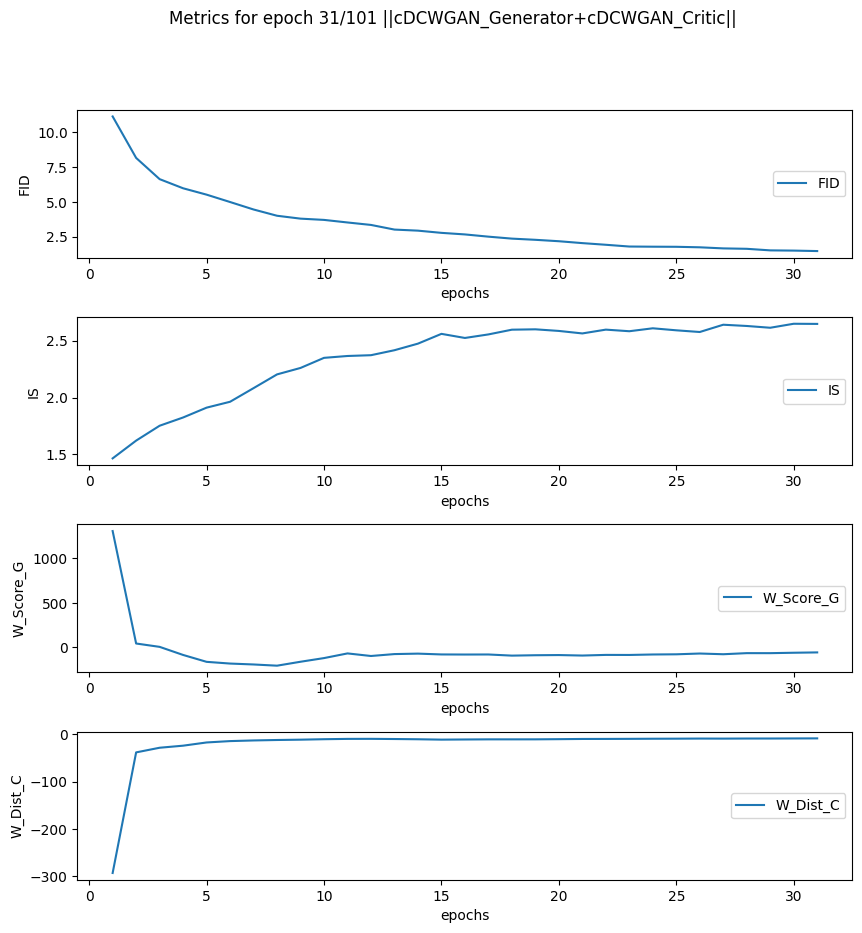

100%|██████████| 2853/2853 [07:50<00:00,  6.07it/s]


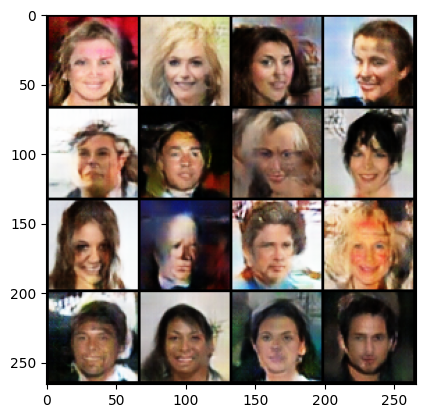

----------
Mean Generator Score: -53.77387299244864
Mean Critic distance: -8.718332826485351
Mean FID (64): 1.415993571281433
Mean IS: 2.6705362796783447
Epoch Time: 7:50


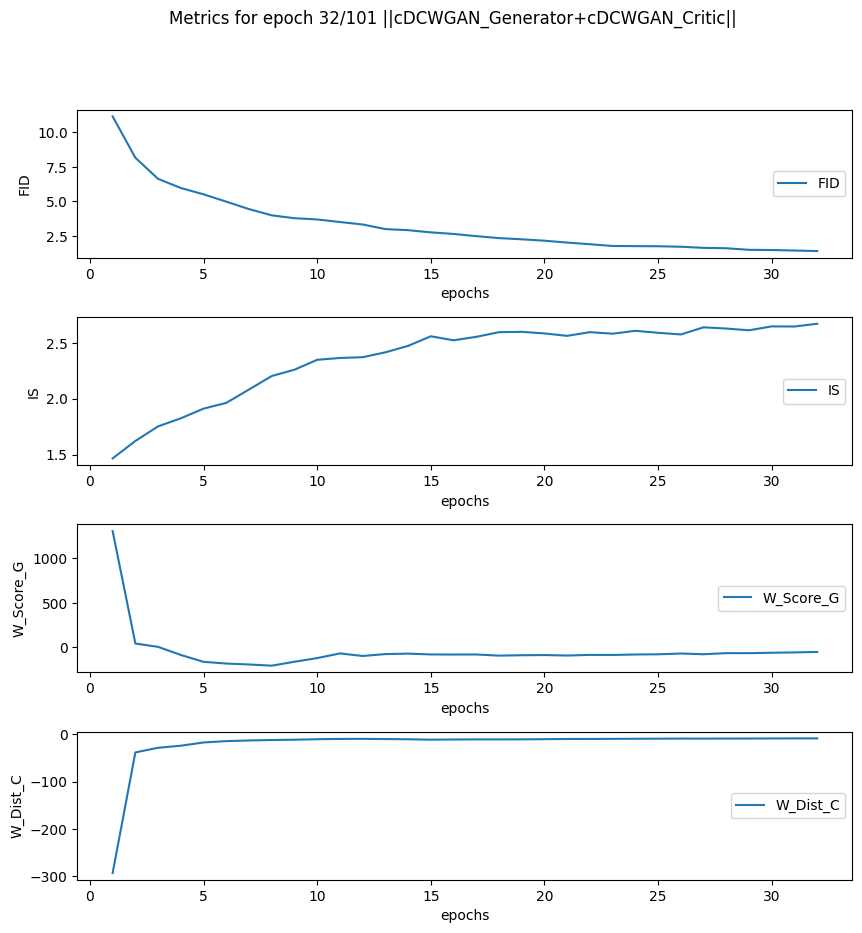

100%|██████████| 2853/2853 [07:50<00:00,  6.07it/s]


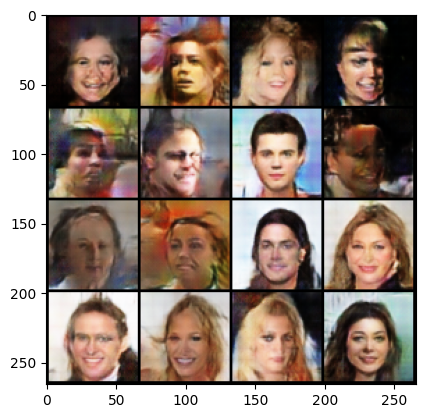

----------
Mean Generator Score: -54.736801342587725
Mean Critic distance: -8.74383574621827
Mean FID (64): 1.345266342163086
Mean IS: 2.704730749130249
Epoch Time: 7:50


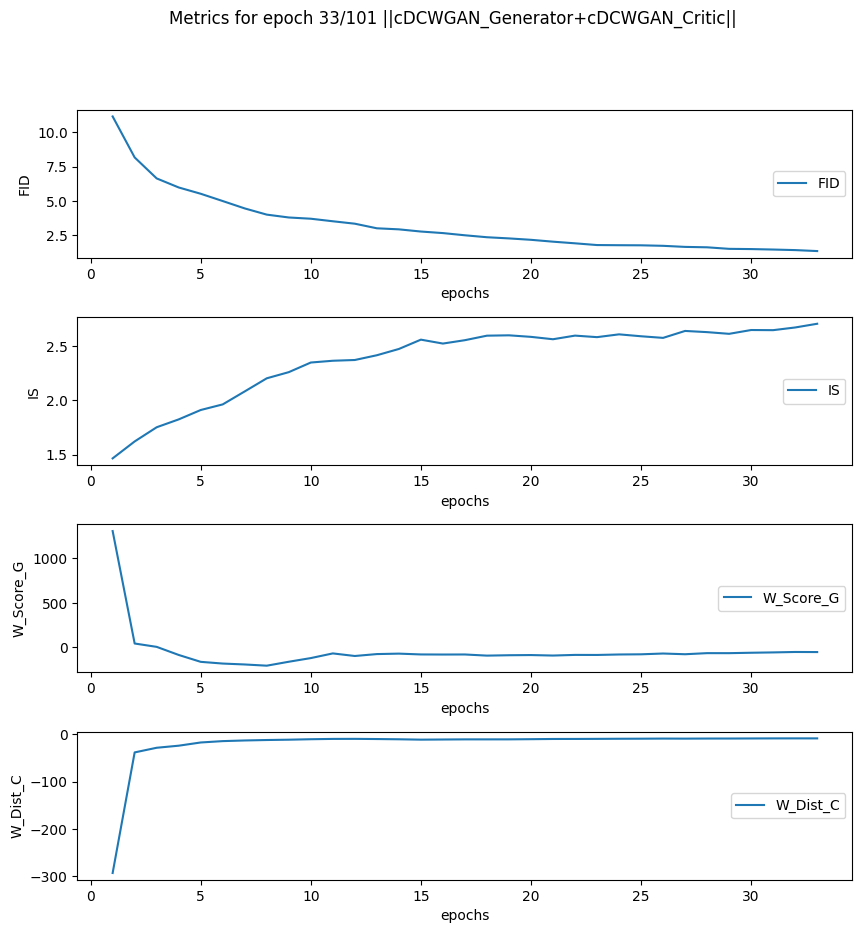

100%|██████████| 2853/2853 [07:49<00:00,  6.07it/s]


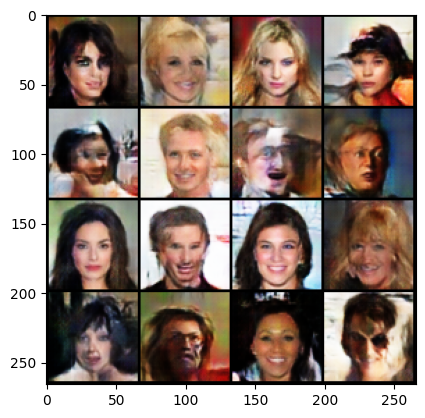

----------
Mean Generator Score: -52.41391660602469
Mean Critic distance: -8.593103050809553
Mean FID (64): 1.3093441724777222
Mean IS: 2.716315984725952
Epoch Time: 7:49


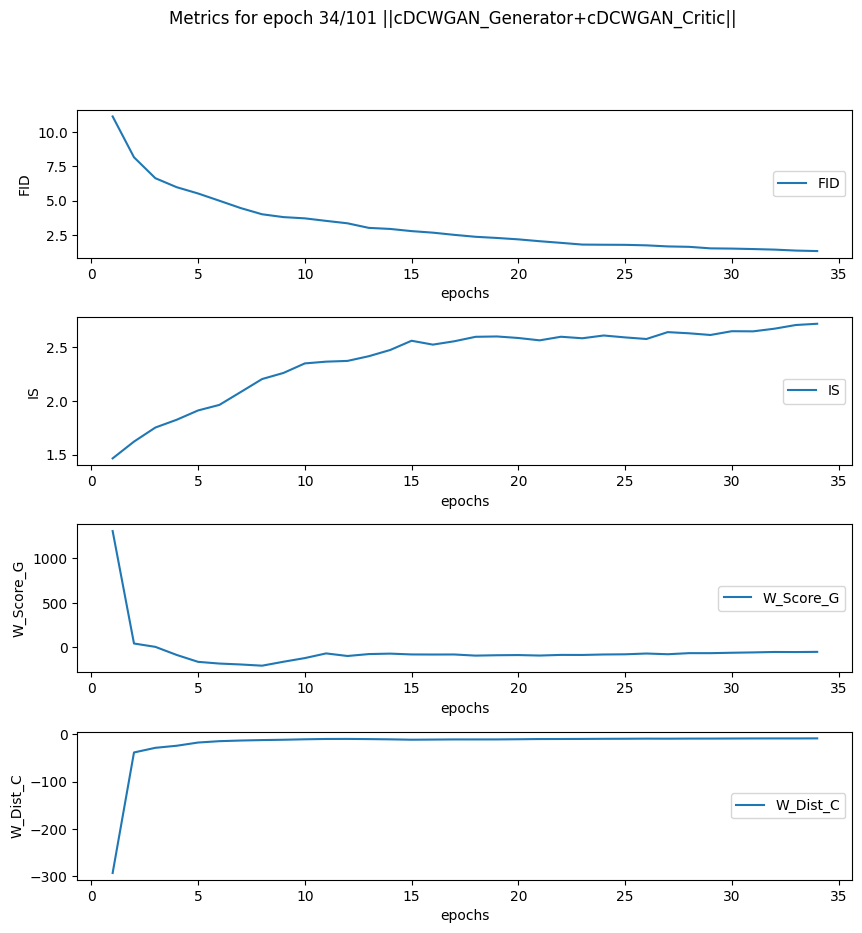

100%|██████████| 2853/2853 [07:50<00:00,  6.07it/s]


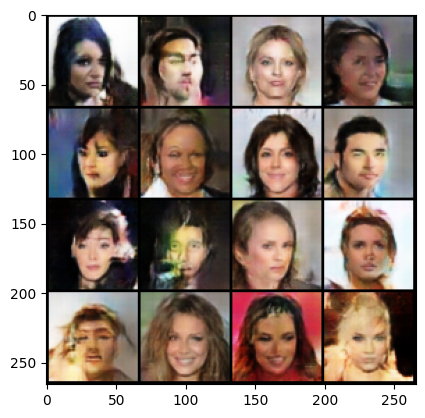

----------
Mean Generator Score: -48.30152679901374
Mean Critic distance: -8.503382131587903
Mean FID (64): 1.2763653993606567
Mean IS: 2.6996140480041504
Epoch Time: 7:50


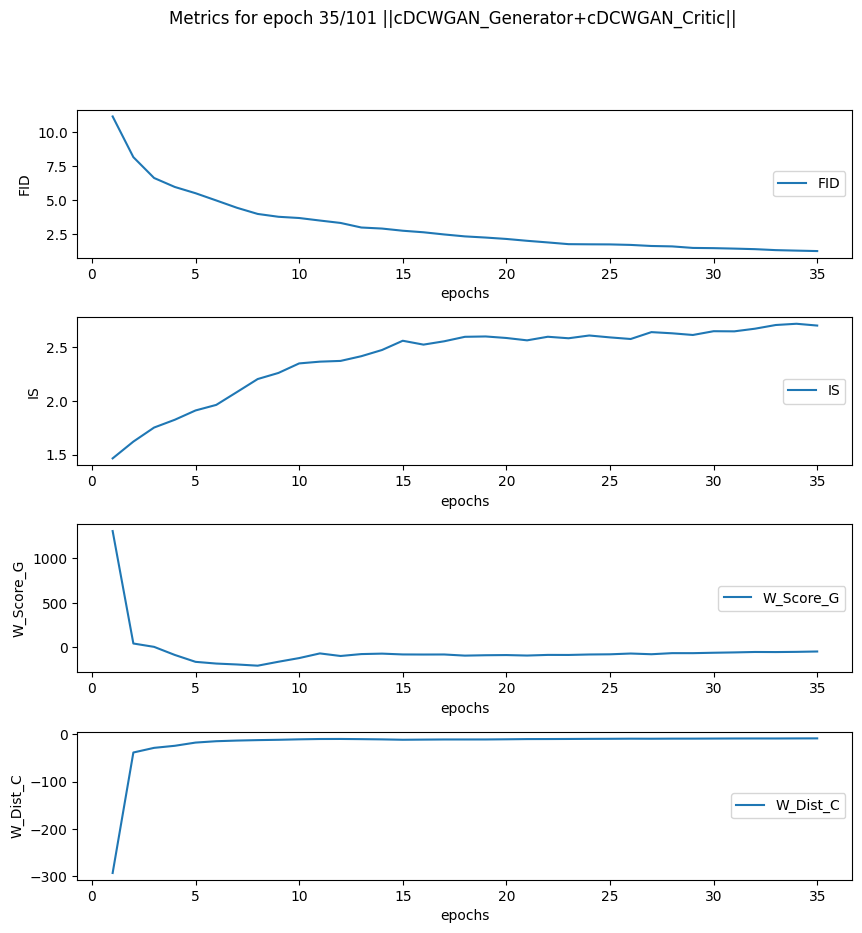

100%|██████████| 2853/2853 [07:50<00:00,  6.07it/s]


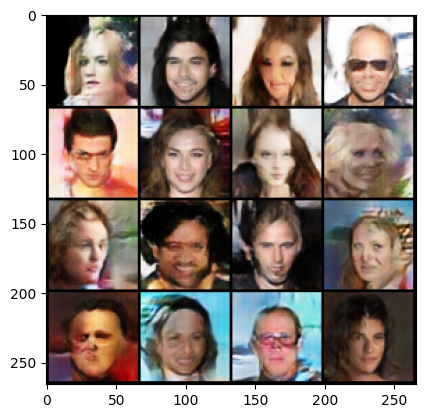

----------
Mean Generator Score: -47.91132835662156
Mean Critic distance: -8.392462030611998
Mean FID (64): 1.229896068572998
Mean IS: 2.7081193923950195
Epoch Time: 7:50


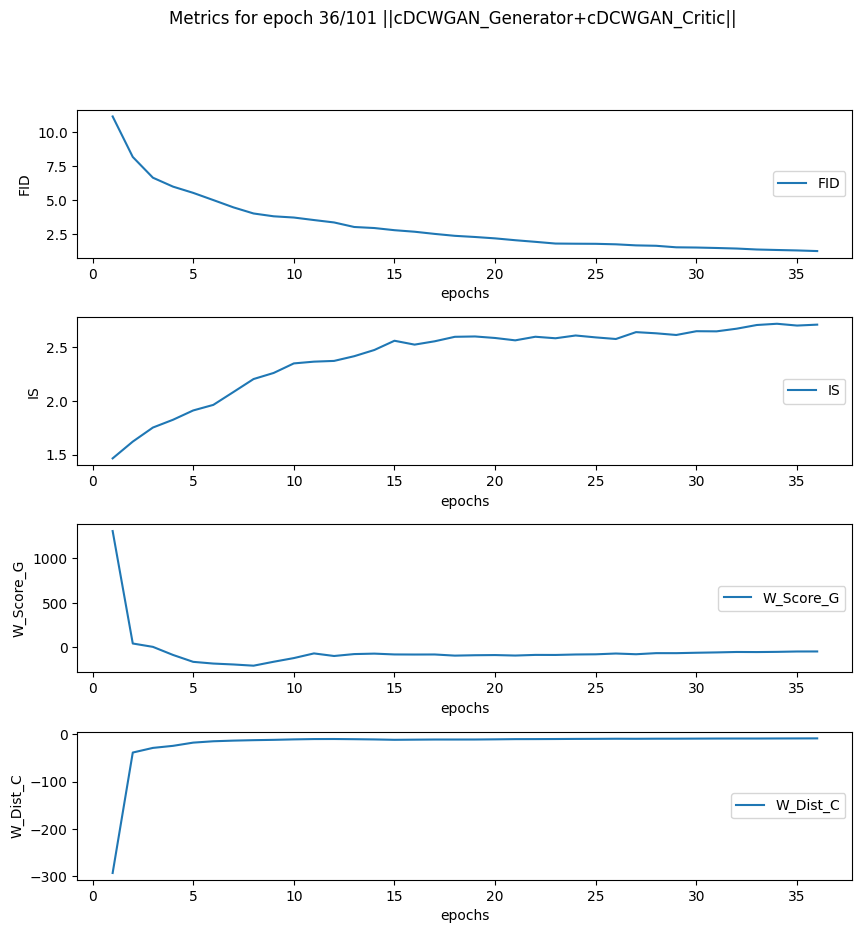

100%|██████████| 2853/2853 [07:49<00:00,  6.07it/s]


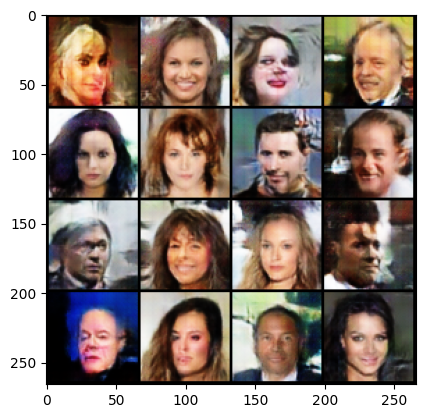

----------
Mean Generator Score: -45.802224866758316
Mean Critic distance: -8.29166375015478
Mean FID (64): 1.1942646503448486
Mean IS: 2.7070975303649902
Epoch Time: 7:49


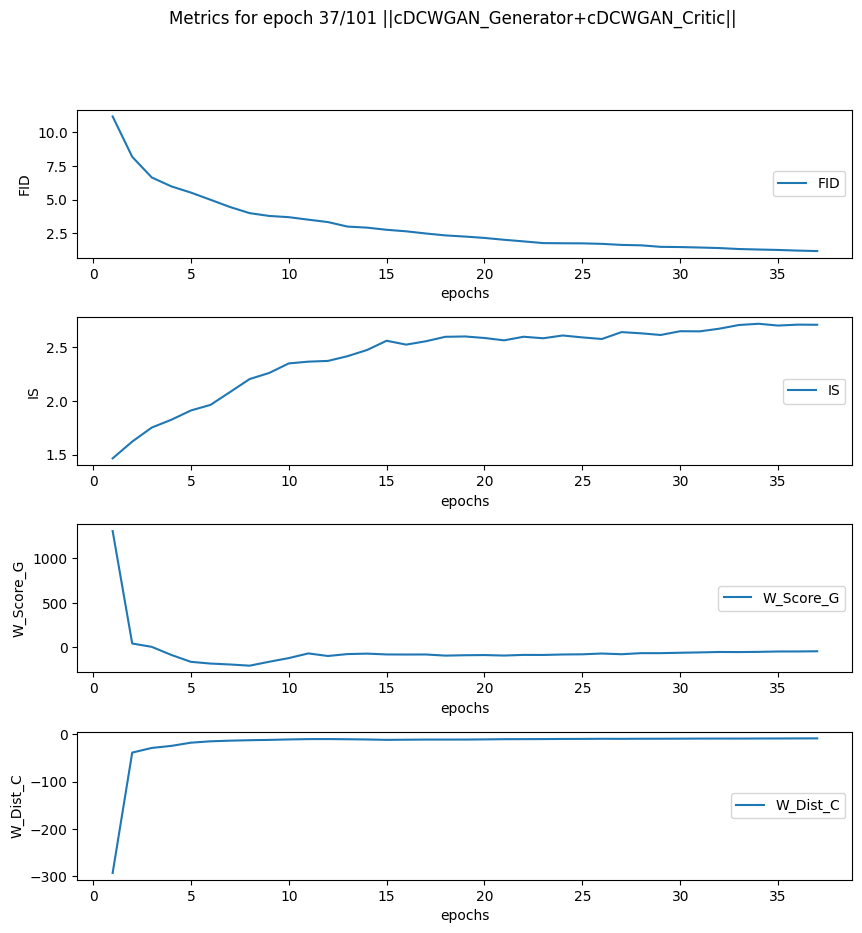

100%|██████████| 2853/2853 [07:50<00:00,  6.07it/s]


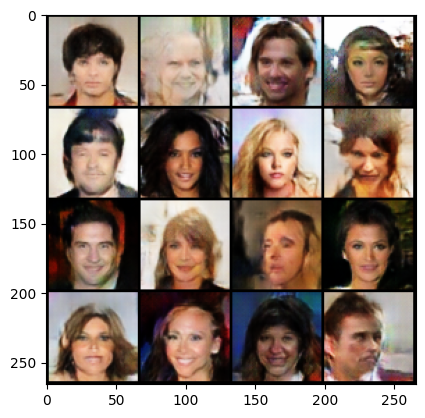

----------
Mean Generator Score: -46.12041422860664
Mean Critic distance: -8.180443797159981
Mean FID (64): 1.1133607625961304
Mean IS: 2.7204315662384033
Epoch Time: 7:50


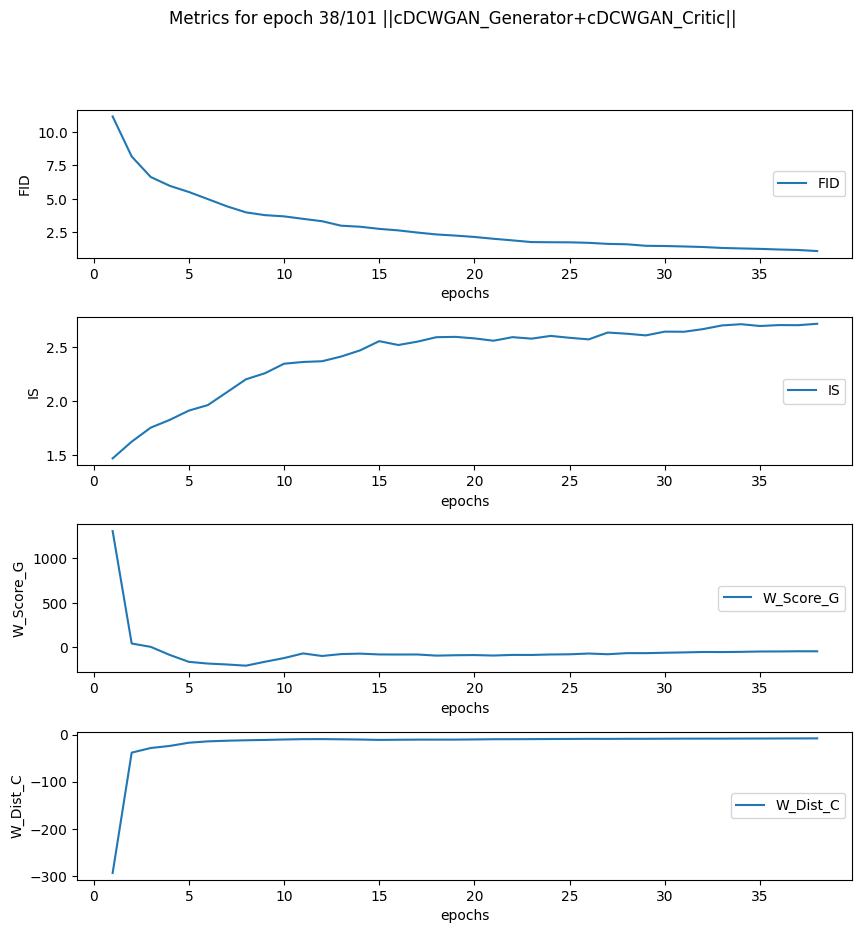

100%|██████████| 2853/2853 [07:49<00:00,  6.07it/s]


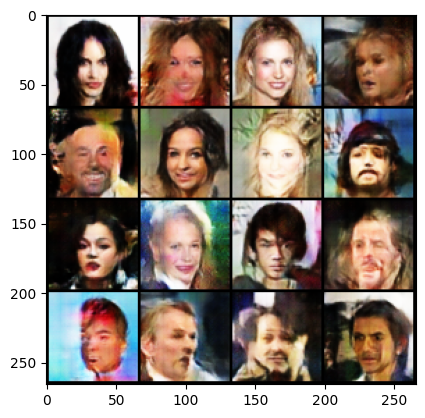

----------
Mean Generator Score: -46.081977065717965
Mean Critic distance: -8.149864687152466
Mean FID (64): 1.1189141273498535
Mean IS: 2.7204291820526123
Epoch Time: 7:49


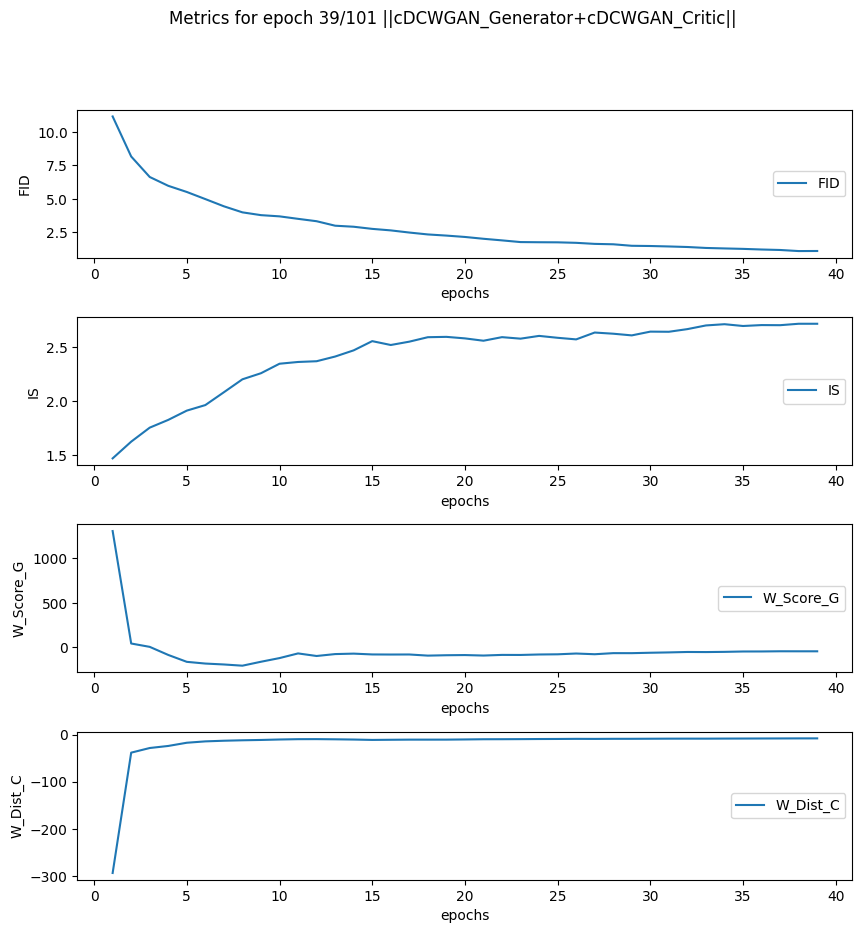

100%|██████████| 2853/2853 [07:50<00:00,  6.07it/s]


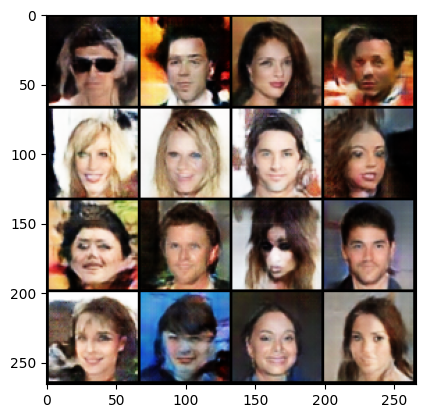

----------
Mean Generator Score: -44.009440903182615
Mean Critic distance: -7.969759586941264
Mean FID (64): 1.0868924856185913
Mean IS: 2.697831153869629
Epoch Time: 7:50


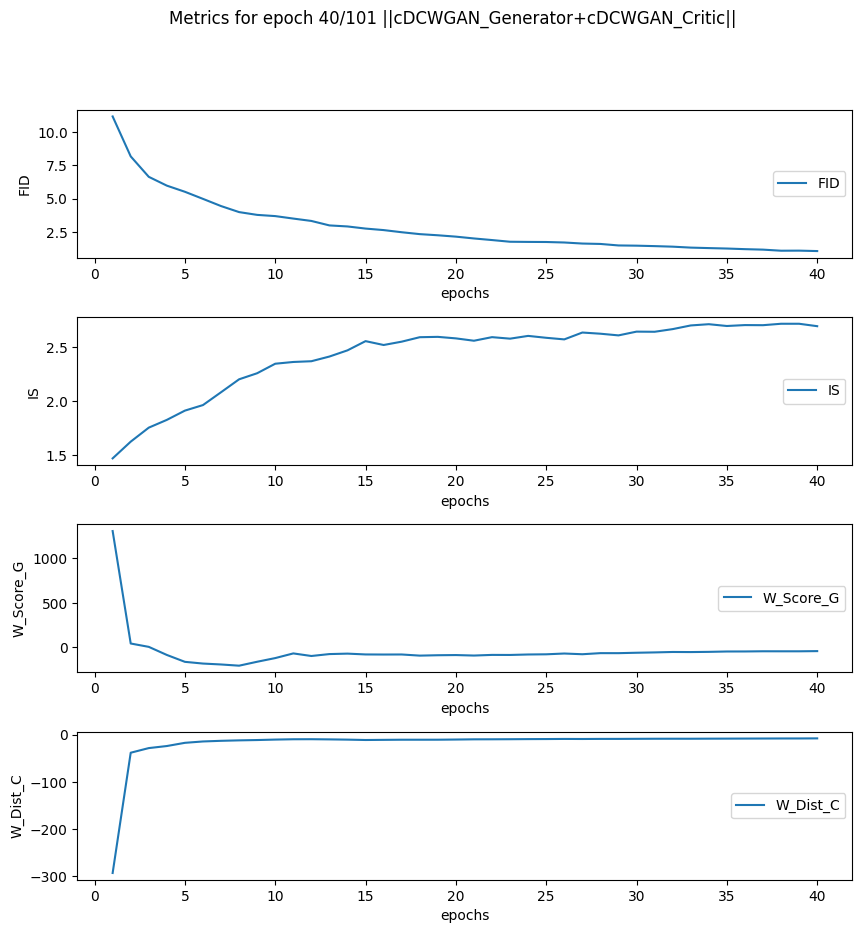

100%|██████████| 2853/2853 [07:50<00:00,  6.07it/s]


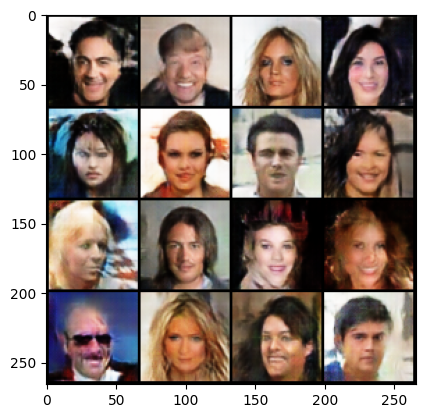

----------
Mean Generator Score: -43.053711614483284
Mean Critic distance: -7.87522719577451
Mean FID (64): 1.073594093322754
Mean IS: 2.7180159091949463
Epoch Time: 7:50


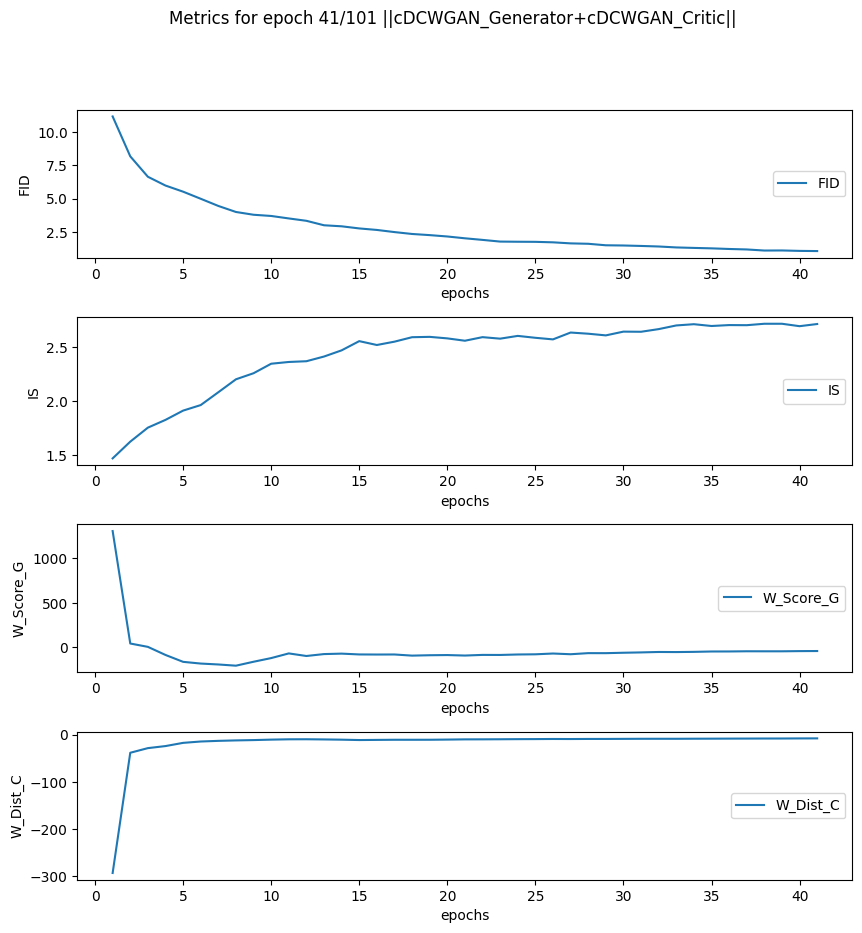

100%|██████████| 2853/2853 [07:49<00:00,  6.07it/s]


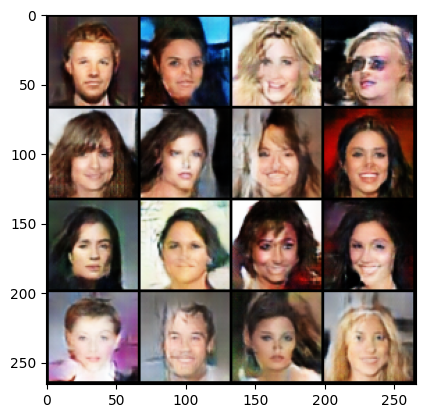

----------
Mean Generator Score: -41.87067260198426
Mean Critic distance: -7.751291207418165
Mean FID (64): 1.040483832359314
Mean IS: 2.720219135284424
Epoch Time: 7:49


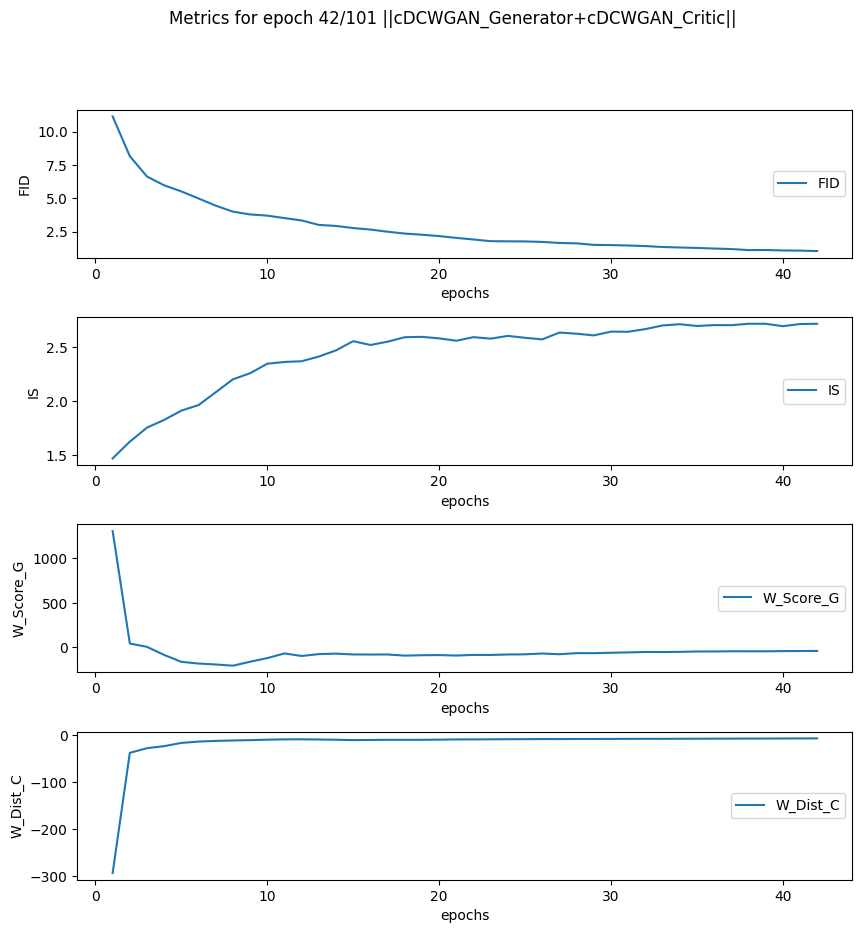

100%|██████████| 2853/2853 [07:50<00:00,  6.07it/s]


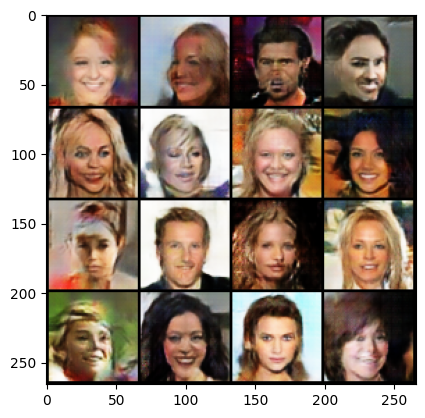

----------
Mean Generator Score: -39.72531804065955
Mean Critic distance: -7.571969046828373
Mean FID (64): 1.0293772220611572
Mean IS: 2.7325687408447266
Epoch Time: 7:50


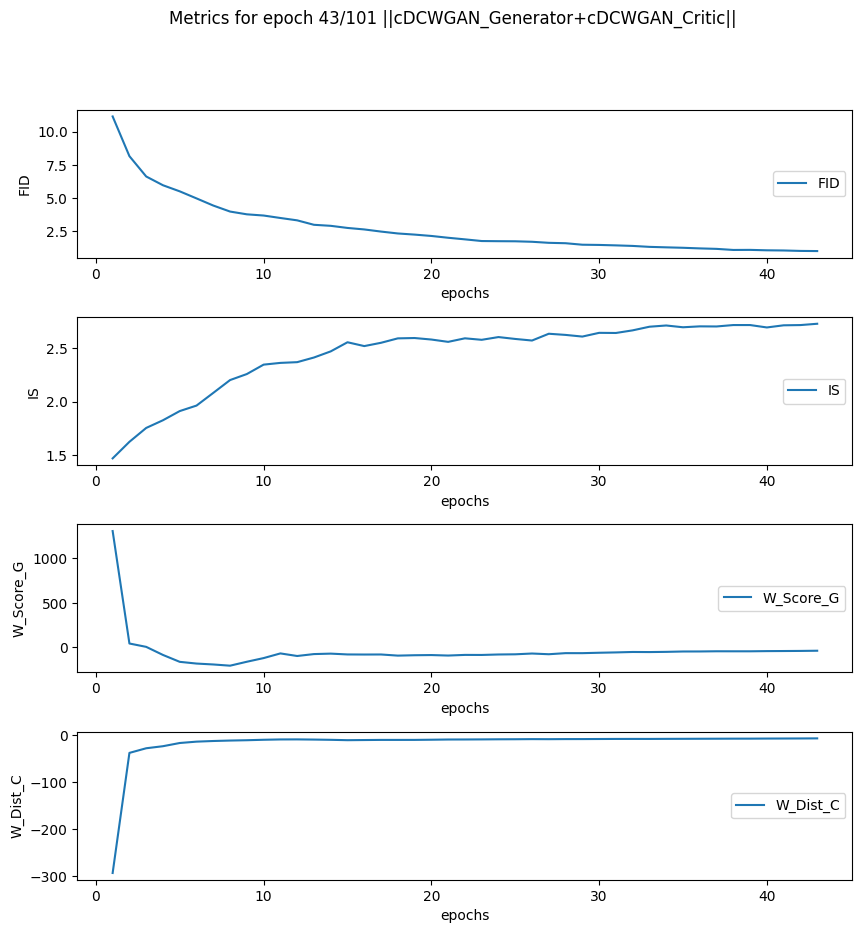

100%|██████████| 2853/2853 [07:50<00:00,  6.07it/s]


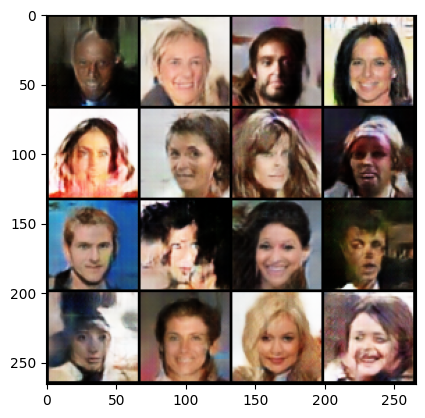

----------
Mean Generator Score: -38.12188566494406
Mean Critic distance: -7.526355252531675
Mean FID (64): 1.0045950412750244
Mean IS: 2.7288691997528076
Epoch Time: 7:50


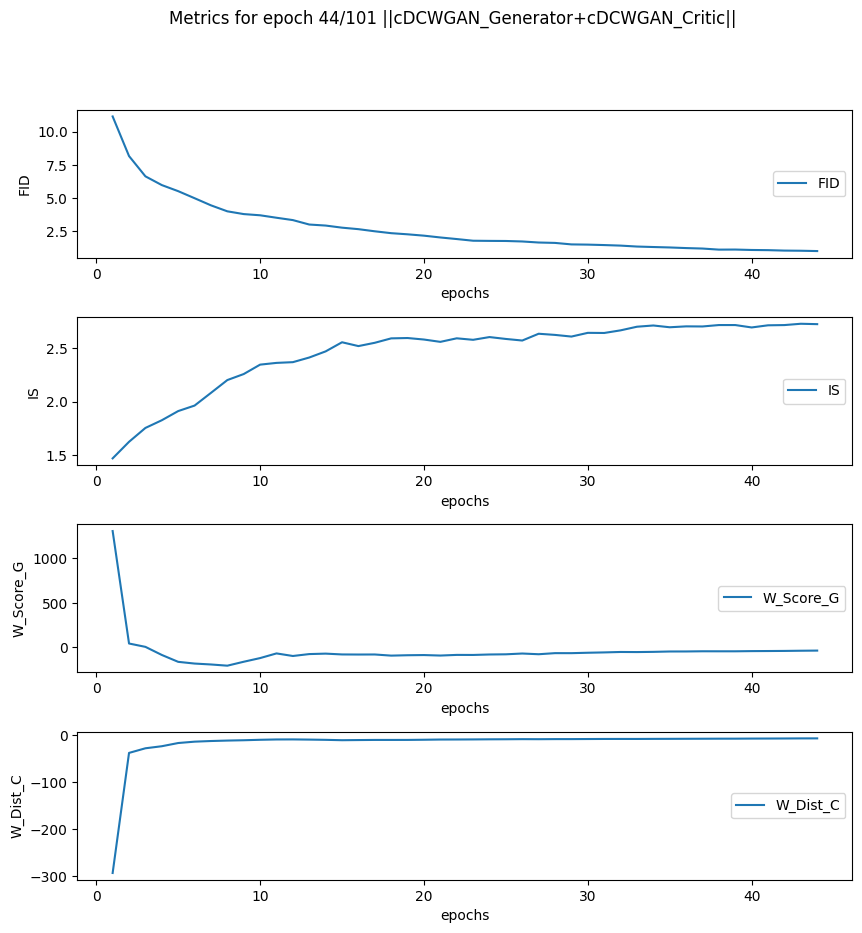

100%|██████████| 2853/2853 [07:49<00:00,  6.07it/s]


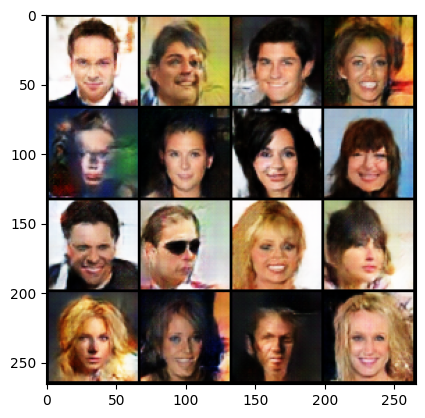

----------
Mean Generator Score: -37.963820533375994
Mean Critic distance: -7.320260973926013
Mean FID (64): 0.9595241546630859
Mean IS: 2.7417590618133545
Epoch Time: 7:49


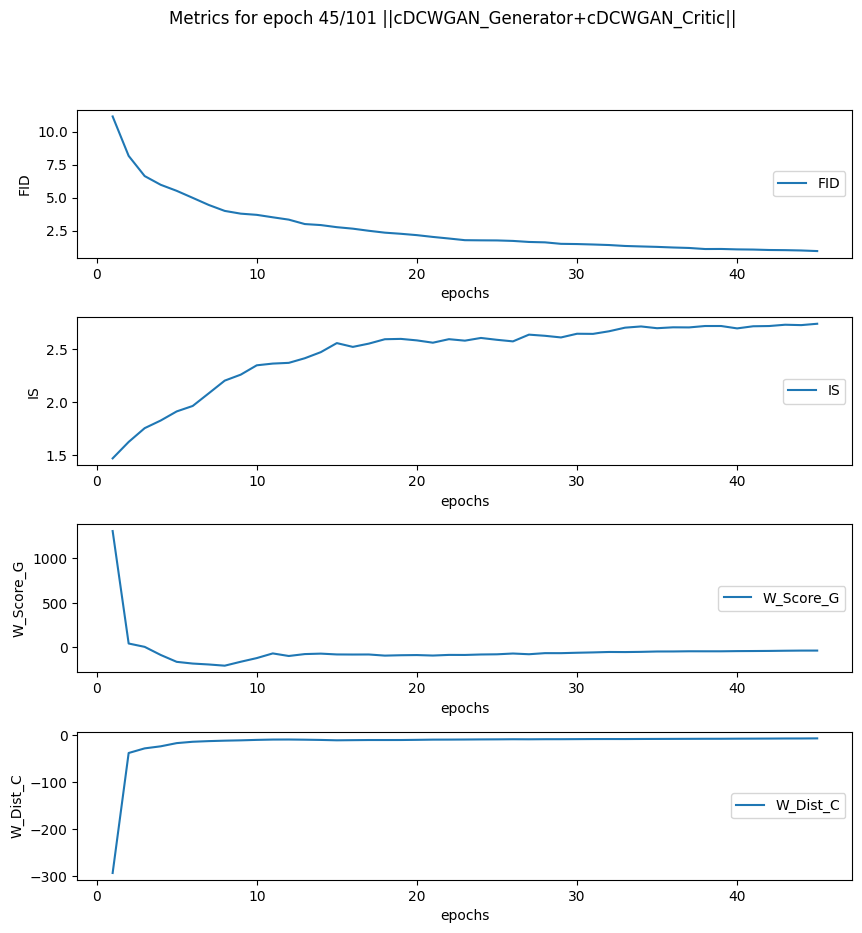

100%|██████████| 2853/2853 [07:49<00:00,  6.07it/s]


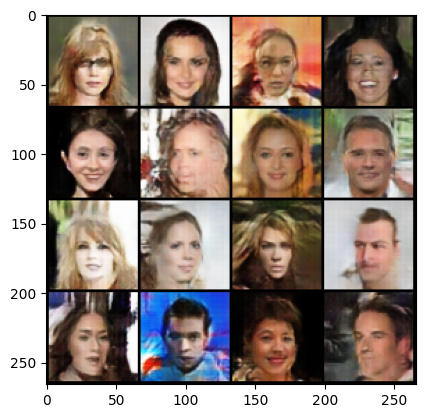

----------
Mean Generator Score: -37.34101427129486
Mean Critic distance: -7.295043870101591
Mean FID (64): 0.9598365426063538
Mean IS: 2.7562031745910645
Epoch Time: 7:49


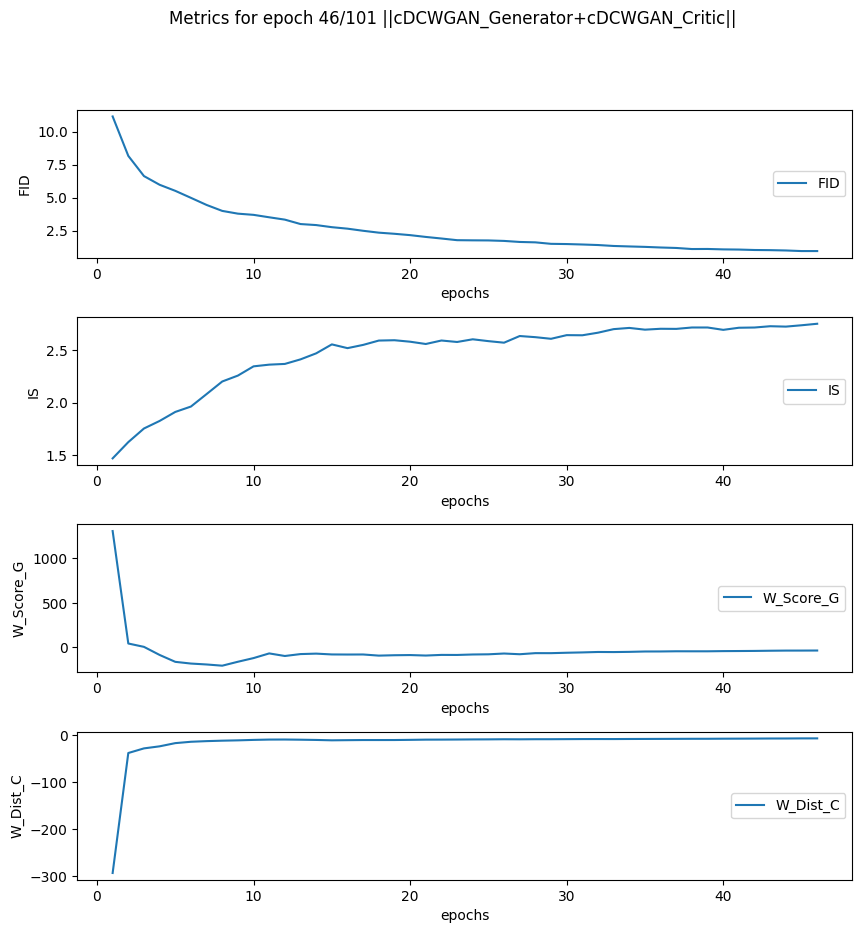

100%|██████████| 2853/2853 [07:49<00:00,  6.07it/s]


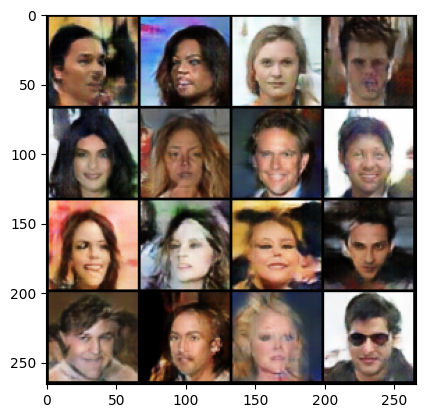

----------
Mean Generator Score: -35.75573063984252
Mean Critic distance: -7.135289725528614
Mean FID (64): 0.9227685928344727
Mean IS: 2.7585644721984863
Epoch Time: 7:49


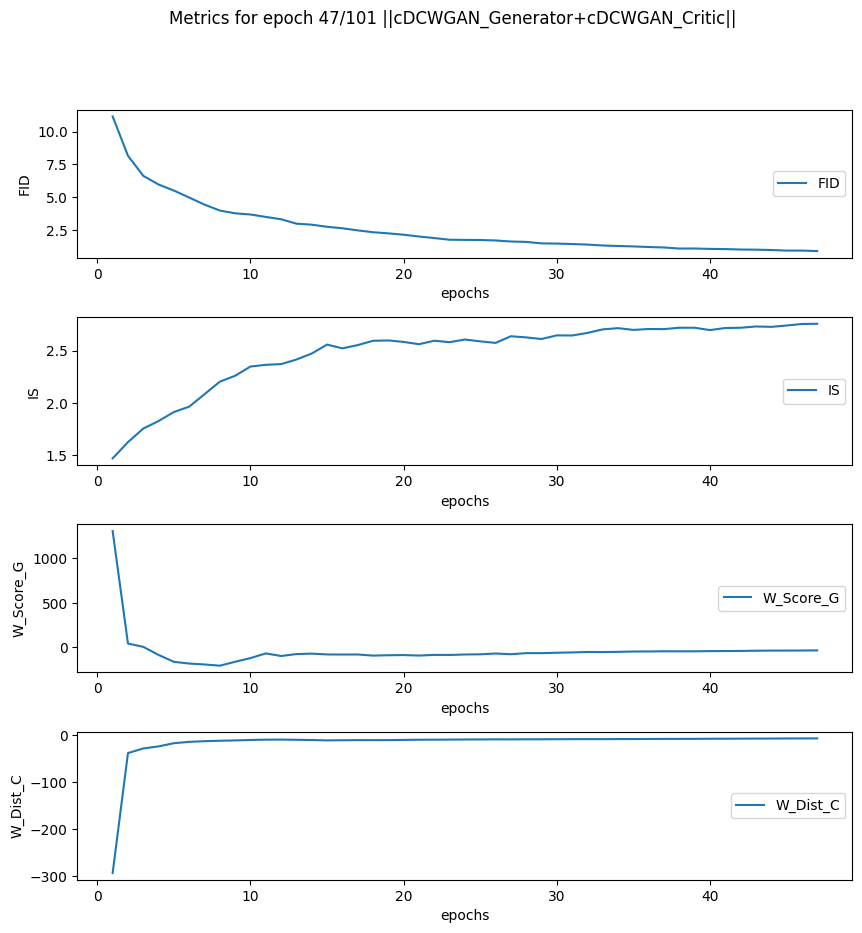

100%|██████████| 2853/2853 [07:49<00:00,  6.07it/s]


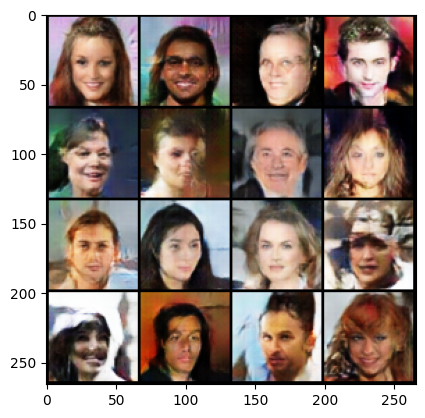

----------
Mean Generator Score: -36.21498617017478
Mean Critic distance: -7.147596486442932
Mean FID (64): 0.9012463688850403
Mean IS: 2.749143123626709
Epoch Time: 7:49


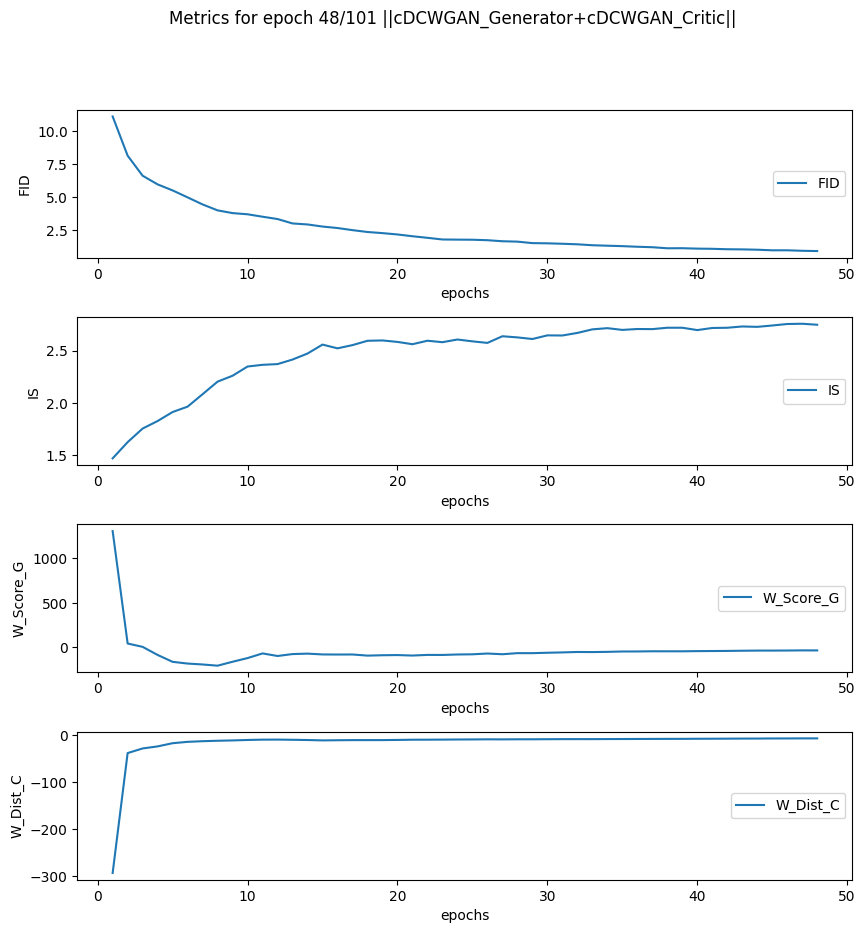

100%|██████████| 2853/2853 [07:49<00:00,  6.07it/s]


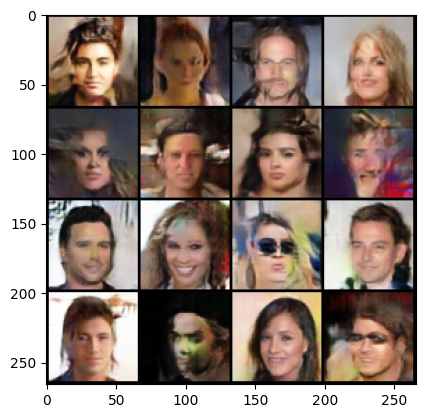

----------
Mean Generator Score: -37.82407220487009
Mean Critic distance: -7.014275005646768
Mean FID (64): 0.8927000761032104
Mean IS: 2.7402284145355225
Epoch Time: 7:49


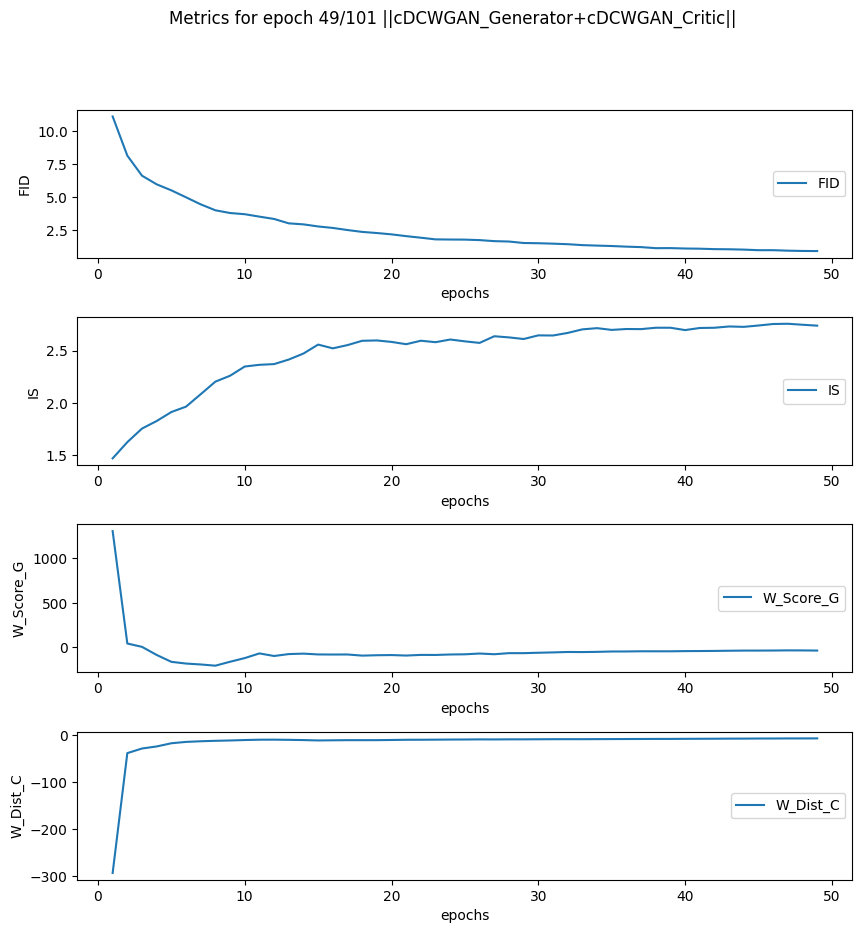

100%|██████████| 2853/2853 [07:49<00:00,  6.07it/s]


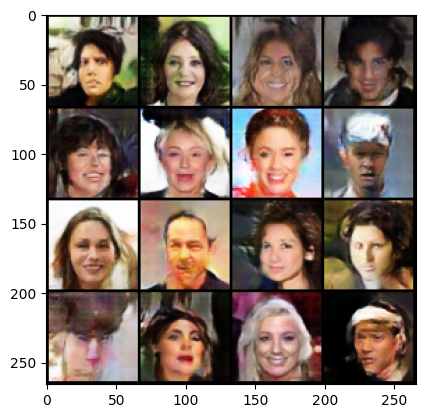

----------
Mean Generator Score: -36.45089134934702
Mean Critic distance: -6.860931113524225
Mean FID (64): 0.8622927069664001
Mean IS: 2.7575080394744873
Epoch Time: 7:50


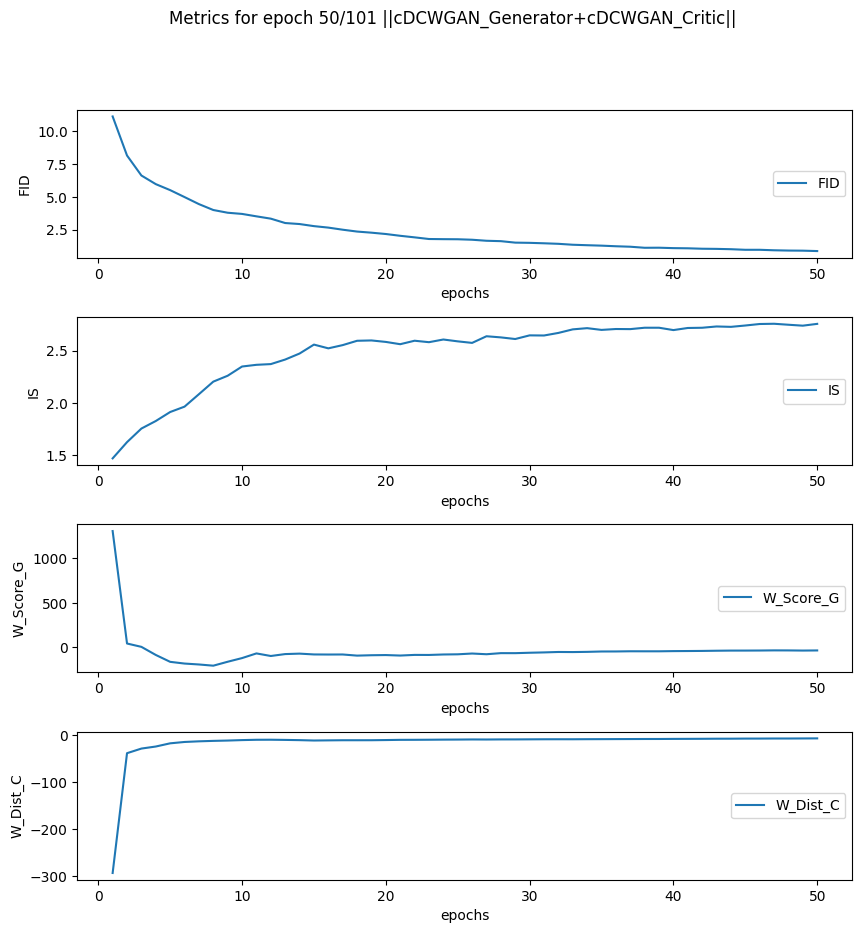

100%|██████████| 2853/2853 [07:50<00:00,  6.06it/s]


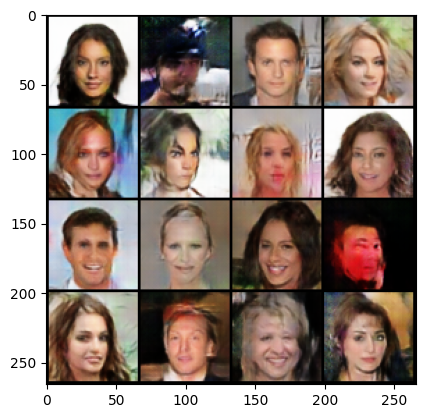

----------
Mean Generator Score: -36.64671273513844
Mean Critic distance: -6.858551363756145
Mean FID (64): 0.8514343500137329
Mean IS: 2.7571754455566406
Epoch Time: 7:50


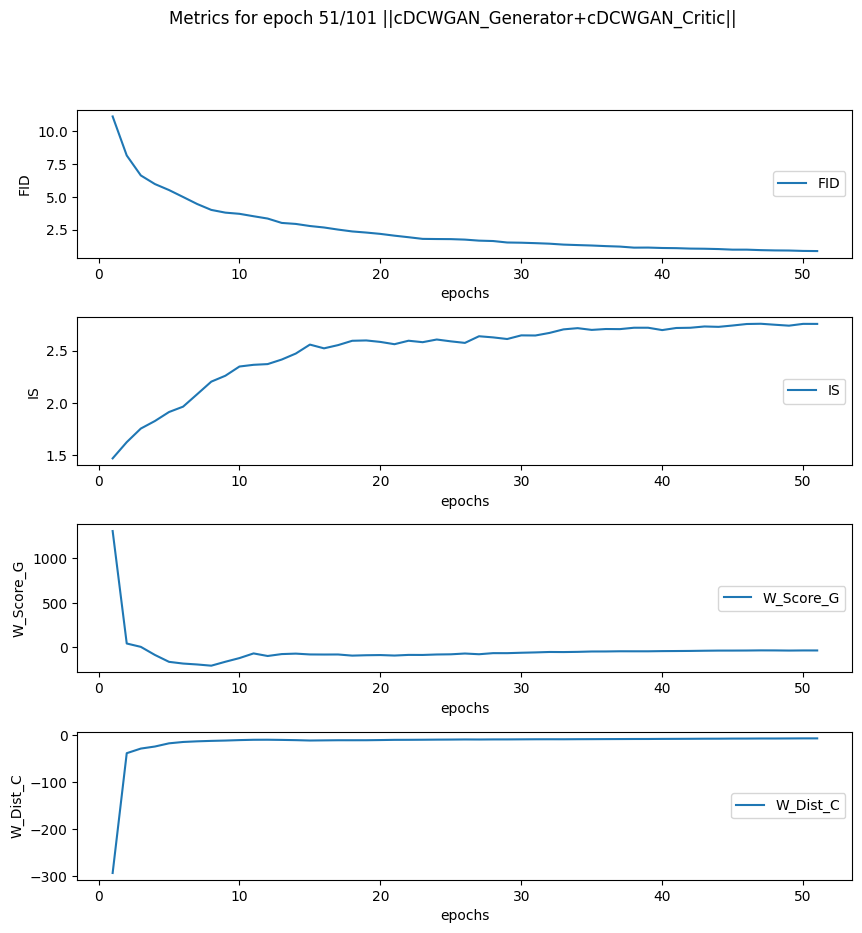

100%|██████████| 2853/2853 [07:49<00:00,  6.07it/s]


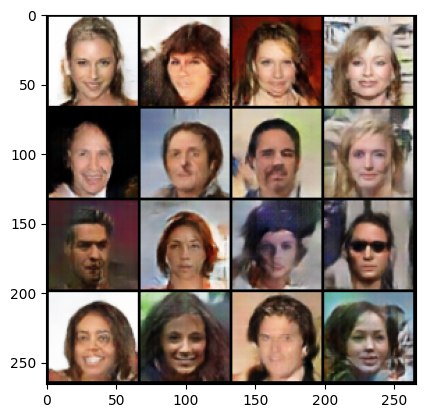

----------
Mean Generator Score: -34.61290815404632
Mean Critic distance: -6.737058884128954
Mean FID (64): 0.8362894058227539
Mean IS: 2.746901035308838
Epoch Time: 7:49


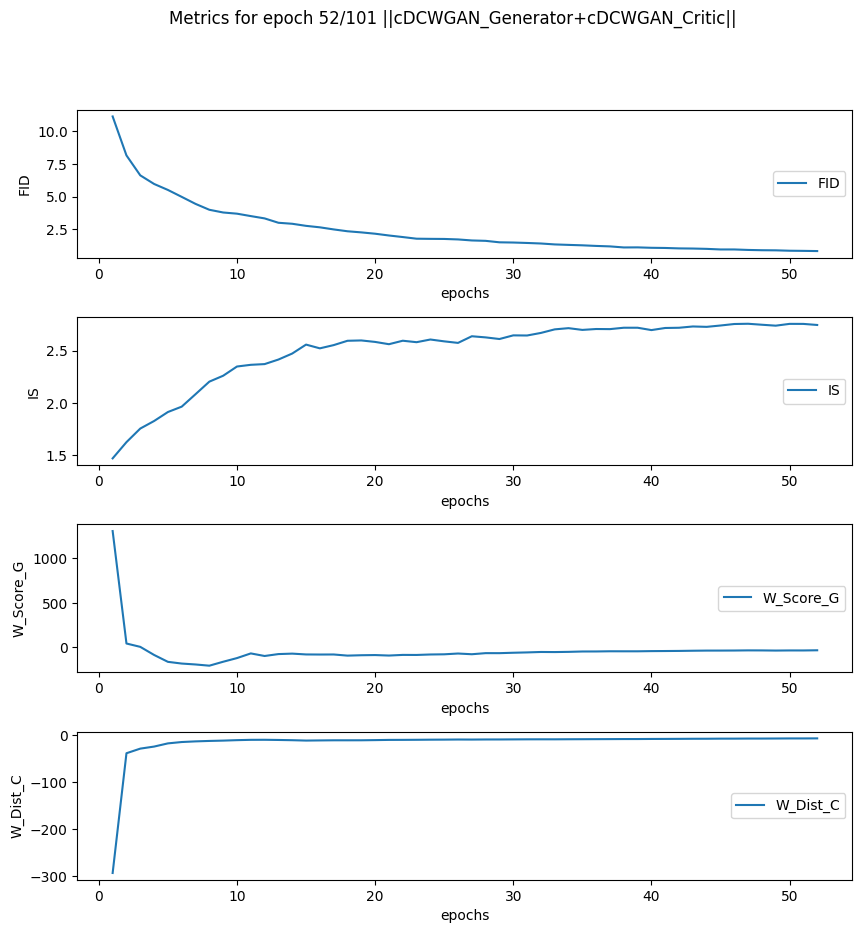

100%|██████████| 2853/2853 [07:49<00:00,  6.07it/s]


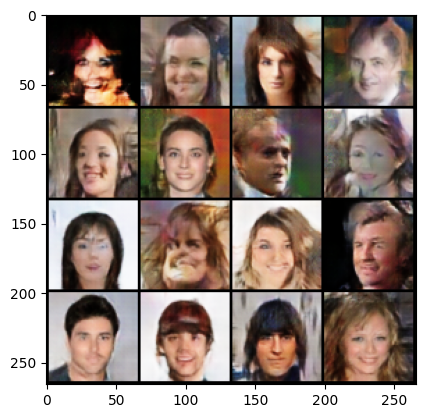

----------
Mean Generator Score: -37.33304242659033
Mean Critic distance: -6.6879358889134854
Mean FID (64): 0.8224688768386841
Mean IS: 2.768437385559082
Epoch Time: 7:49


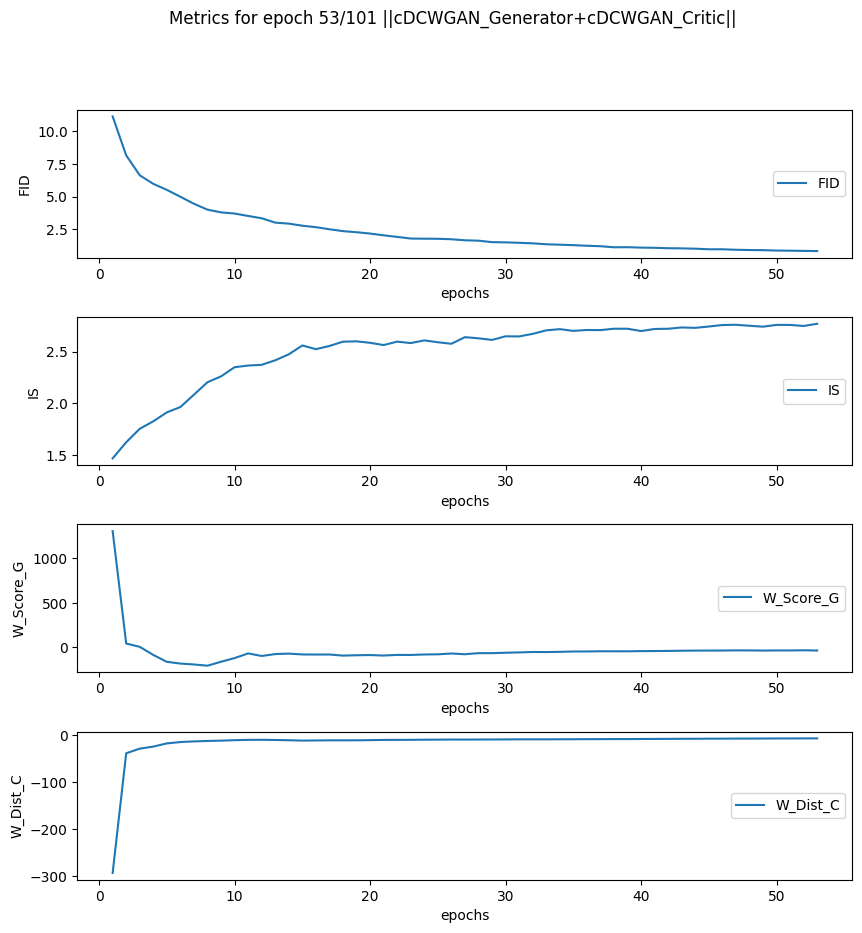

100%|██████████| 2853/2853 [07:49<00:00,  6.07it/s]


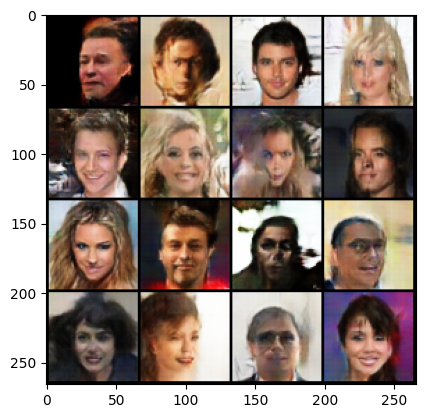

----------
Mean Generator Score: -35.83609298938199
Mean Critic distance: -6.635564157681176
Mean FID (64): 0.774466872215271
Mean IS: 2.7700607776641846
Epoch Time: 7:49


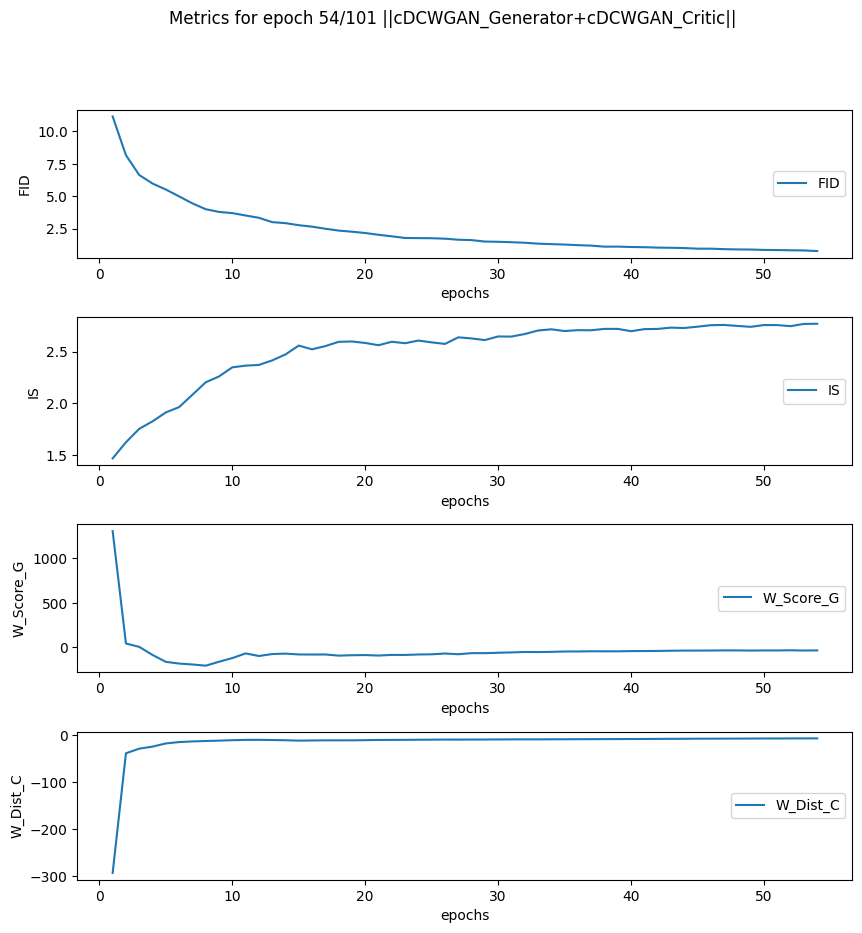

100%|██████████| 2853/2853 [07:49<00:00,  6.07it/s]


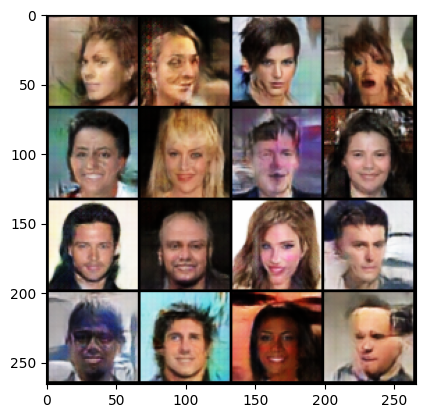

----------
Mean Generator Score: -36.684219415564286
Mean Critic distance: -6.626498412467536
Mean FID (64): 0.7890638113021851
Mean IS: 2.782928228378296
Epoch Time: 7:49


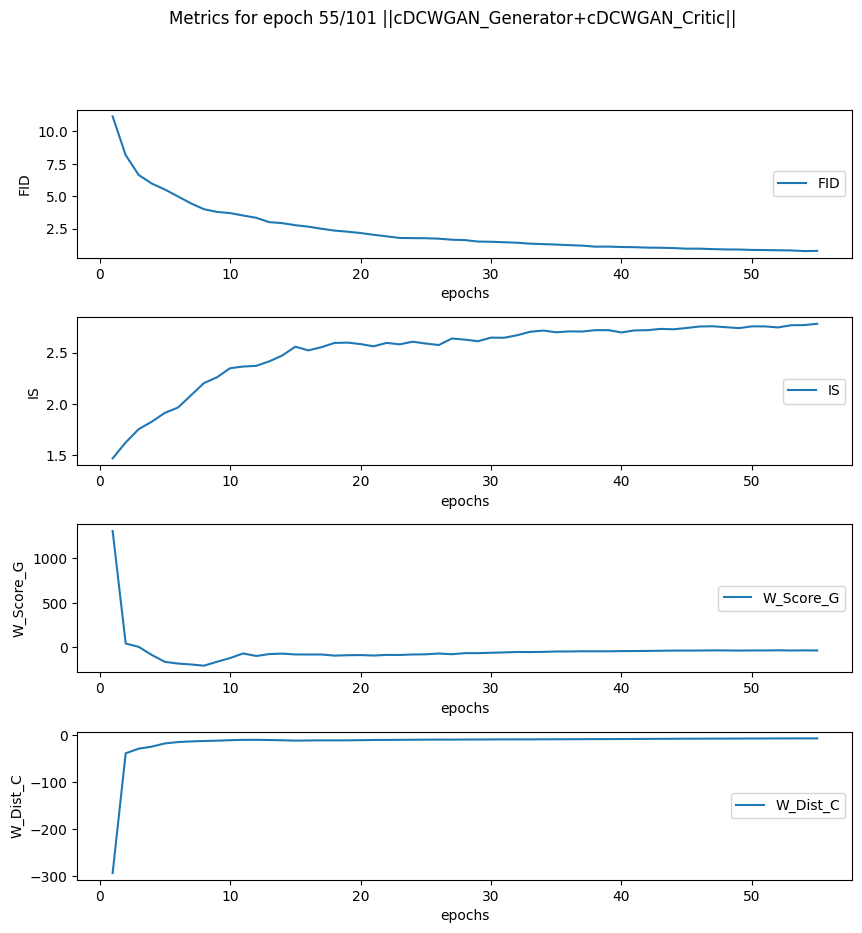

100%|██████████| 2853/2853 [07:49<00:00,  6.07it/s]


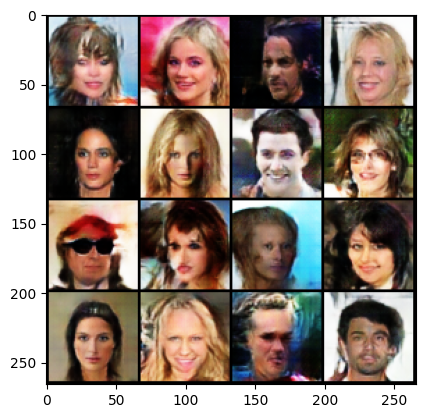

----------
Mean Generator Score: -37.646424225966136
Mean Critic distance: -6.5037633101646835
Mean FID (64): 0.7914541959762573
Mean IS: 2.8032708168029785
Epoch Time: 7:49


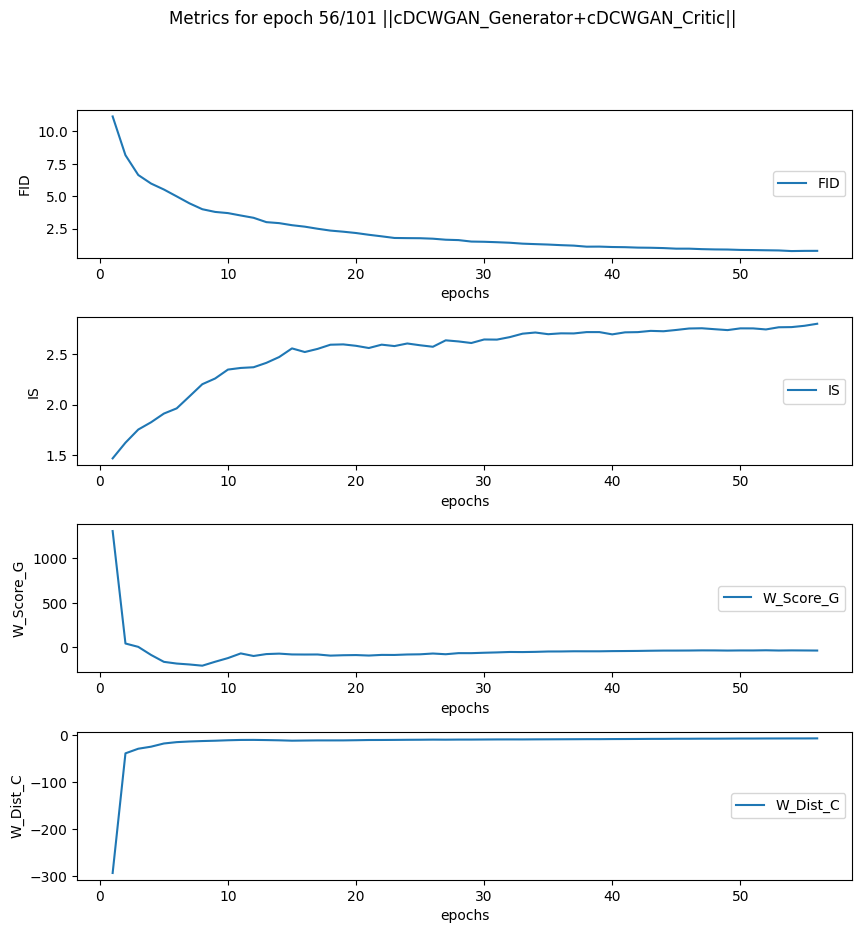

100%|██████████| 2853/2853 [07:49<00:00,  6.07it/s]


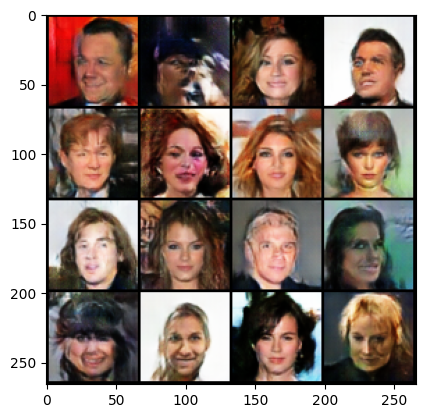

----------
Mean Generator Score: -36.472363115454975
Mean Critic distance: -6.423374280484985
Mean FID (64): 0.7804676294326782
Mean IS: 2.7960867881774902
Epoch Time: 7:49


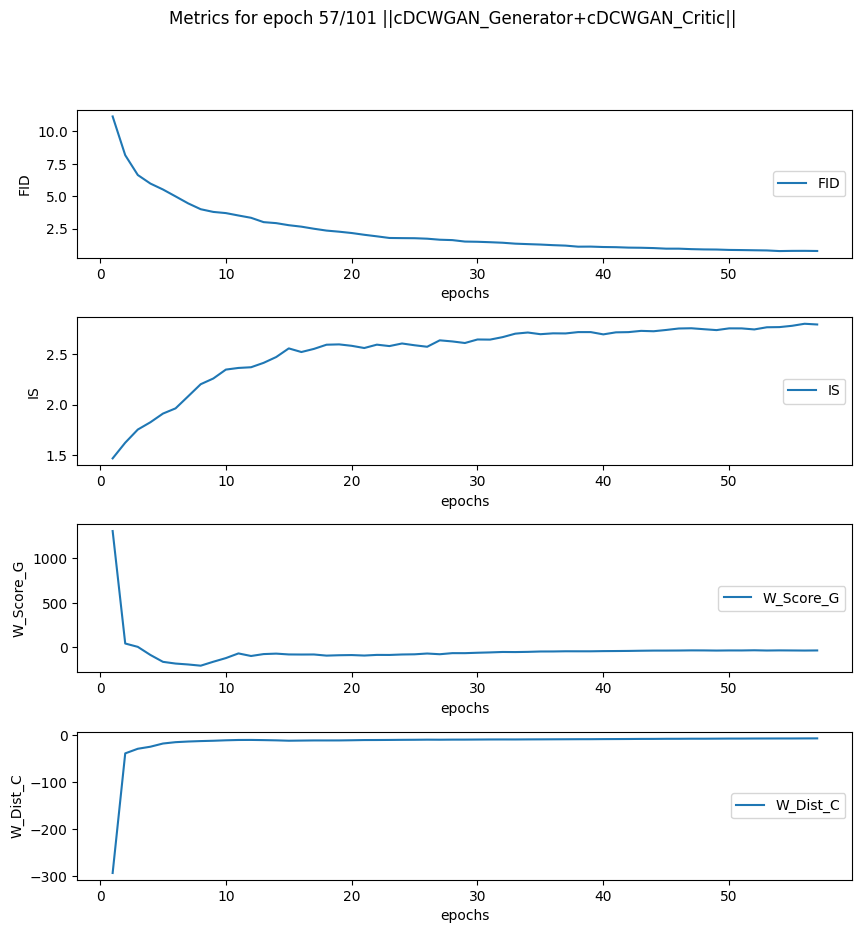

100%|██████████| 2853/2853 [07:49<00:00,  6.07it/s]


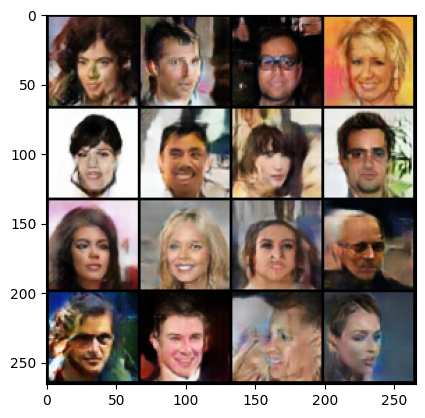

----------
Mean Generator Score: -33.828191513032245
Mean Critic distance: -6.317681614992454
Mean FID (64): 0.776155412197113
Mean IS: 2.8164732456207275
Epoch Time: 7:49


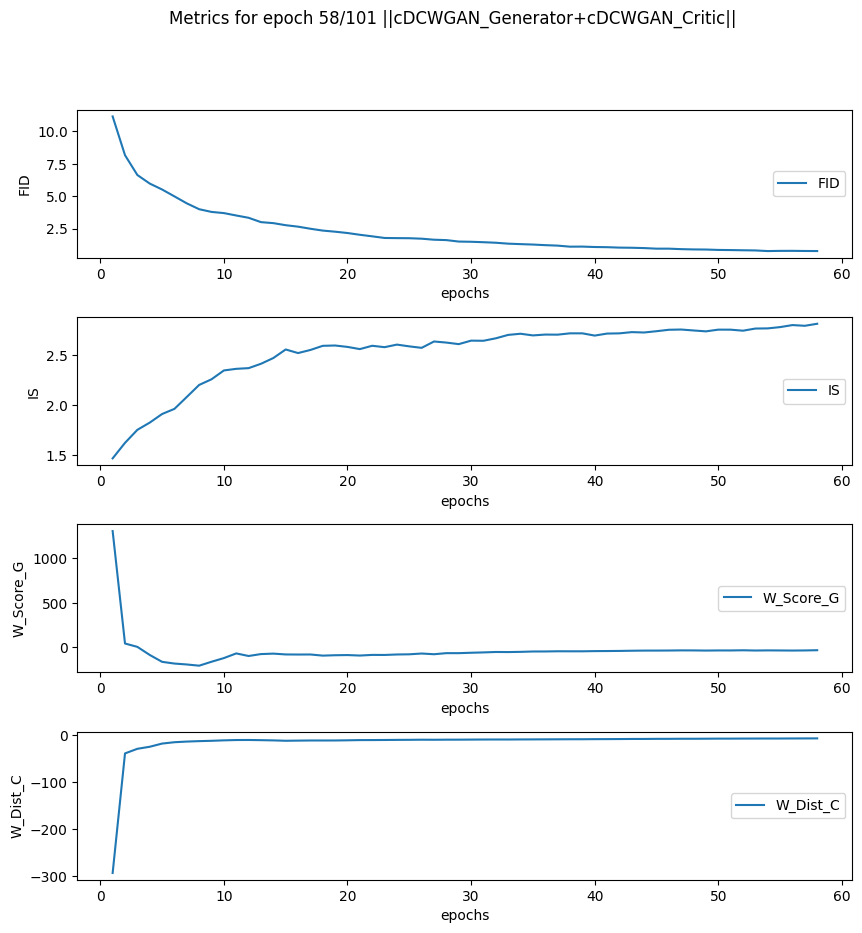

100%|██████████| 2853/2853 [07:49<00:00,  6.07it/s]


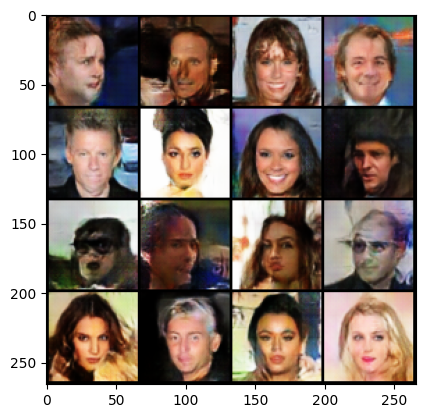

----------
Mean Generator Score: -33.95543143378015
Mean Critic distance: -6.264370205943057
Mean FID (64): 0.7501828670501709
Mean IS: 2.8045895099639893
Epoch Time: 7:49


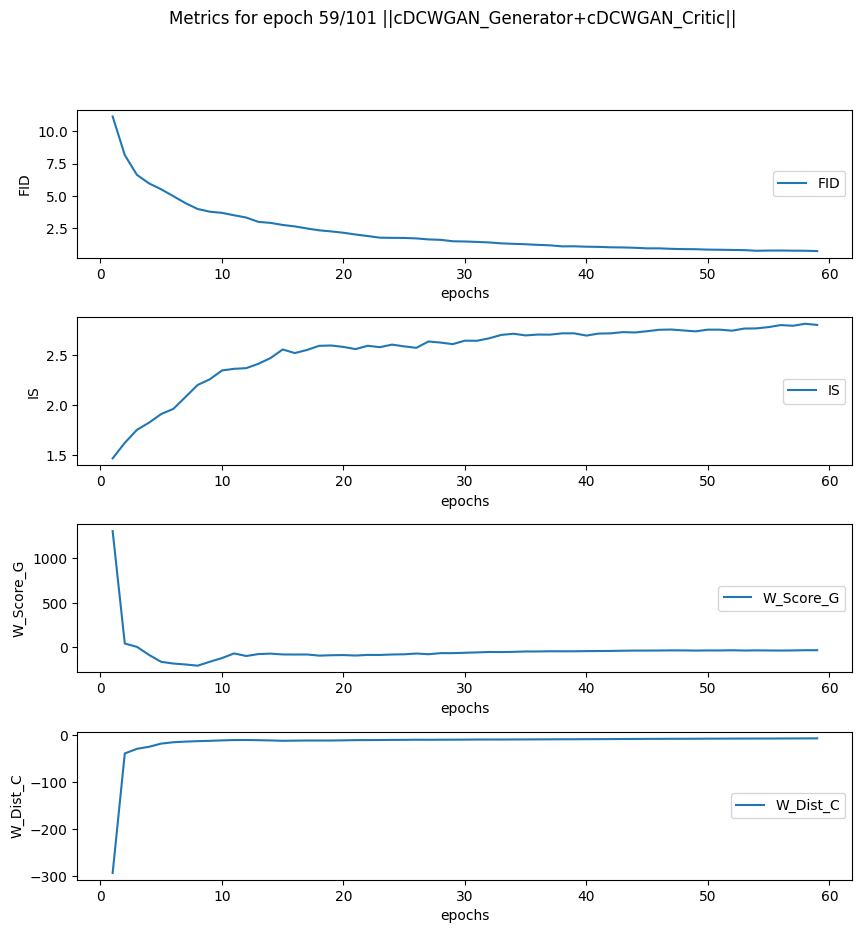

100%|██████████| 2853/2853 [07:49<00:00,  6.07it/s]


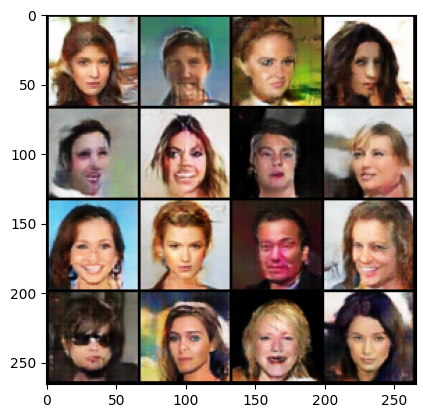

----------
Mean Generator Score: -35.09278396205944
Mean Critic distance: -6.160173886373007
Mean FID (64): 0.7164878249168396
Mean IS: 2.802598714828491
Epoch Time: 7:49


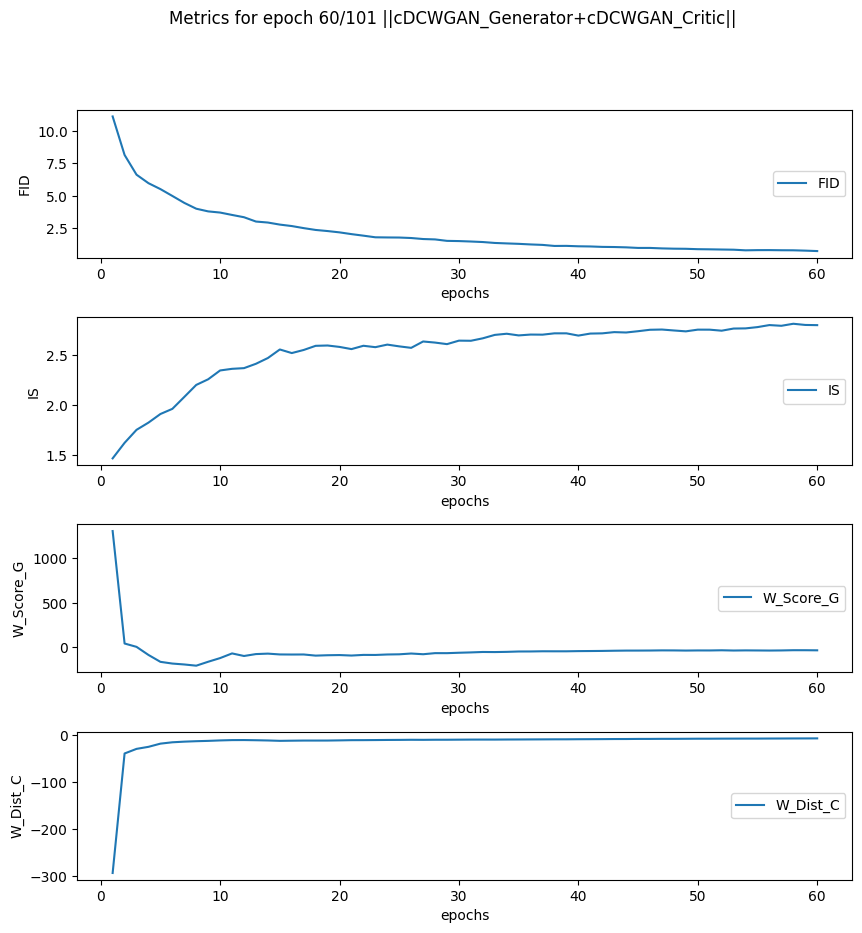

100%|██████████| 2853/2853 [07:49<00:00,  6.07it/s]


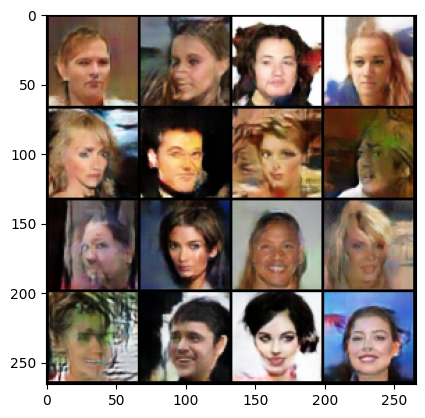

----------
Mean Generator Score: -35.08440932579208
Mean Critic distance: -6.084962016024424
Mean FID (64): 0.7100857496261597
Mean IS: 2.829470634460449
Epoch Time: 7:49


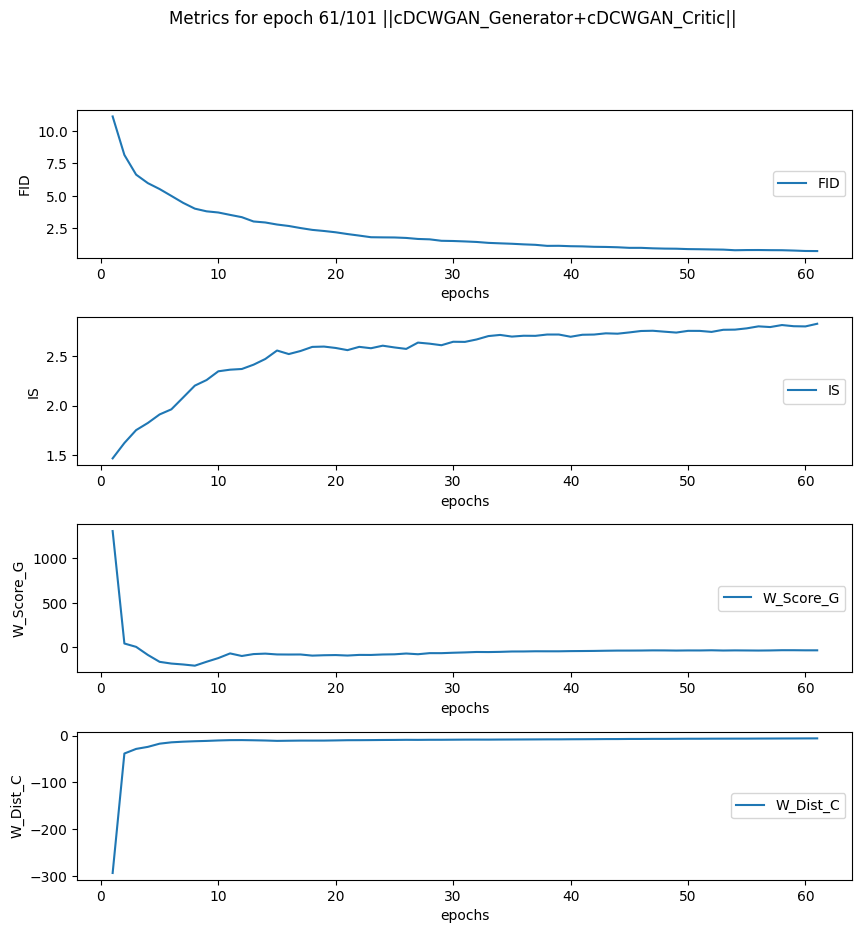

100%|██████████| 2853/2853 [07:49<00:00,  6.07it/s]


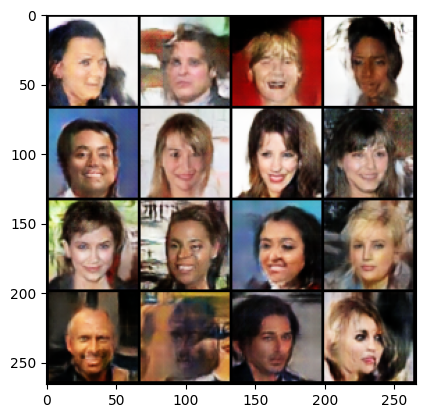

----------
Mean Generator Score: -36.07267245190185
Mean Critic distance: -6.115135784780941
Mean FID (64): 0.7093738913536072
Mean IS: 2.8430848121643066
Epoch Time: 7:49


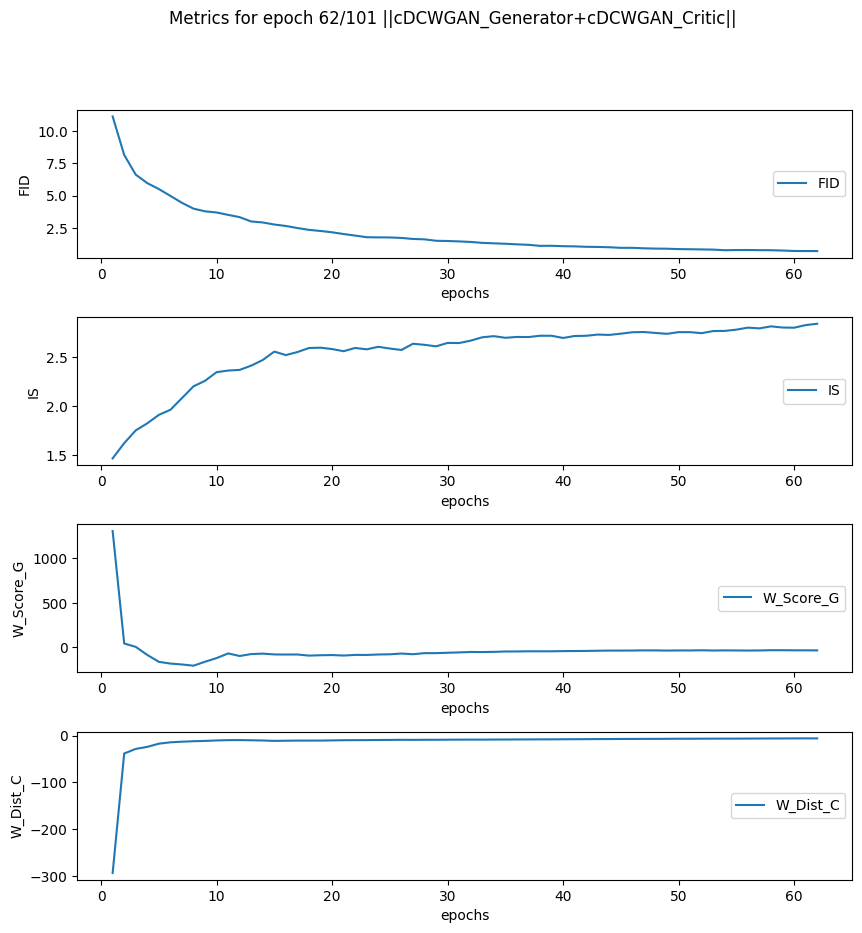

100%|██████████| 2853/2853 [07:49<00:00,  6.07it/s]


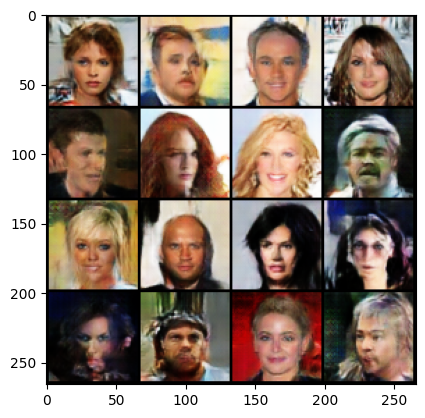

----------
Mean Generator Score: -33.22183498734968
Mean Critic distance: -6.040842937161285
Mean FID (64): 0.7060814499855042
Mean IS: 2.8437705039978027
Epoch Time: 7:49


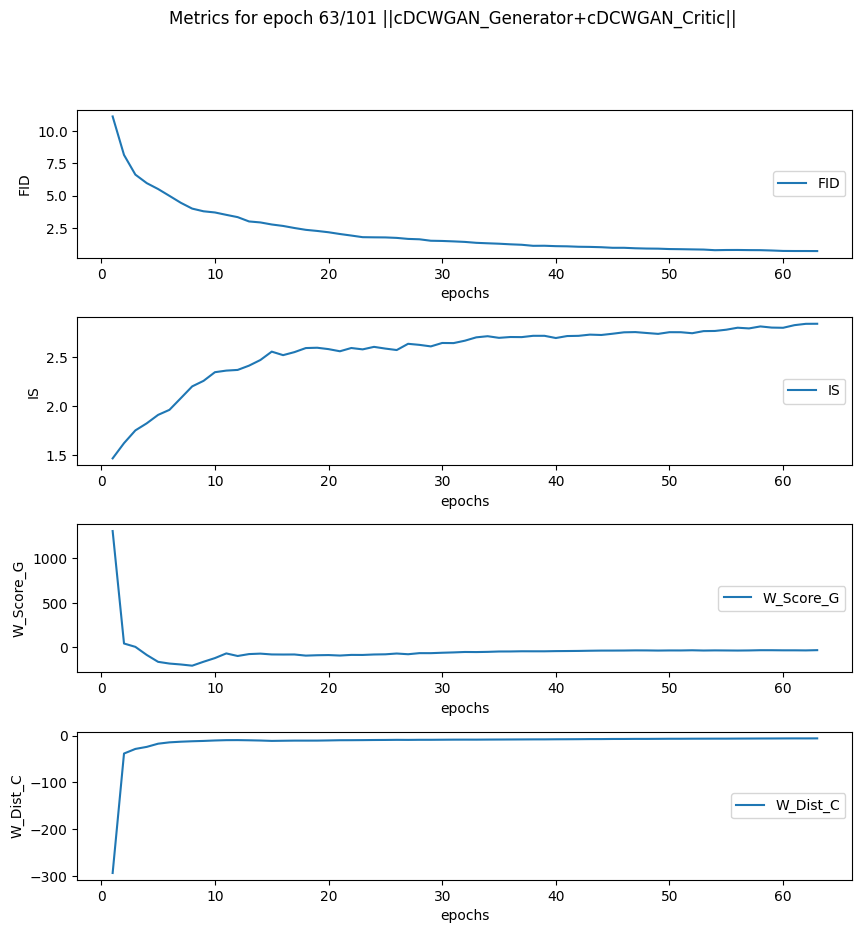

100%|██████████| 2853/2853 [07:49<00:00,  6.08it/s]


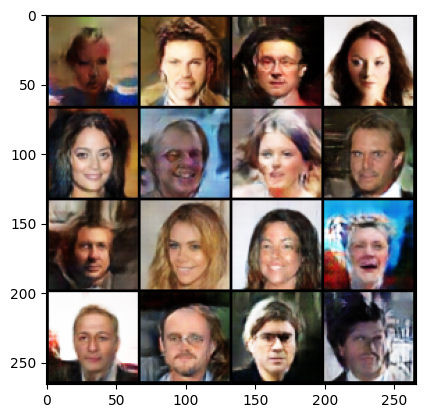

----------
Mean Generator Score: -34.542571100958604
Mean Critic distance: -5.998161559517744
Mean FID (64): 0.7074292302131653
Mean IS: 2.846296787261963
Epoch Time: 7:49


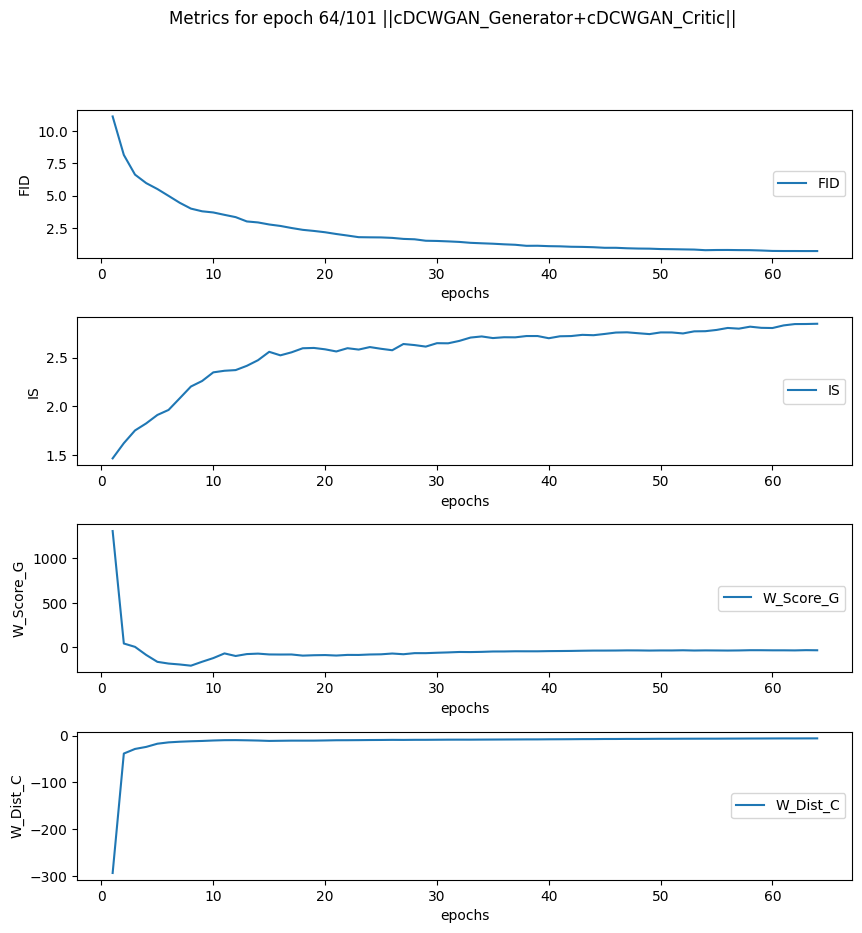

100%|██████████| 2853/2853 [07:49<00:00,  6.07it/s]


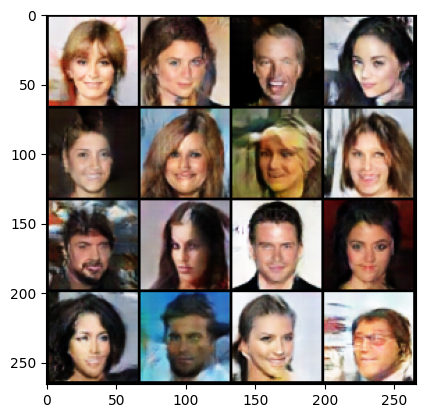

----------
Mean Generator Score: -36.961863712365165
Mean Critic distance: -5.931828977683114
Mean FID (64): 0.693697988986969
Mean IS: 2.8408446311950684
Epoch Time: 7:49


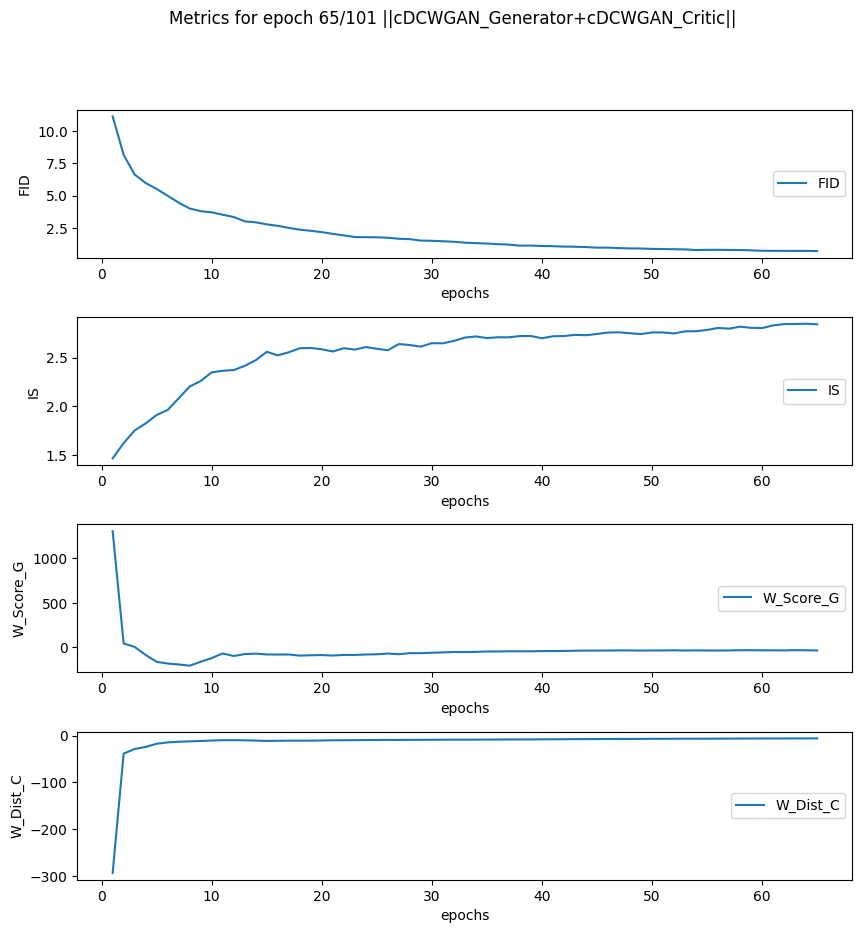

100%|██████████| 2853/2853 [07:49<00:00,  6.08it/s]


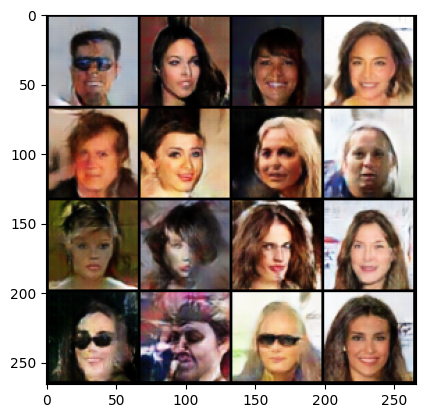

----------
Mean Generator Score: -34.82612910417088
Mean Critic distance: -5.851091403606855
Mean FID (64): 0.6725714206695557
Mean IS: 2.8574256896972656
Epoch Time: 7:49


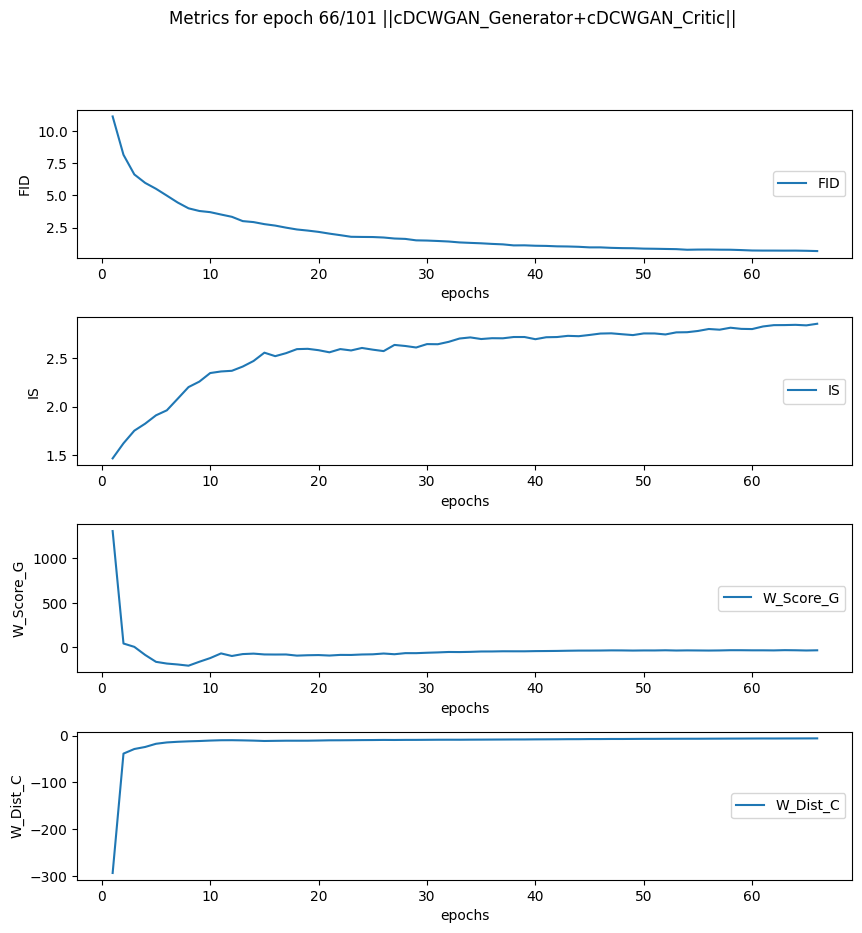

100%|██████████| 2853/2853 [07:49<00:00,  6.07it/s]


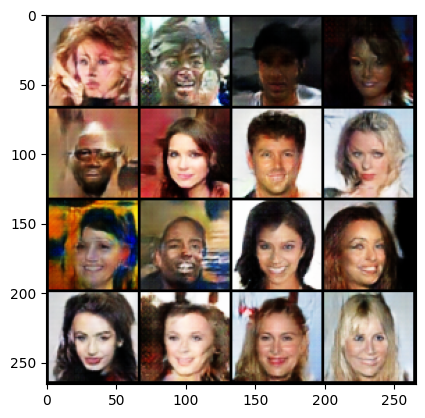

----------
Mean Generator Score: -34.88675636094913
Mean Critic distance: -5.799361387470752
Mean FID (64): 0.6612444519996643
Mean IS: 2.8709235191345215
Epoch Time: 7:49


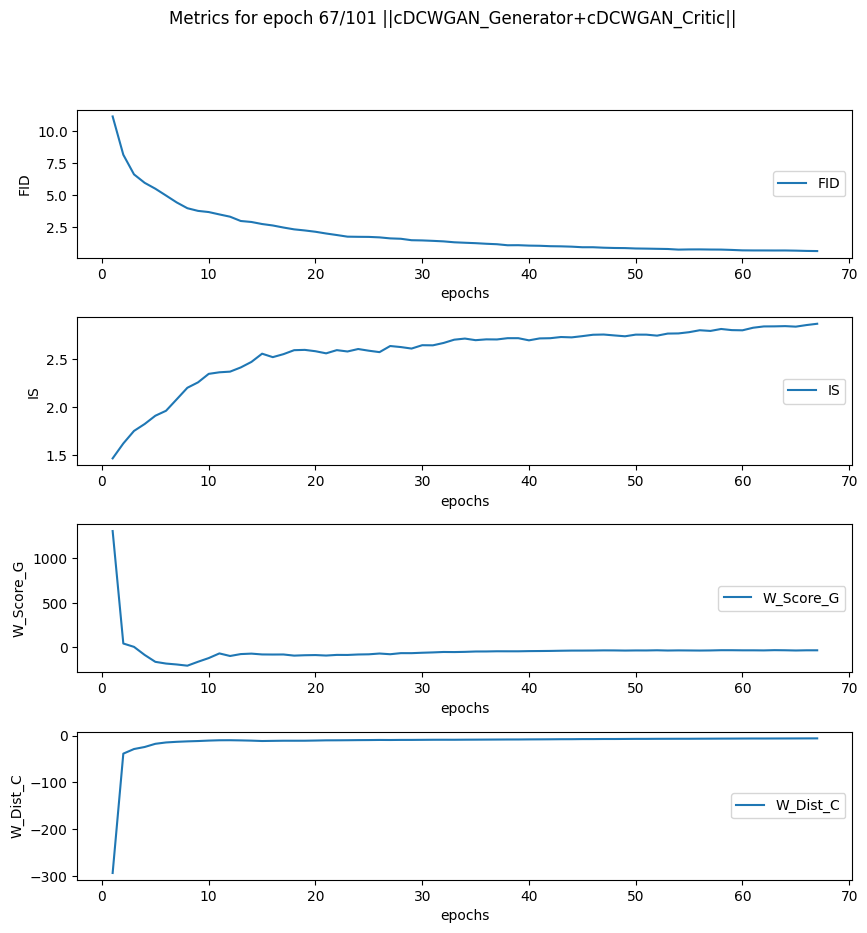

100%|██████████| 2853/2853 [07:49<00:00,  6.07it/s]


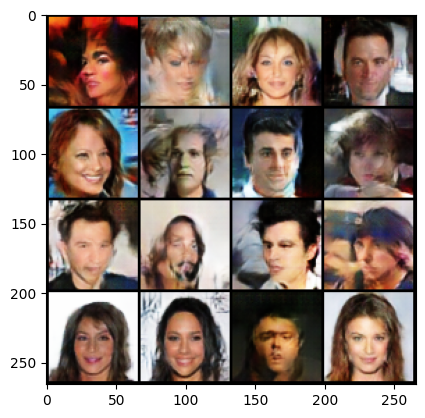

----------
Mean Generator Score: -33.84668819360566
Mean Critic distance: -5.762599644558997
Mean FID (64): 0.6634808778762817
Mean IS: 2.867112159729004
Epoch Time: 7:49


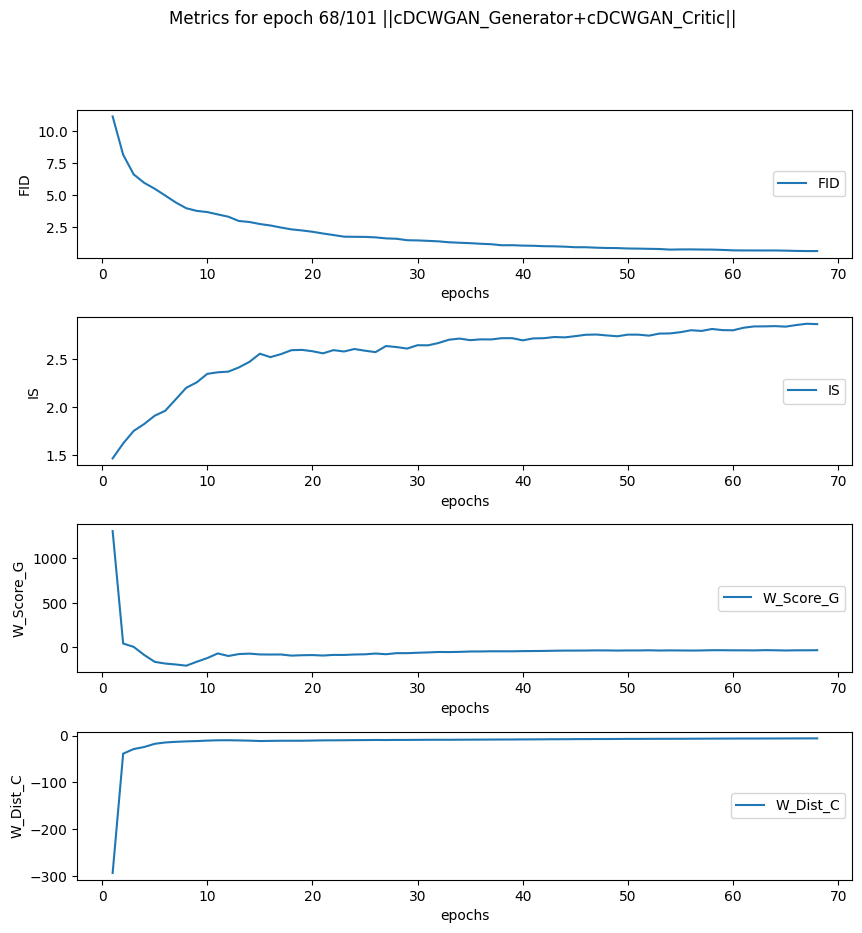

100%|██████████| 2853/2853 [07:49<00:00,  6.08it/s]


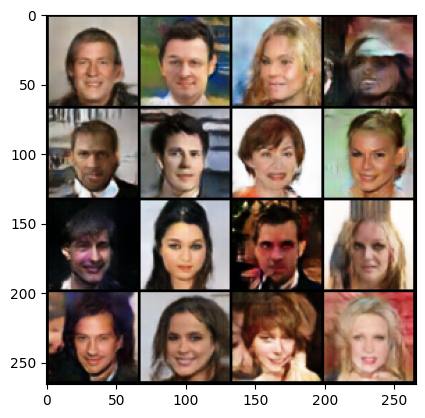

----------
Mean Generator Score: -34.57664705975014
Mean Critic distance: -5.6961068068309455
Mean FID (64): 0.6518006920814514
Mean IS: 2.8717777729034424
Epoch Time: 7:49


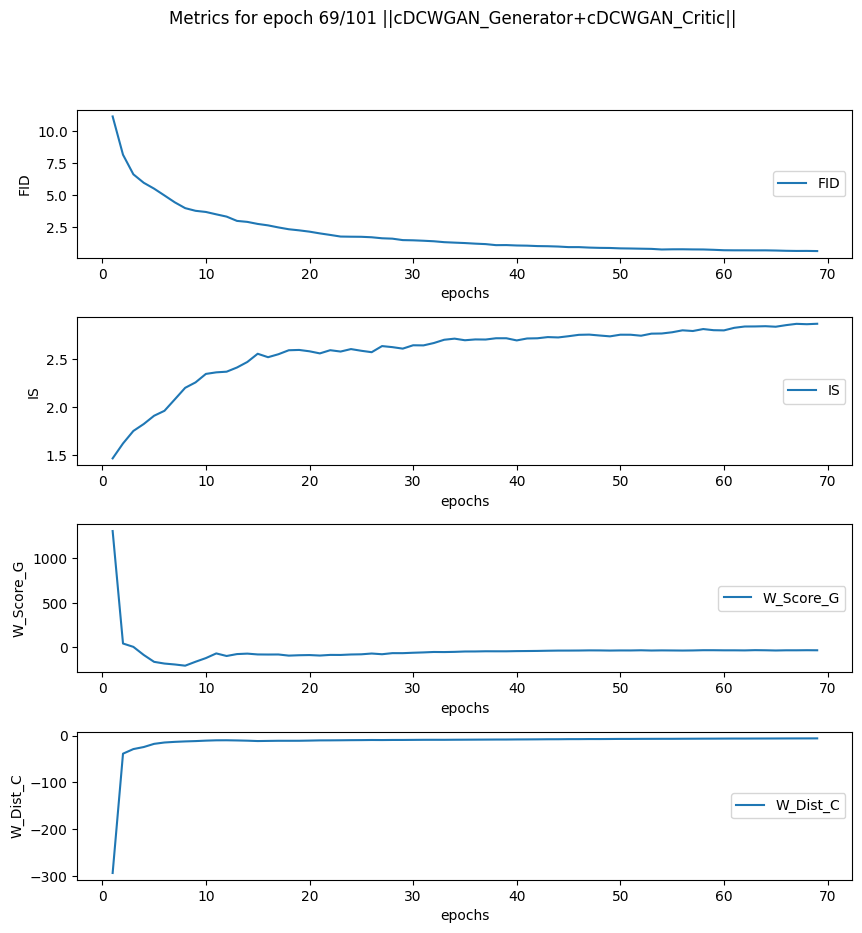

100%|██████████| 2853/2853 [07:49<00:00,  6.07it/s]


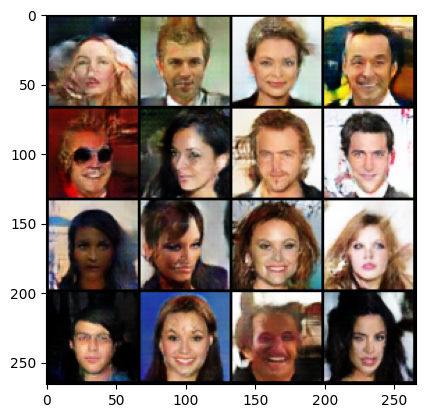

----------
Mean Generator Score: -35.092918402662406
Mean Critic distance: -5.677088635618796
Mean FID (64): 0.657566249370575
Mean IS: 2.8752503395080566
Epoch Time: 7:49


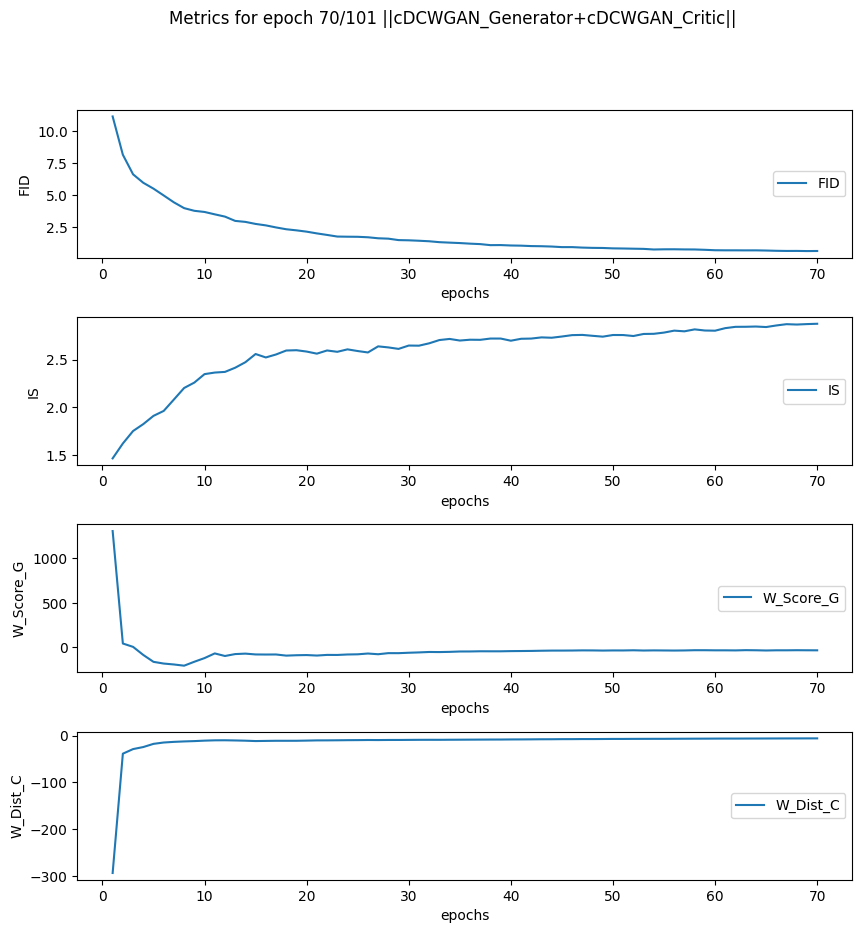

100%|██████████| 2853/2853 [07:49<00:00,  6.07it/s]


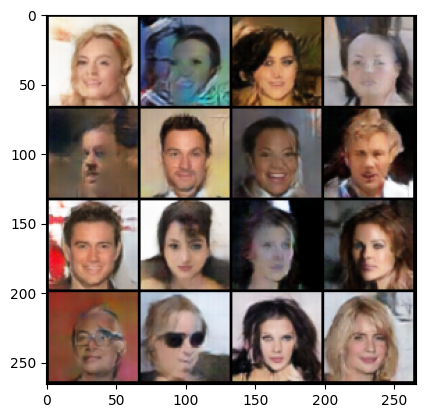

----------
Mean Generator Score: -32.86144624493624
Mean Critic distance: -5.604488359181203
Mean FID (64): 0.6411805152893066
Mean IS: 2.888688802719116
Epoch Time: 7:49


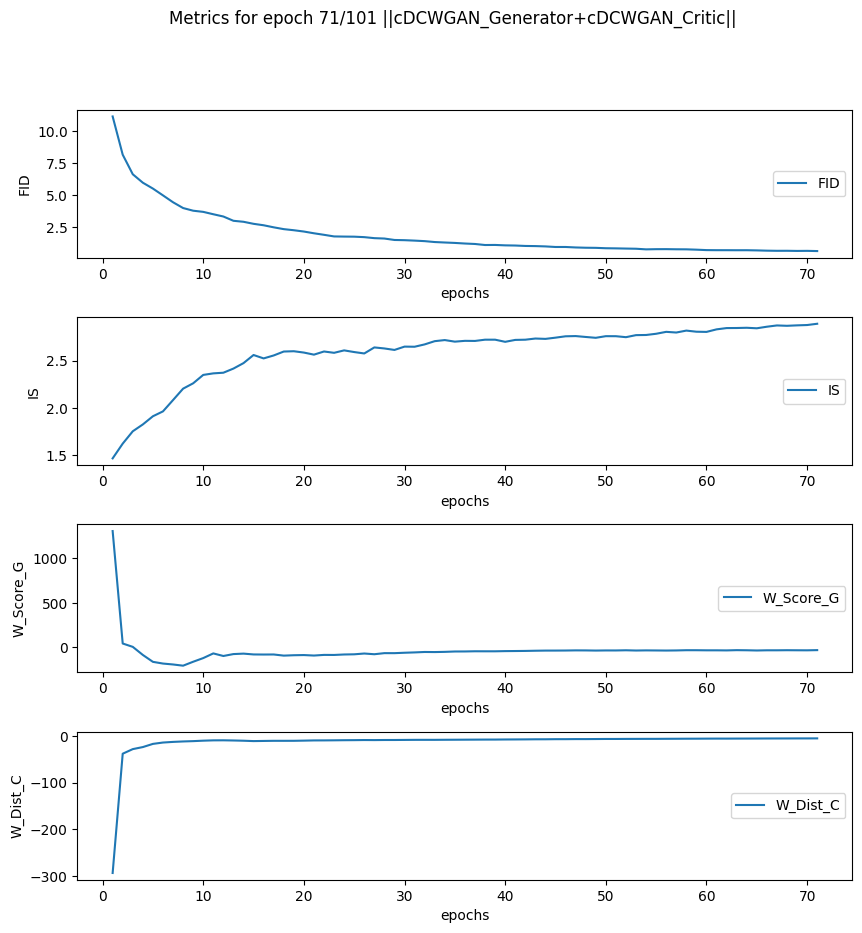

100%|██████████| 2853/2853 [07:49<00:00,  6.08it/s]


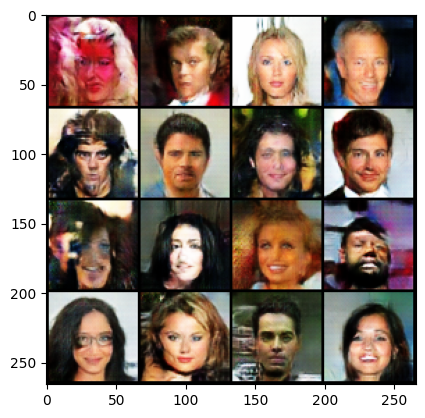

----------
Mean Generator Score: -34.00677911843124
Mean Critic distance: -5.573960906532493
Mean FID (64): 0.6467837691307068
Mean IS: 2.8956210613250732
Epoch Time: 7:49


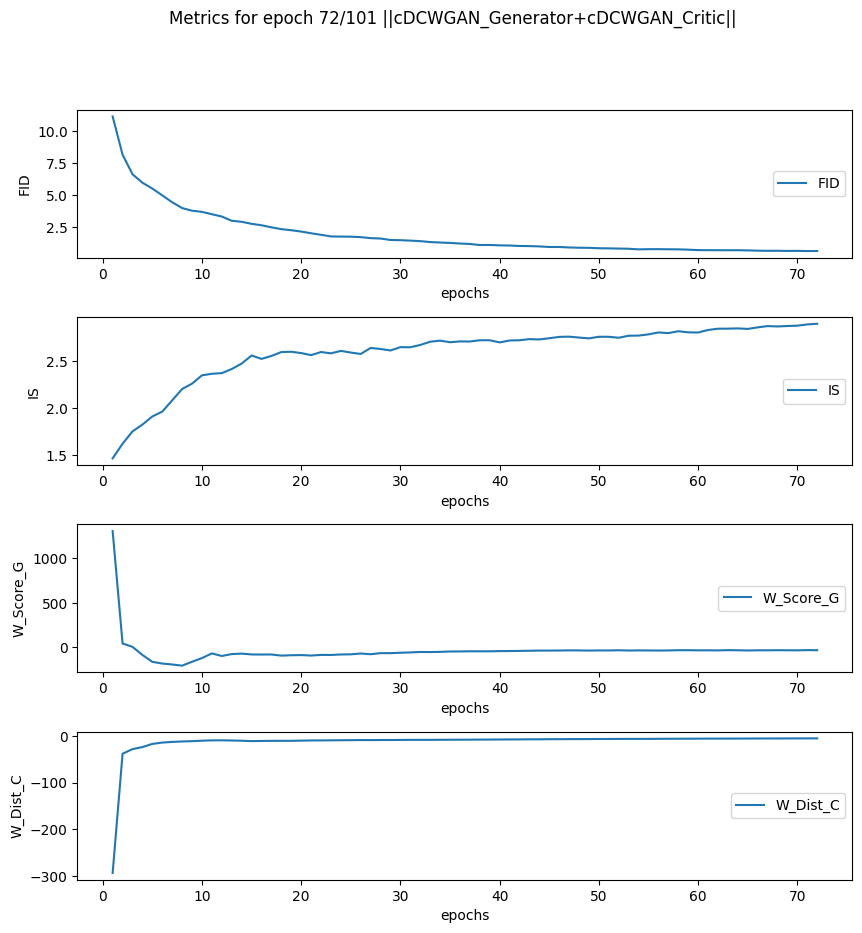

100%|██████████| 2853/2853 [07:49<00:00,  6.08it/s]


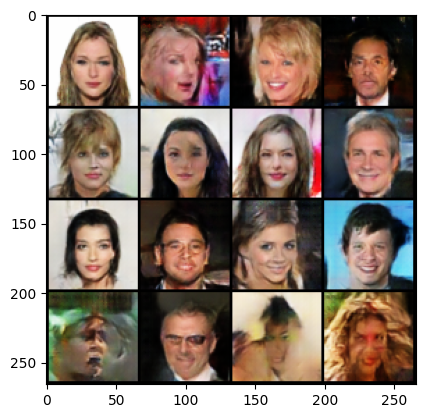

----------
Mean Generator Score: -32.10241022408009
Mean Critic distance: -5.5116063817275265
Mean FID (64): 0.6531911492347717
Mean IS: 2.878878116607666
Epoch Time: 7:49


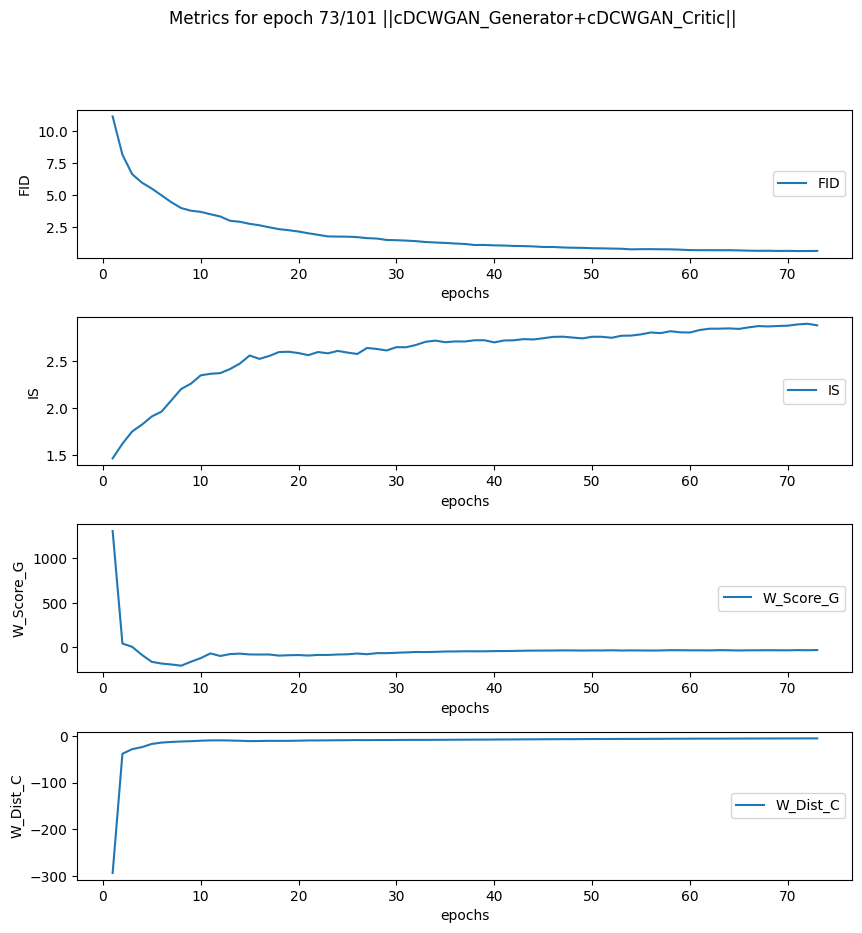

100%|██████████| 2853/2853 [07:49<00:00,  6.08it/s]


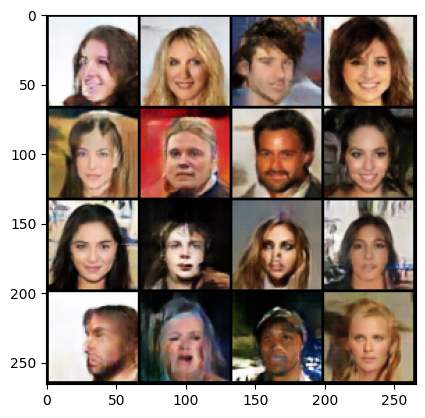

----------
Mean Generator Score: -33.72223192855977
Mean Critic distance: -5.414709435903186
Mean FID (64): 0.6501428484916687
Mean IS: 2.8898367881774902
Epoch Time: 7:49


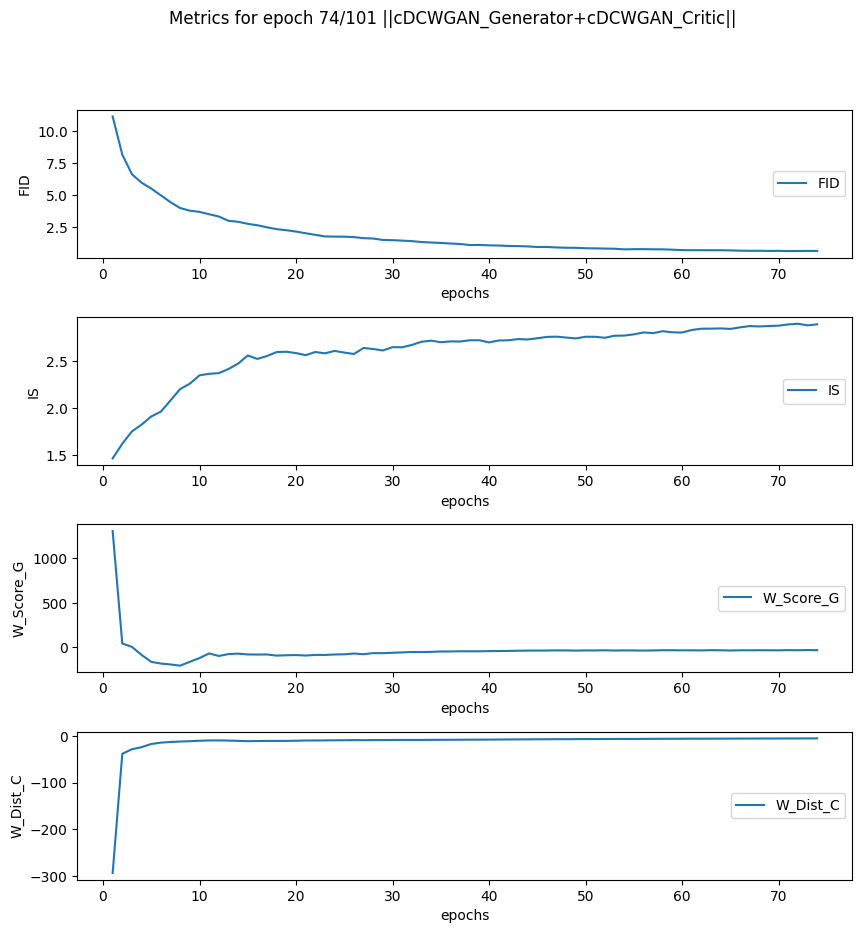

100%|██████████| 2853/2853 [07:49<00:00,  6.08it/s]


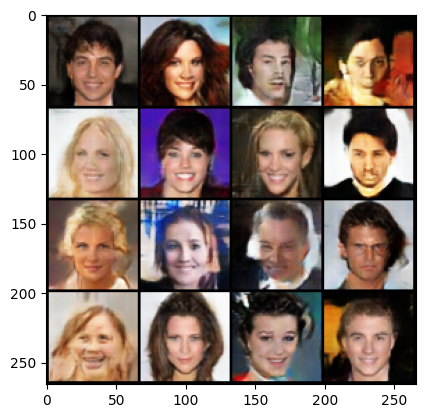

----------
Mean Generator Score: -32.93569826133419
Mean Critic distance: -5.394230846518012
Mean FID (64): 0.6360078454017639
Mean IS: 2.8820338249206543
Epoch Time: 7:49


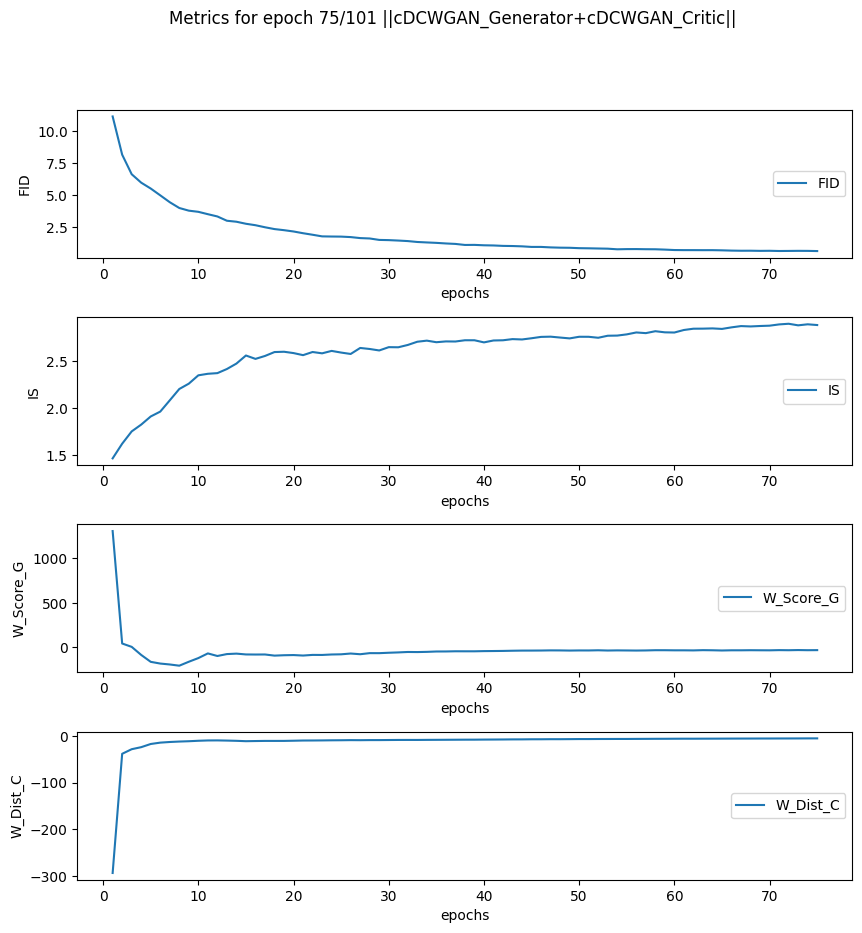

100%|██████████| 2853/2853 [07:49<00:00,  6.07it/s]


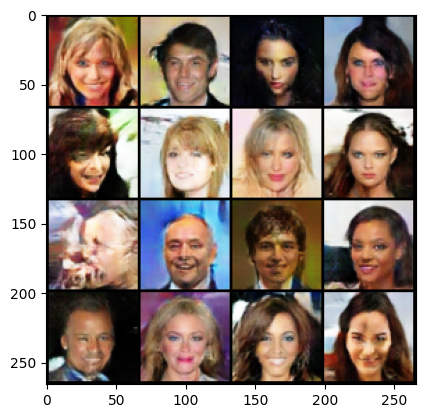

----------
Mean Generator Score: -33.163170161791015
Mean Critic distance: -5.379280927262305
Mean FID (64): 0.6351983547210693
Mean IS: 2.886014461517334
Epoch Time: 7:49


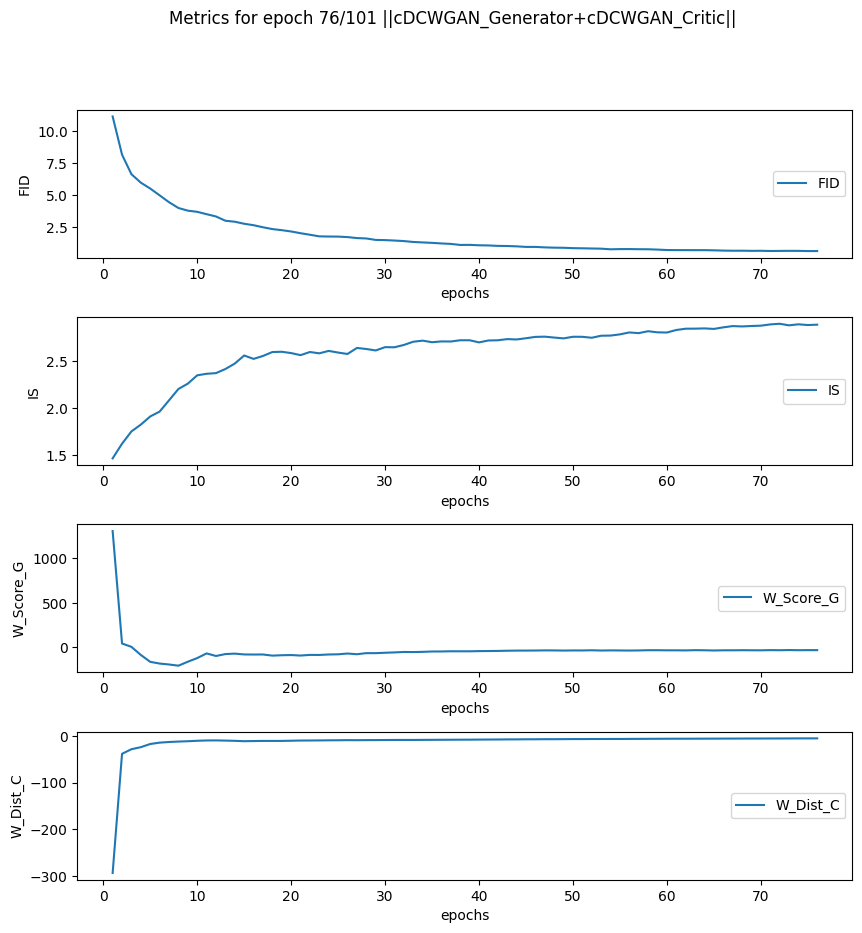

100%|██████████| 2853/2853 [07:49<00:00,  6.08it/s]


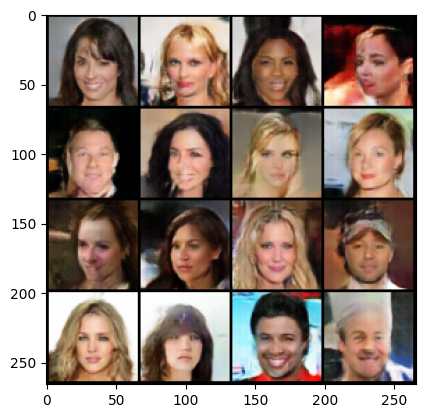

----------
Mean Generator Score: -32.85135255738309
Mean Critic distance: -5.412770200603016
Mean FID (64): 0.6285857558250427
Mean IS: 2.882979393005371
Epoch Time: 7:49


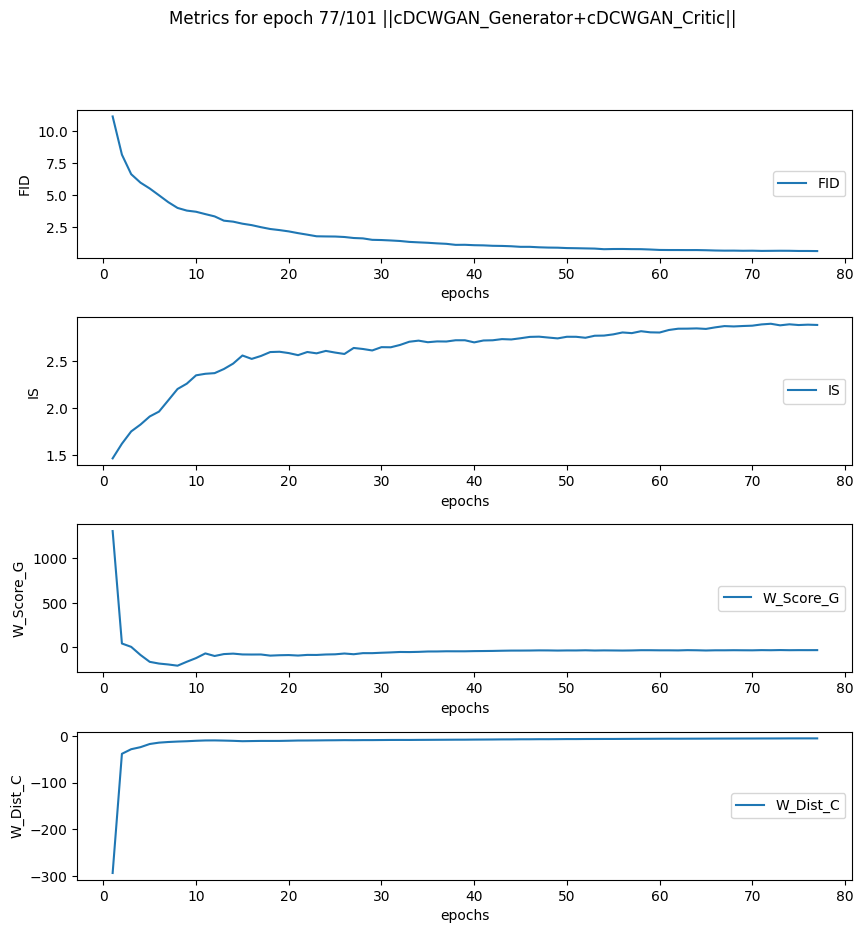

100%|██████████| 2853/2853 [07:49<00:00,  6.07it/s]


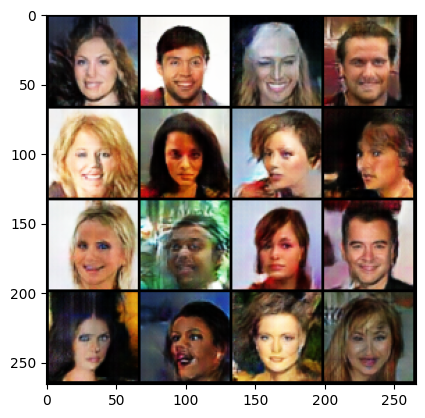

----------
Mean Generator Score: -33.87796741462591
Mean Critic distance: -5.308053674173071
Mean FID (64): 0.6147596836090088
Mean IS: 2.89951229095459
Epoch Time: 7:49


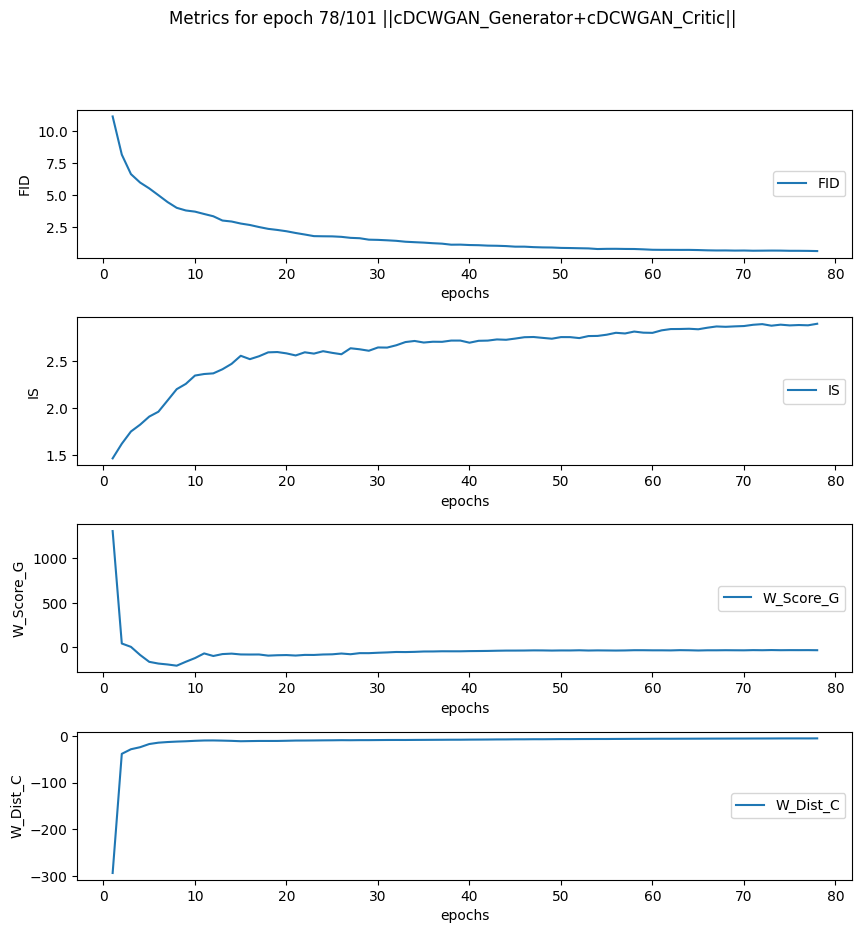

100%|██████████| 2853/2853 [07:49<00:00,  6.08it/s]


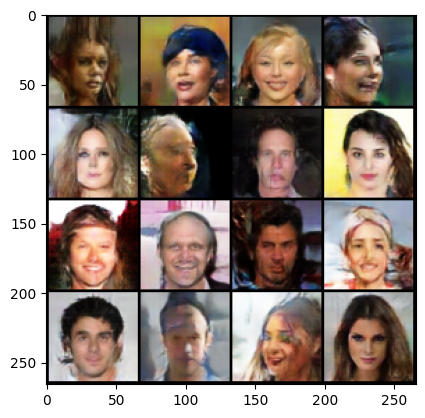

----------
Mean Generator Score: -35.48372841738818
Mean Critic distance: -5.229156705316142
Mean FID (64): 0.596993625164032
Mean IS: 2.899433135986328
Epoch Time: 7:49


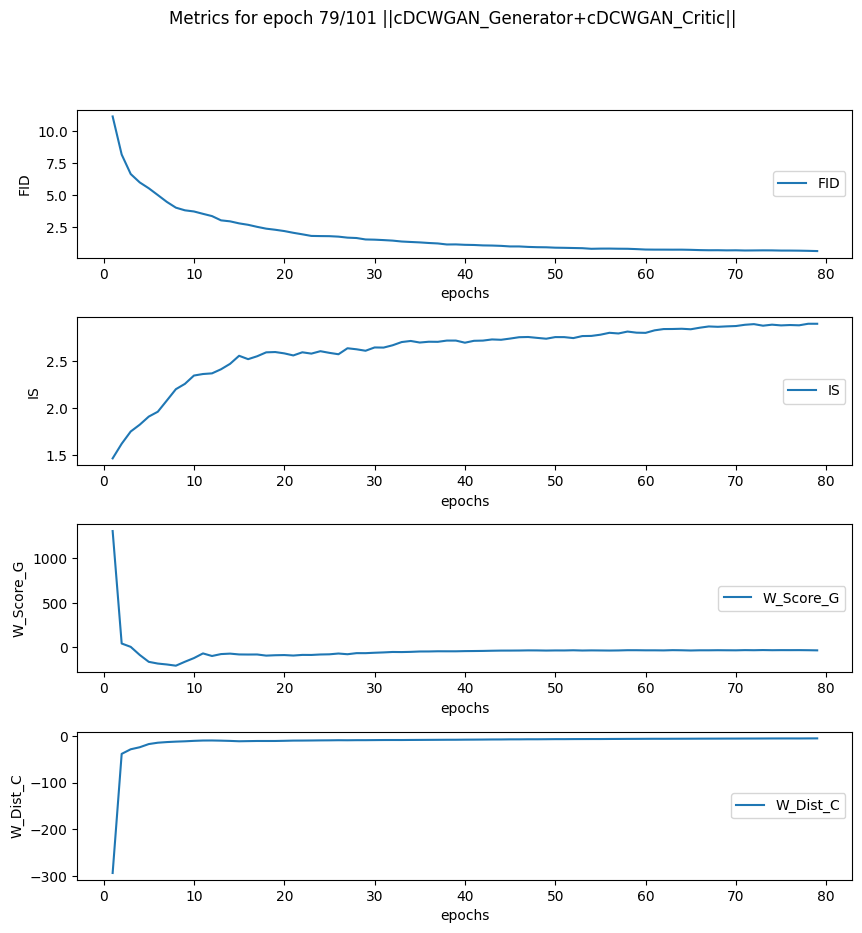

100%|██████████| 2853/2853 [07:56<00:00,  5.99it/s]


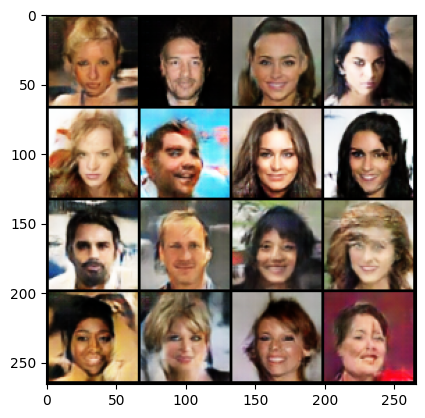

----------
Mean Generator Score: -33.74497557156965
Mean Critic distance: -5.24700818645131
Mean FID (64): 0.5968294739723206
Mean IS: 2.8892273902893066
Epoch Time: 7:56


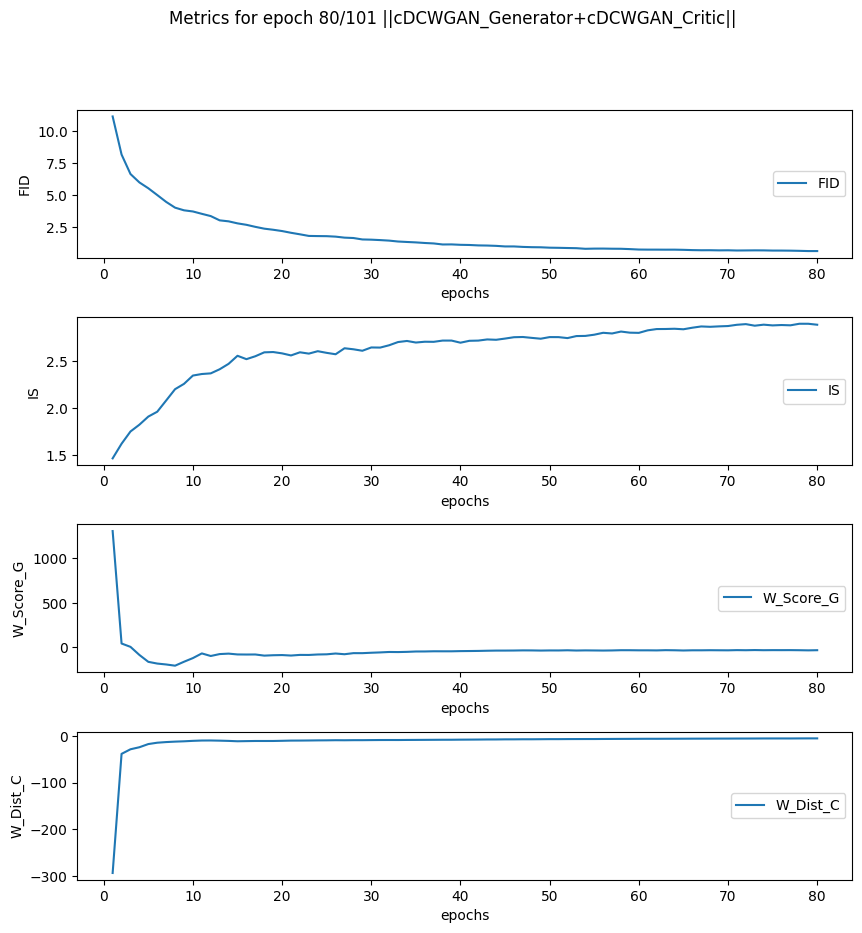

100%|██████████| 2853/2853 [07:50<00:00,  6.07it/s]


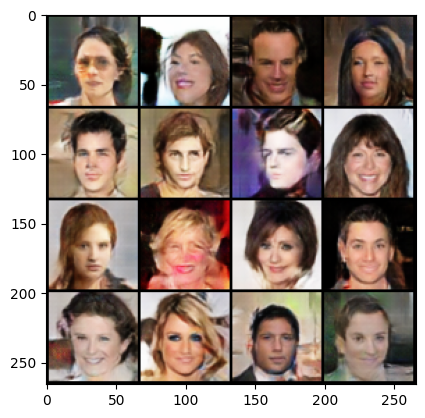

----------
Mean Generator Score: -32.90698604290945
Mean Critic distance: -5.180010267696254
Mean FID (64): 0.5782736539840698
Mean IS: 2.88478946685791
Epoch Time: 7:50


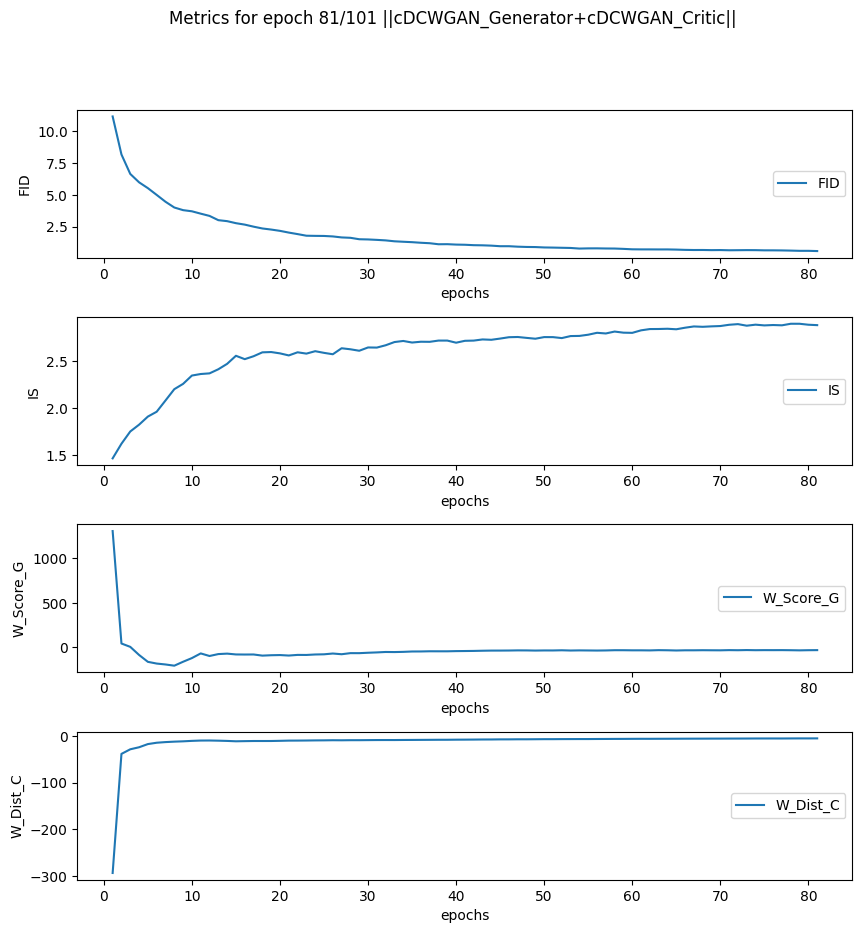

100%|██████████| 2853/2853 [07:49<00:00,  6.08it/s]


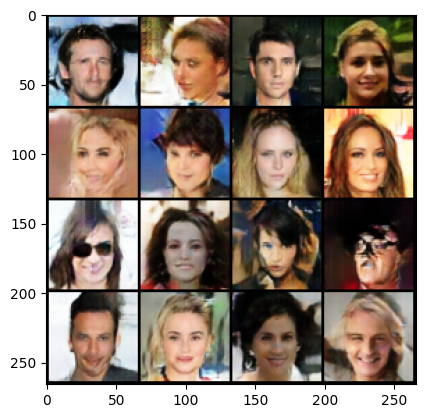

----------
Mean Generator Score: -33.60236327266484
Mean Critic distance: -5.133241866957794
Mean FID (64): 0.5587112307548523
Mean IS: 2.9011073112487793
Epoch Time: 7:49


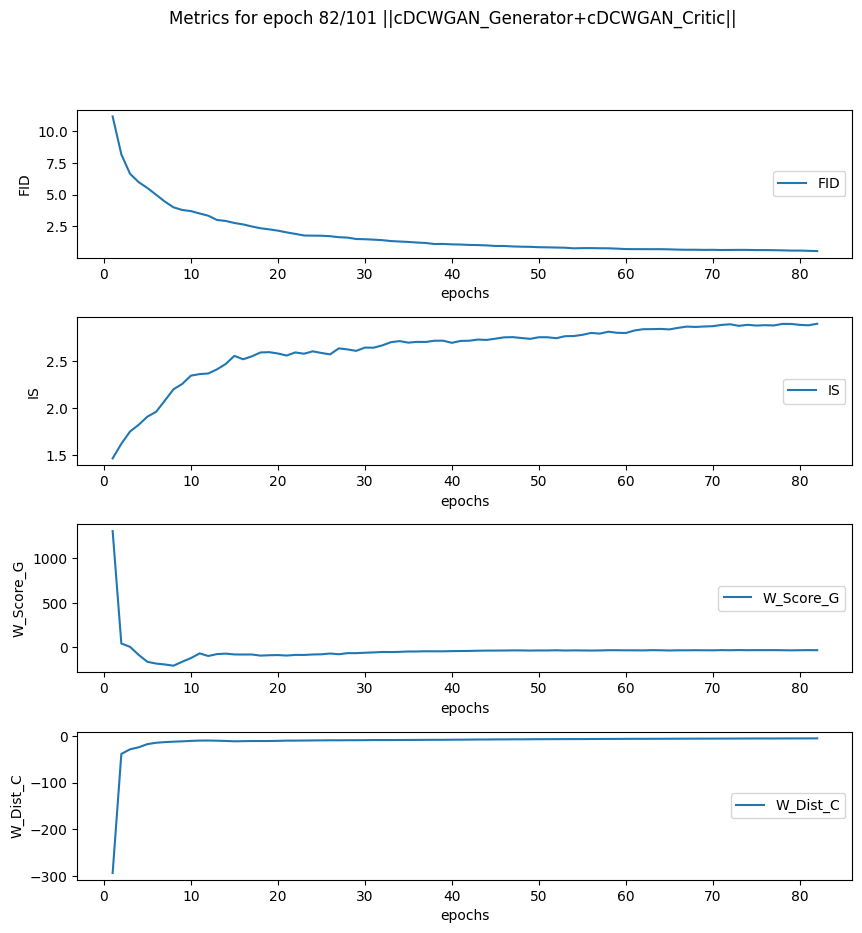

100%|██████████| 2853/2853 [07:49<00:00,  6.08it/s]


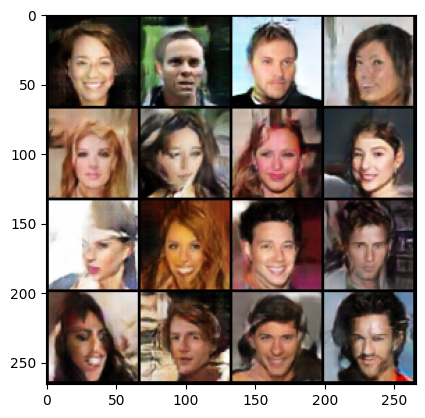

----------
Mean Generator Score: -34.87298566223237
Mean Critic distance: -5.158081159397798
Mean FID (64): 0.5562336444854736
Mean IS: 2.9019558429718018
Epoch Time: 7:49


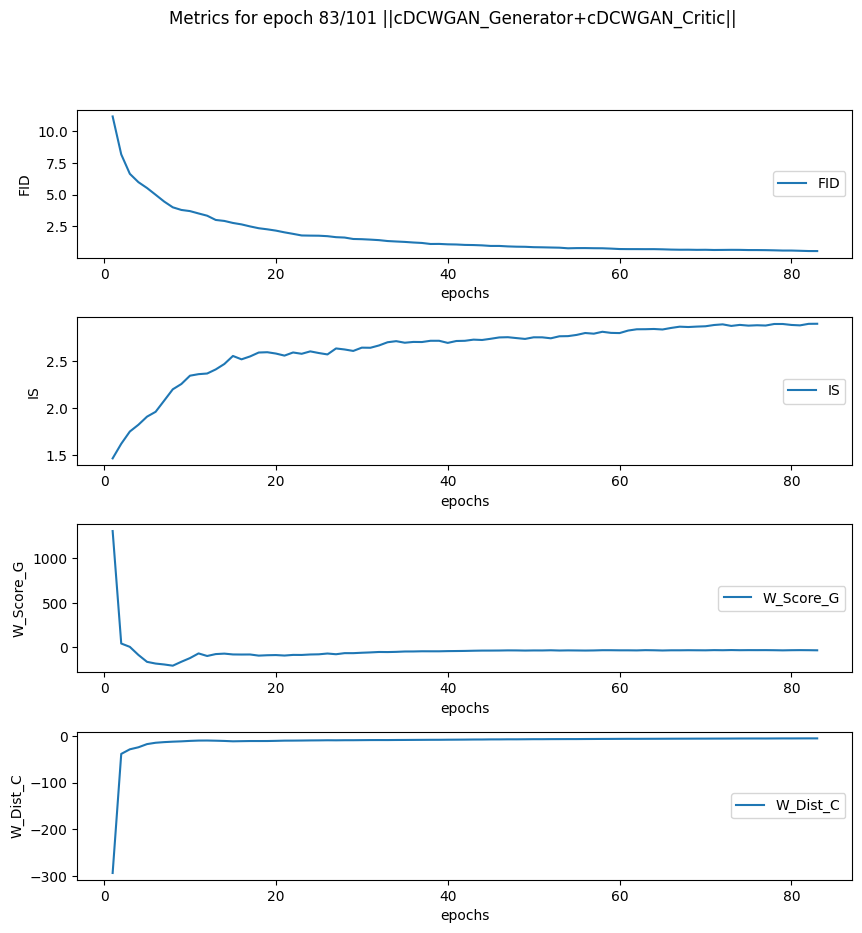

100%|██████████| 2853/2853 [07:50<00:00,  6.06it/s]


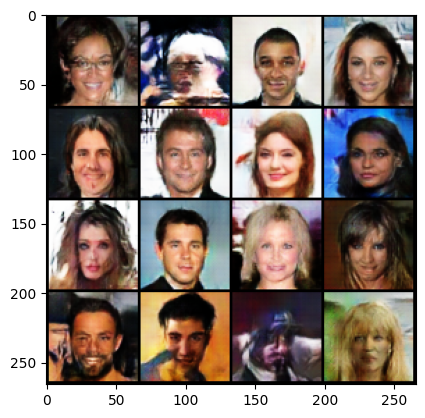

----------
Mean Generator Score: -32.16648214741757
Mean Critic distance: -5.118565256120111
Mean FID (64): 0.5626053810119629
Mean IS: 2.901657819747925
Epoch Time: 7:50


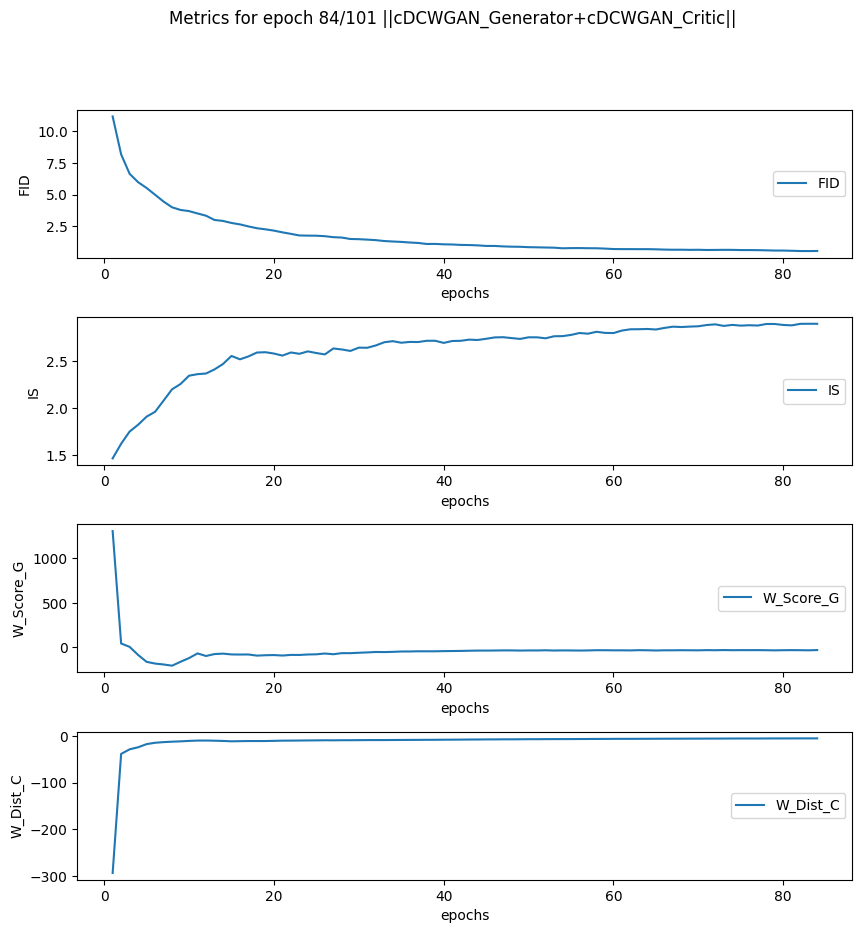

100%|██████████| 2853/2853 [07:50<00:00,  6.07it/s]


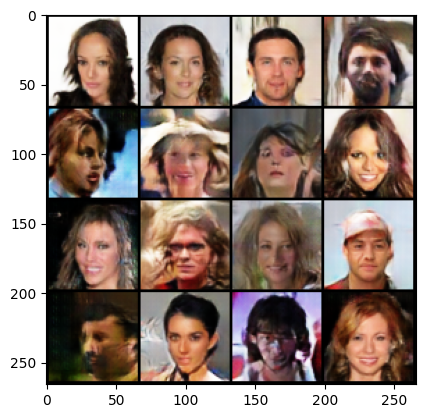

----------
Mean Generator Score: -33.85032353443012
Mean Critic distance: -5.08156039361322
Mean FID (64): 0.5561031103134155
Mean IS: 2.892225742340088
Epoch Time: 7:50


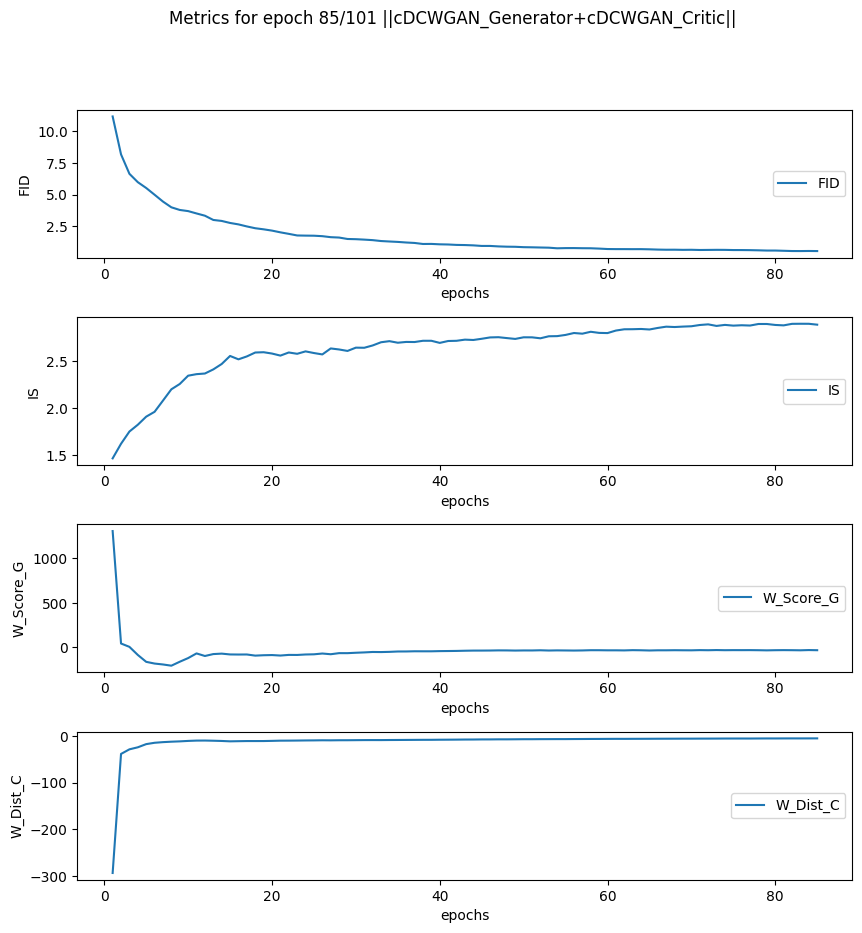

100%|██████████| 2853/2853 [07:49<00:00,  6.07it/s]


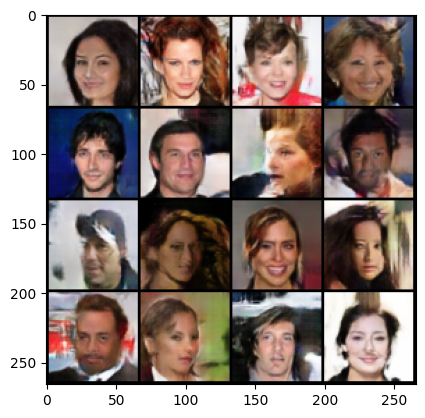

----------
Mean Generator Score: -34.38660879124675
Mean Critic distance: -5.096533254117996
Mean FID (64): 0.5463452935218811
Mean IS: 2.89872670173645
Epoch Time: 7:49


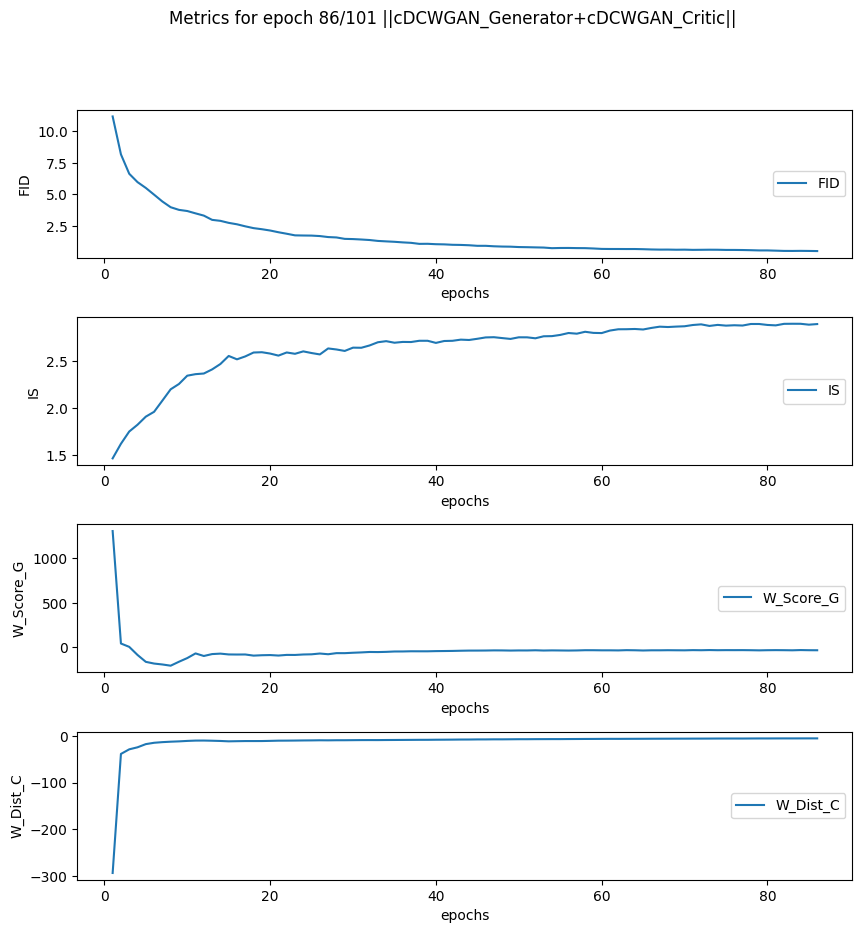

 60%|█████▉    | 1701/2853 [04:40<03:08,  6.11it/s]

In [ ]:
gan_metrics = train_GAN(Generator,
                        Critic,
                        100,
                        0.2,
                        optimizer_G, 
                        optimizer_C, 
                        dataloaders,
                        device,
                        n_epochs=100, 
                        n_critic=5, 
                        prev_metrics=None, 
                        save_every=5, 
                        fig_dir=fig_dir, 
                        w_dir=w_dir)